### Load libraries

In [494]:
library(plyr)
library(tidyverse)
library(stringr)
library(phyloseq)
library(microViz)
library(metagMisc)
library(phylosignal)
library(ggplot2)
library(ggsci)
library(viridis)
library(conflicted)
library(gridExtra)
library(vegan)
library(ape)
library(lattice)
library(permute)
library(grid) 
library(knitr)

In [495]:
opts_chunk$set(cache=FALSE,warning=FALSE)

### Setup for plot labels

In [2]:
options(repr.matrix.max.rows = 30, repr.matrix.max.cols = 20)

### Setup labels

In [3]:
#Setup for label sizes in plots
labels.x=theme(axis.title.x = element_text(size=18),
               axis.text.x = element_text(size=18,vjust=1,hjust=1,angle=45))

labels.x.pca=theme(axis.title.x = element_text(size=18),
               axis.text.x = element_text(size=18)) 

labels.y=theme(axis.title.y = element_text(size=18),
               axis.text.y= element_text(size=18))

labels.legend=theme(legend.text = element_text (size=18),
                    legend.title = element_text(size=18))

### Declare conflict preferences

In [4]:
conflict_prefer("filter","dplyr")
conflict_prefer("rename","dplyr")
conflict_prefer("mutate","dplyr")
conflict_prefer("count","dplyr")

[conflicted] Will prefer dplyr::filter over any other package
[conflicted] Will prefer dplyr::rename over any other package
[conflicted] Will prefer dplyr::mutate over any other package
[conflicted] Will prefer dplyr::count over any other package


### Import objects

In [5]:
otuAllSamples = read_tsv("/ebio/abt3_projects2/Flagellin_Diversity/code/notebooks/shortbred/matrixAll.tsv",col_names=T,show_col_types = FALSE) %>%
  rename(Accession="Family")
otuAllSamples_count=read_tsv("/ebio/abt3_projects2/Flagellin_Diversity/code/notebooks/shortbred/matrixAll_count.tsv",col_names=T,show_col_types=FALSE)%>%
rename(Accession="Family")
tax.markers=read_tsv("tax.markers.fla.tsv",col_names=T,show_col_types=FALSE)
all.tre=read_tree("/ebio/abt3_projects/small_projects/aborbon/Thesis_FlagellinDiversity/1_shortbred/fasttree_trimal_mafft_alignment_fla_sb.tre")

In [6]:
mappingAll=read_tsv("/tmp/global2/aborbon/metadataAllSamples.tsv",col_names=T,show_col_types = FALSE) %>%
mutate(category=if_else(biome_1=="Environmental","Environmental",
                if_else(biome_2=="Plants","Plants","Animal"))) %>%
mutate(mammals=if_else(biome_2=="Mammalia","Mammalia","Others"))

In [479]:
write_tsv(mappingAll,"edgeR/mappingMetadataAll.txt")

## 1. Create phyloseq objects

In [7]:
#Create otu table from feature table - abundances
otus_AllSamples=otu_table(otuAllSamples[,2:ncol(otuAllSamples)],taxa_are_rows = TRUE)
rownames(otus_AllSamples)=otuAllSamples$Accession

In [8]:
#Create otu table from feature table - counts
otus_AllSamples_count=otu_table(otuAllSamples_count[,2:ncol(otuAllSamples_count)],taxa_are_rows = TRUE)
rownames(otus_AllSamples_count)=otuAllSamples_count$Accession

In [9]:
#Create sample data for phyloseq
mapping_ps_All=sample_data(mappingAll)
rownames(mapping_ps_All)=mappingAll$Sample

In [10]:
#Checking sample names in the mapping file
#sample_names(mapping_ps_All)

#taxonomy table
flags.tax=tax_table(as.matrix(tax.markers[,2:ncol(tax.markers)]))
rownames(flags.tax)=tax.markers$Accession

In [11]:
#Phylogeny of flagellins
flag.phy=phy_tree(all.tre)

In [496]:
#Creating phyloseq object + remove mislabeled sample
psAll=phyloseq(otus_AllSamples,mapping_ps_All,flags.tax,flag.phy)
psAll

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9963 taxa and 809 samples ]
sample_data() Sample Data:       [ 809 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9963 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9963 tips and 9945 internal nodes ]

In [13]:
#Creating phyloseq object - counts
psAll_count=phyloseq(otus_AllSamples_count,mapping_ps_All,flags.tax,flag.phy)
psAll_count

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9963 taxa and 809 samples ]
sample_data() Sample Data:       [ 809 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9963 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9963 tips and 9945 internal nodes ]

In [14]:
to.remove=select(filter(as_tibble(psAll@sam_data),family=="Solanaceae"),Sample)
to.remove

Sample
<chr>
SRR10527383
SRR10527384
SRR10527386
SRR10527387
SRR10527389
SRR10527390
SRR10527391
SRR10527392
SRR10527393


In [15]:
psAll = subset_samples(psAll,!(Sample %in% to.remove$Sample))
psAll_count = subset_samples(psAll_count,!(Sample %in% to.remove$Sample))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [16]:
psAll
psAll_count

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9963 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9963 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9963 tips and 9945 internal nodes ]

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9963 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9963 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9963 tips and 9945 internal nodes ]

## 2. Filter low-abundance and low-prevalence observations

In [506]:
#Filter based on prevalence
#Prevalence threshold=0.05

filter_taxa_All = phyloseq_filter_prevalence(psAll, prev.trh = 0.05, abund.trh = NULL,
  threshold_condition = "OR", abund.type = "mean")
filter_taxa_All=prune_samples(sample_sums(filter_taxa_All)>0,filter_taxa_All)

#keep filtered taxa in the count table
keepFeatures=rownames(otu_table(filter_taxa_All))
filter_taxa_All_count = prune_taxa(keepFeatures, psAll_count)


Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [509]:
filter_taxa_All

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 943 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 943 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 943 tips and 942 internal nodes ]

In [510]:
keepFeatures=rownames(otu_table(filter_taxa_All))
length(keepFeatures)

[1] 943

In [511]:
count(as_tibble(filter_taxa_All@sam_data),category)

category,n
<chr>,<int>
Animal,555
Environmental,133
Plants,104


In [436]:
write.tree(filter_taxa_All@phy_tree,"edgeR/filterTaxa_All.tre")
write_tsv(filter_taxa_All)

In [420]:
# Flagellins in plants
flas.plants = ps_filter(filter_taxa_All_count,category=="Plants")
flas.present.plants = phyloseq_filter_prevalence(flas.plants, abund.trh = 1,
  threshold_condition = "OR", abund.type = "total")
write.tree(flas.present.plants@phy_tree,"edgeR/flags.tre_Plants.tre")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [421]:
flas.animals = ps_filter(filter_taxa_All_count,category=="Animal")
flas.present.animals = phyloseq_filter_prevalence(flas.animals, abund.trh = 1,
  threshold_condition = "OR", abund.type = "total")
write.tree(flas.present.animals@phy_tree,"edgeR/flags.tre_Animals.tre")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [422]:
flas.env = ps_filter(filter_taxa_All_count,category=="Environmental")
flas.present.env = phyloseq_filter_prevalence(flas.env, abund.trh = 1,
  threshold_condition = "OR", abund.type = "total")
write.tree(flas.present.env@phy_tree,"edgeR/flags.tre_Env.tre")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



## 3. Final phyloseq object
Taxa filtered by prevalence

## 3A. Environmental vs. Host-associated samples

### 3.1. Composition plots

In [512]:
filter_taxa_All

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 943 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 943 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 943 tips and 942 internal nodes ]

In [513]:
filter_taxa_All_count

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 943 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 943 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 943 tips and 942 internal nodes ]

In [489]:
dplyr::count(as_tibble(filter_taxa_All_count@sam_data),biome_2)

biome_2,n
<chr>,<int>
Actinopterygii,53
Amphibia,11
Aquatic,102
Aves,100
Mammalia,394
Plants,87
Reptilia,14
Terrestrial,31


In [24]:
top.100=phyloseq_filter_top_taxa(filter_taxa_All_count,n=100)
top.30=phyloseq_filter_top_taxa(filter_taxa_All_count,n=30)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [25]:
top.100.barplot=plot_bar(transform_sample_counts(top.100, function(x) (1E6 * x / sum(x))),
fill="Phylum")+
                         geom_bar(position="stack",stat="identity")+
                         facet_wrap(~biome_1,scales="free")+
                         theme_minimal()+
                         labels.legend+
                         theme(axis.text.x = element_blank())+
                         scale_fill_npg()+
                         ggtitle("Top 100 taxa")

top.30.barplot=plot_bar(transform_sample_counts(top.30, function(x) (1E6 * x / sum(x))),
fill="Phylum")+
                         geom_bar(position="stack",stat="identity")+
                         facet_wrap(~biome_1,scales="free")+
                         theme_minimal()+
                         labels.legend+
                         theme(axis.text.x = element_blank())+
                         scale_fill_npg()+
                         ggtitle("Top 30 taxa")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" 

Warning message:
“Removed 2700 rows containing missing values (`position_stack()`).”
Warning message:
“Removed 2700 rows containing missing values (`position_stack()`).”
Warning message:
“Removed 900 rows containing missing values (`position_stack()`).”
Warning message:
“Removed 900 rows containing missing values (`position_stack()`).”


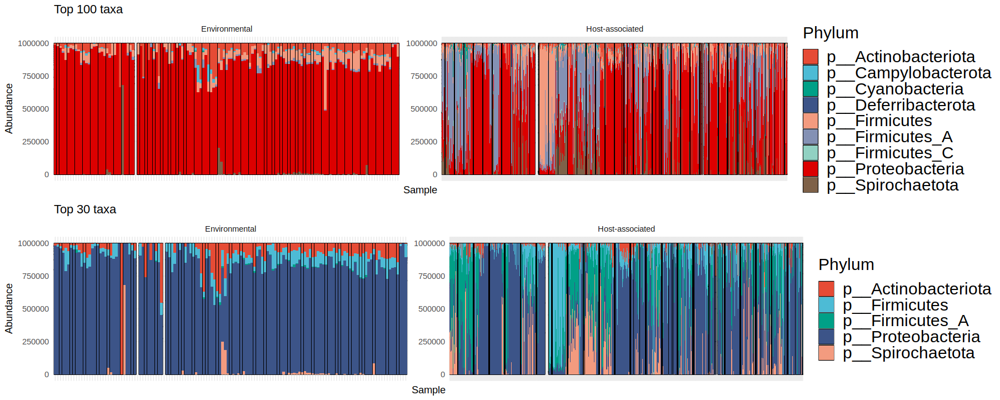

In [26]:
options(repr.plot.width=15,repr.plot.height=6)
grid.arrange(top.100.barplot,
             top.30.barplot,
             nrow=2)

### 3.2. Richness estimates

In [533]:
richness.estimates=mutate(as_tibble(filter_taxa_All_count@sam_data),estimate_richness(filter_taxa_All_count, split = TRUE, measures = c("Observed", "Chao1","Shannon", "Simpson")))

In [534]:
head(richness.estimates)

Sample,Dataset,biome_0,biome_1,biome_2,biome_3,biome_4,family,category,mammals,Observed,Chao1,se.chao1,Shannon,Simpson
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ERS1030529,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,84,122.0769,14.94900,3.281599,0.8628260
ERS1030531,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,82,163.0588,30.82290,3.248610,0.8747264
ERS1030532,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,74,168.2308,38.06770,2.961301,0.8216112
ERS1030533,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,60,130.9091,31.64993,3.400632,0.9151260
ERS1030534,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,106,197.6364,31.44851,3.834501,0.9533203
ERS1030535,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,96,253.9286,57.64684,3.615593,0.9370897


### Statistics on richness estimates

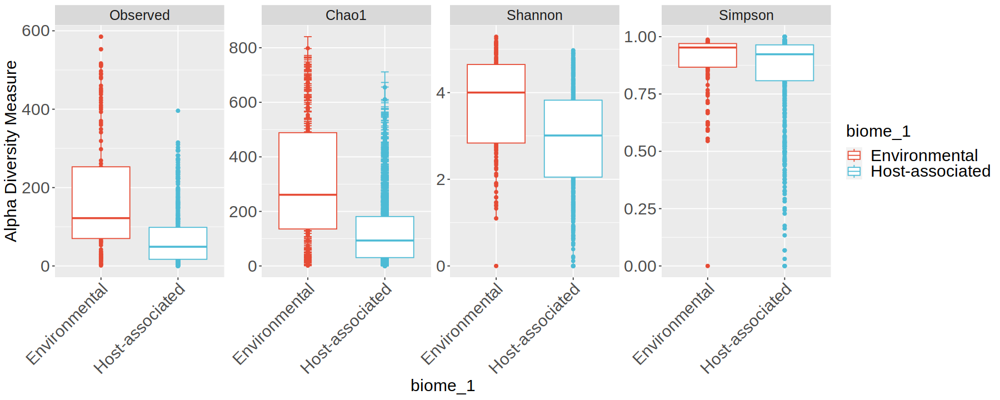

In [29]:
options(repr.plot.width=15,repr.plot.height=6)
plot_richness(filter_taxa_All_count,x="biome_1",measures=c("Observed","Chao1","Shannon","Simpson"),color="biome_1")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

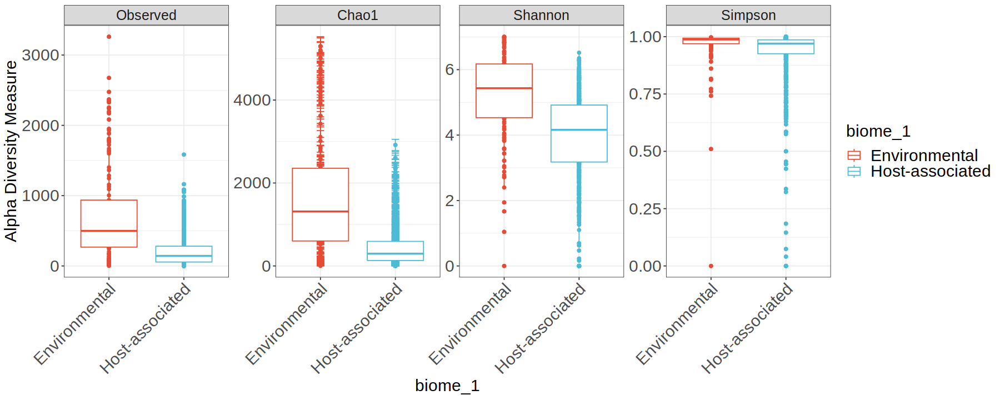

In [439]:

options(repr.plot.width=15,repr.plot.height=6)
plot_richness(psAll_count,x="biome_1",measures=c("Observed","Chao1","Shannon","Simpson"),color="biome_1")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

#### I. Kruskal tests by biome_1

In [30]:
kruskal.test(Observed~biome_1,data=richness.estimates)


	Kruskal-Wallis rank sum test

data:  Observed by biome_1
Kruskal-Wallis chi-squared = 74.122, df = 1, p-value < 2.2e-16


In [31]:
kruskal.test(Chao1~biome_1,data=richness.estimates)


	Kruskal-Wallis rank sum test

data:  Chao1 by biome_1
Kruskal-Wallis chi-squared = 83.223, df = 1, p-value < 2.2e-16


In [32]:
kruskal.test(Shannon~biome_1,data=richness.estimates)


	Kruskal-Wallis rank sum test

data:  Shannon by biome_1
Kruskal-Wallis chi-squared = 52.421, df = 1, p-value = 4.48e-13


In [33]:
kruskal.test(Simpson~biome_1,data=richness.estimates)


	Kruskal-Wallis rank sum test

data:  Simpson by biome_1
Kruskal-Wallis chi-squared = 10.172, df = 1, p-value = 0.001426


#### II. Kruskal tests by category

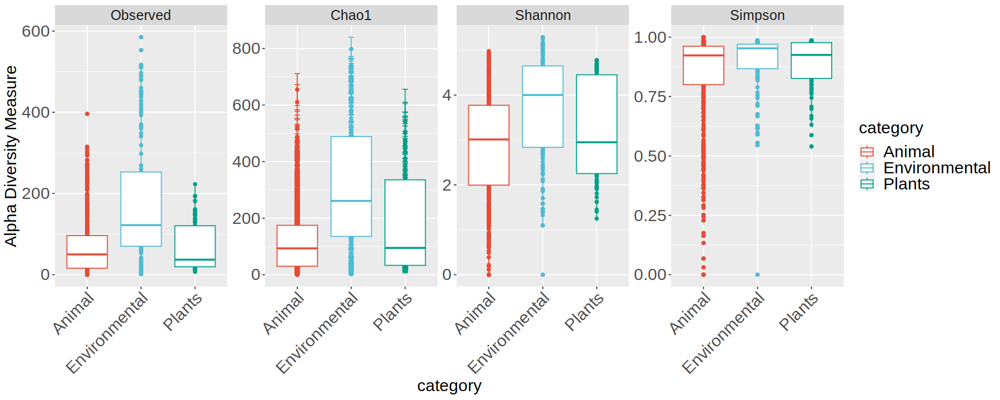

In [34]:
options(repr.plot.width=15,repr.plot.height=6)
plot_richness(filter_taxa_All_count,x="category",measures=c("Observed","Chao1","Shannon","Simpson"),color="category")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

In [35]:
kruskal.test(Observed~category,data=richness.estimates)


	Kruskal-Wallis rank sum test

data:  Observed by category
Kruskal-Wallis chi-squared = 74.14, df = 2, p-value < 2.2e-16


In [36]:
kruskal.test(Chao1~category,data=richness.estimates)


	Kruskal-Wallis rank sum test

data:  Chao1 by category
Kruskal-Wallis chi-squared = 86.317, df = 2, p-value < 2.2e-16


In [37]:
kruskal.test(Shannon~category,data=richness.estimates)


	Kruskal-Wallis rank sum test

data:  Shannon by category
Kruskal-Wallis chi-squared = 56.842, df = 2, p-value = 4.538e-13


In [38]:
kruskal.test(Simpson~category,data=richness.estimates)


	Kruskal-Wallis rank sum test

data:  Simpson by category
Kruskal-Wallis chi-squared = 13.769, df = 2, p-value = 0.001023


#### III. Wilcoxon tests by category

In [39]:
pairwise.wilcox.test(richness.estimates$Observed, richness.estimates$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates$Observed and richness.estimates$category 

              Animal  Environmental
Environmental < 2e-16 -            
Plants        0.88    6.1e-09      

P value adjustment method: fdr 

In [40]:
pairwise.wilcox.test(richness.estimates$Chao1, richness.estimates$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates$Chao1 and richness.estimates$category 

              Animal  Environmental
Environmental < 2e-16 -            
Plants        0.089   2.5e-06      

P value adjustment method: fdr 

In [41]:
pairwise.wilcox.test(richness.estimates$Shannon, richness.estimates$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates$Shannon and richness.estimates$category 

              Animal  Environmental
Environmental 2.6e-13 -            
Plants        0.03326 0.00056      

P value adjustment method: fdr 

In [42]:
pairwise.wilcox.test(richness.estimates$Simpson, richness.estimates$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates$Simpson and richness.estimates$category 

              Animal Environmental
Environmental 0.0012 -            
Plants        0.1100 0.6570       

P value adjustment method: fdr 

### 3.3. Beta diversity

### I. Ordination matrices

Add alpha diversity measures to samples data. Then include it to the phyloseq object

In [532]:
head(filter_taxa_All@otu_table)

,ERS1030529,ERS1030531,ERS1030532,ERS1030533,ERS1030534,ERS1030535,ERS1030536,ERS1030537,ERS1030538,ERS1030539,⋯,36UNCULTURED_S10,400UNCULTURED_S11,40UNCULTURED_S15,4UNCULTURED_S2,500UNCULTURED_S13,8UNCULTURED_S5,lucaAR31_S16,lucaAR32_S17,lucaAR33_S18,lucaAR34_S19
WP_018305791.1,0,0,0,0,0,0,0,0,0,0,⋯,0.03359858,0,0,0.09702635,0,0,0.06285513,0,0.00000000,0.139486
KJS48310.1,0,0,0,0,0,0,0,0,0,0,⋯,0.00000000,0,0,0.00000000,0,0,0.00000000,0,0.04943577,0.000000
OBW58796.1,0,0,0,0,0,0,0,0,0,0,⋯,0.00000000,0,0,0.00000000,0,0,0.00000000,0,0.00000000,0.000000
ESU34160.1,0,0,0,0,0,0,0,0,0,0,⋯,0.00000000,0,0,0.00000000,0,0,0.00000000,0,0.00000000,0.000000
WP_087615600.1,0,0,0,0,0,0,0,0,0,0,⋯,0.00000000,0,0,0.00000000,0,0,0.00000000,0,0.00000000,0.000000
WP_039042127.1,0,0,0,0,0,0,0,0,0,0,⋯,0.00000000,0,0,0.00000000,0,0,0.00000000,0,0.00000000,0.000000


In [539]:
#tmp mapping table with richness estimates
mapping_ps_All_richness=sample_data(richness.estimates)
rownames(mapping_ps_All_richness)=richness.estimates$Sample

filter_taxa_All=phyloseq(filter_taxa_All_count@otu_table,mapping_ps_All_richness,filter_taxa_All@tax_table,filter_taxa_All@phy_tree)
filter_taxa_All

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 943 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 15 sample variables ]
tax_table()   Taxonomy Table:    [ 943 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 943 tips and 942 internal nodes ]

In [540]:
head(filter_taxa_All@sam_data)

,Sample,Dataset,biome_0,biome_1,biome_2,biome_3,biome_4,family,category,mammals,Observed,Chao1,se.chao1,Shannon,Simpson
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ERS1030529,ERS1030529,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,84,122.0769,14.94900,3.281599,0.8628260
ERS1030531,ERS1030531,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,82,163.0588,30.82290,3.248610,0.8747264
ERS1030532,ERS1030532,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,74,168.2308,38.06770,2.961301,0.8216112
ERS1030533,ERS1030533,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,60,130.9091,31.64993,3.400632,0.9151260
ERS1030534,ERS1030534,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,106,197.6364,31.44851,3.834501,0.9533203
ERS1030535,ERS1030535,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,96,253.9286,57.64684,3.615593,0.9370897


In [519]:
unifrac.dist.filt = ordinate(filter_taxa_All,distance="unifrac",method="PCoA")
wunifrac.dist.filt = ordinate(filter_taxa_All,distance="wunifrac",method="PCoA")
jaccard.dist.filt = ordinate(filter_taxa_All,distance="unifrac",method="PCoA")
jaccard.dist.filt = ordinate(filter_taxa_All,distance="bray",method="PCoA")

### II. Ordination plots

In [44]:
unifrac.biome1.filt=plot_ordination(physeq = filter_taxa_All,unifrac.dist.filt,type="samples",color="biome_1")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_viridis()+
  theme(legend.position = "top")+
  ggtitle("uUnifrac")+labels.x + labels.y + labels.legend

In [45]:
unifrac.biome2.filt=plot_ordination(physeq = filter_taxa_All,unifrac.dist.filt,type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUnifrac")+labels.x + labels.y + labels.legend

In [46]:
unifrac.mammals.filt=plot_ordination(physeq = filter_taxa_All,unifrac.dist.filt,type="samples",color="mammals")+#,shapes="family")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUnifrac")+labels.x + labels.y + labels.legend

In [47]:
unifrac.category.filt=plot_ordination(physeq = filter_taxa_All,unifrac.dist.filt,type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUnifrac")+labels.x + labels.y + labels.legend

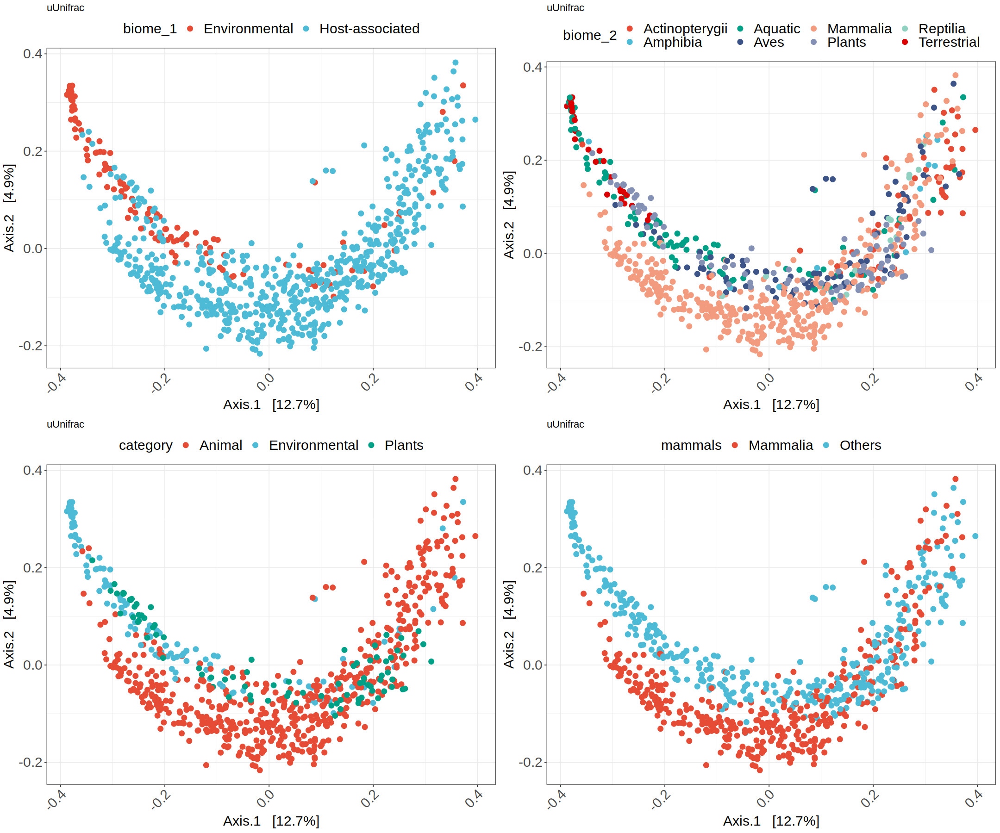

In [48]:
options(repr.plot.width=18,repr.plot.height=15)
grid.arrange(unifrac.biome1.filt,
             unifrac.biome2.filt,
             unifrac.category.filt,
             unifrac.mammals.filt,
             nrow=2)

Color ordination by alpha diversity

In [546]:
unifrac.shannon.filt=plot_ordination(physeq = filter_taxa_All,unifrac.dist.filt,type="samples",color="Shannon")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_viridis()+
  theme(legend.position = "top")+
  ggtitle("uUnifrac")+labels.x + labels.y + labels.legend

In [547]:
unifrac.chao.filt=plot_ordination(physeq = filter_taxa_All,unifrac.dist.filt,type="samples",color="Chao1")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_viridis()+
  theme(legend.position = "top")+
  ggtitle("uUnifrac")+labels.x + labels.y + labels.legend

In [548]:
unifrac.simpson.filt=plot_ordination(physeq = filter_taxa_All,unifrac.dist.filt,type="samples",color="Simpson")+#,shapes="family")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_viridis()+
  theme(legend.position = "top")+
  ggtitle("uUnifrac")+labels.x + labels.y + labels.legend

In [549]:
unifrac.obs.filt=plot_ordination(physeq = filter_taxa_All,unifrac.dist.filt,type="samples",color="Observed")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_viridis()+
  theme(legend.position = "top")+
  ggtitle("uUnifrac")+labels.x + labels.y + labels.legend

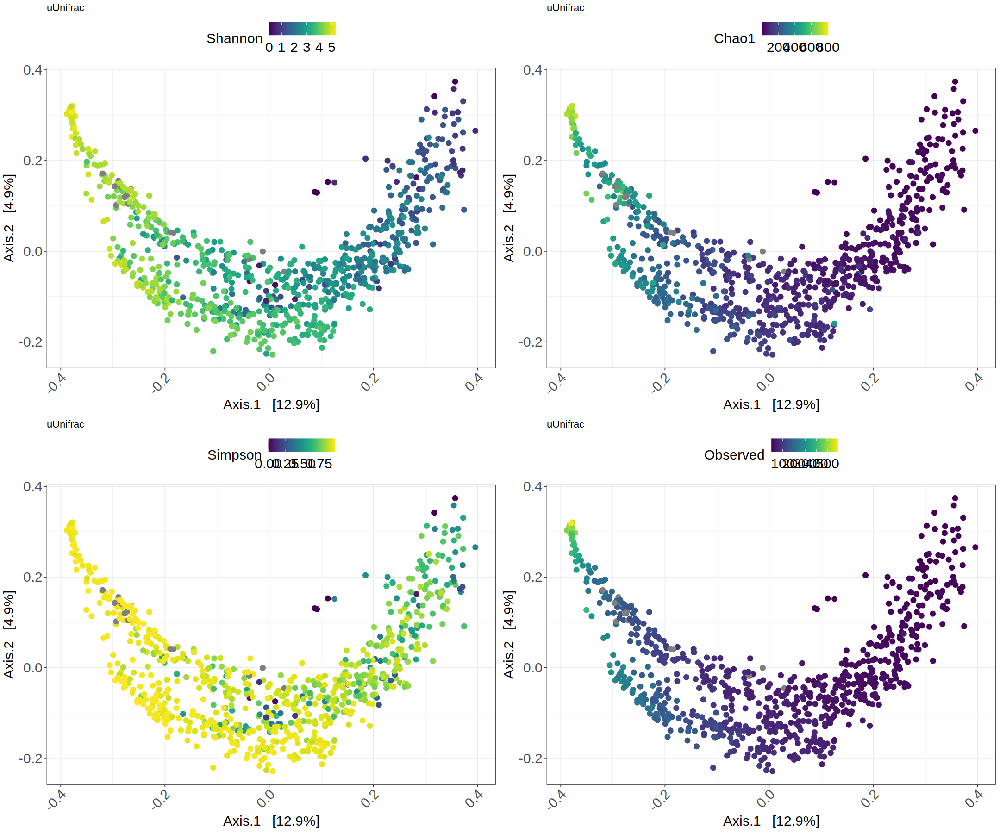

In [550]:
options(repr.plot.width=18,repr.plot.height=15)
grid.arrange(unifrac.shannon.filt,
             unifrac.chao.filt,
             unifrac.simpson.filt,
             unifrac.obs.filt,
             nrow=2)

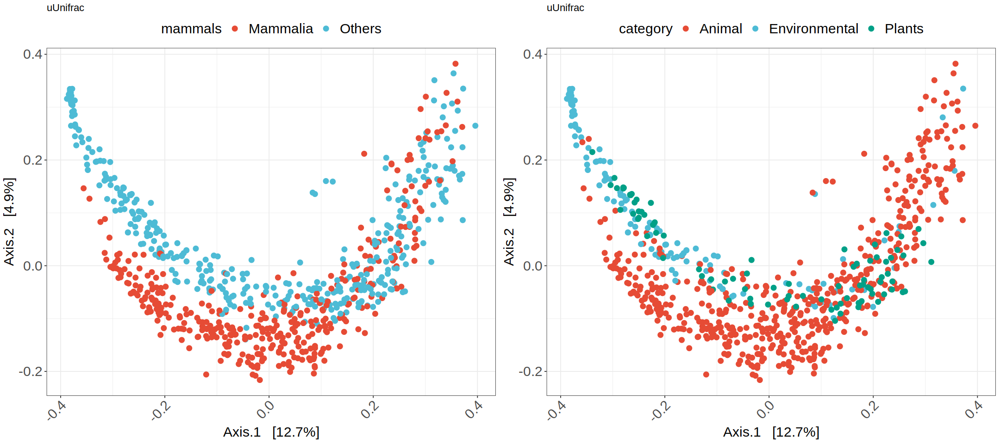

In [492]:
options(repr.plot.width=18,repr.plot.height=8)
grid.arrange(unifrac.mammals.filt,unifrac.category.filt,nrow=1)

### III. Pairwise dissimilarities

#### By biome_1

In [50]:
diss.jacc1=phyloseq_group_dissimilarity(filter_taxa_All,group="biome_1",method="jaccard",between_groups = TRUE)+ggtitle("Jaccard")+labels.x + labels.y + labels.legend+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))+theme(legend.position = "none")

diss.unifrac1=phyloseq_group_dissimilarity(filter_taxa_All,group="biome_1",method="unifrac",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))+theme(legend.position = "none")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



#### By category

In [51]:
diss.jaccard.cat=phyloseq_group_dissimilarity(filter_taxa_All,group="category",method="jaccard",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))+theme(legend.position = "none")

diss.unifrac.cat=phyloseq_group_dissimilarity(filter_taxa_All,group="category",method="unifrac",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))+theme(legend.position = "none")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



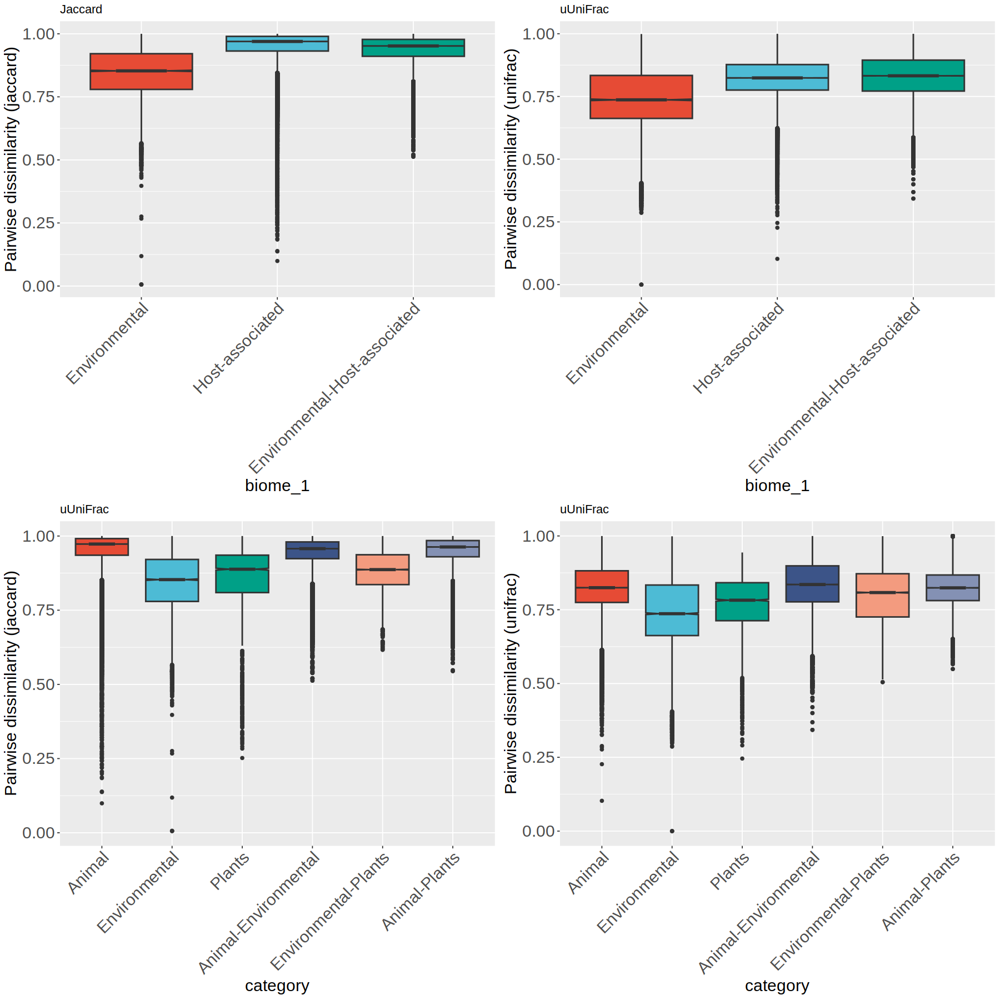

In [52]:
options(repr.plot.width=15,repr.plot.height=15)
grid.arrange(diss.jacc1,
             diss.unifrac1,
             diss.jaccard.cat,
             diss.unifrac.cat,
             nrow=2)

### IV. OTU tree

In [53]:
otu.tre=plot_tree(filter_taxa_All,color="category",label.tips="taxa_names")+scale_color_npg()

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



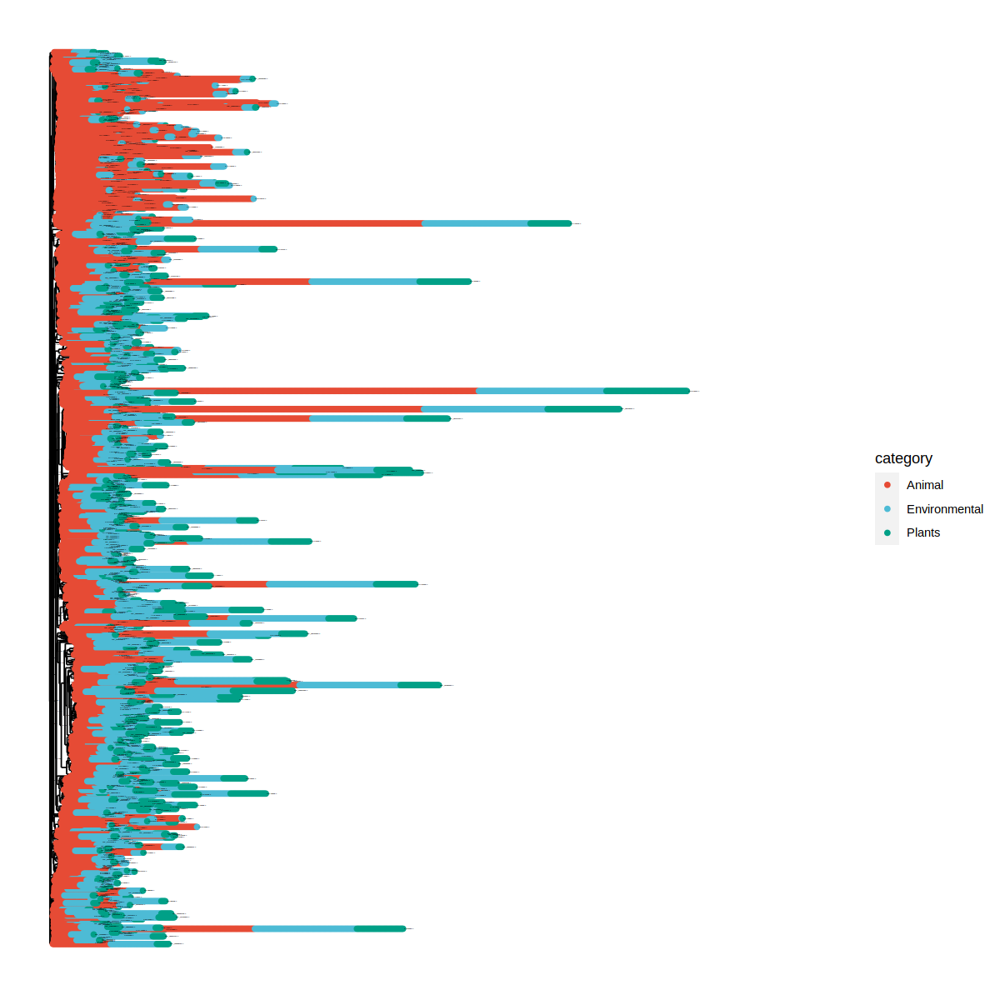

In [54]:
options(repr.plot.width=10,repr.plot.height=10)
otu.tre

In [55]:
tre.top.0.1=plot_tree(phyloseq_filter_top_taxa(psAll_count,perc=0.1),color="category",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 0.1%")

tre.top.1=plot_tree(phyloseq_filter_top_taxa(psAll_count,perc=1),color="category",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 1%")

tre.top.5=plot_tree(phyloseq_filter_top_taxa(psAll_count,perc=5),color="category",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 5%")

tre.top.10=plot_tree(phyloseq_filter_top_taxa(psAll_count,perc=10),color="category",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 10%")


Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plo

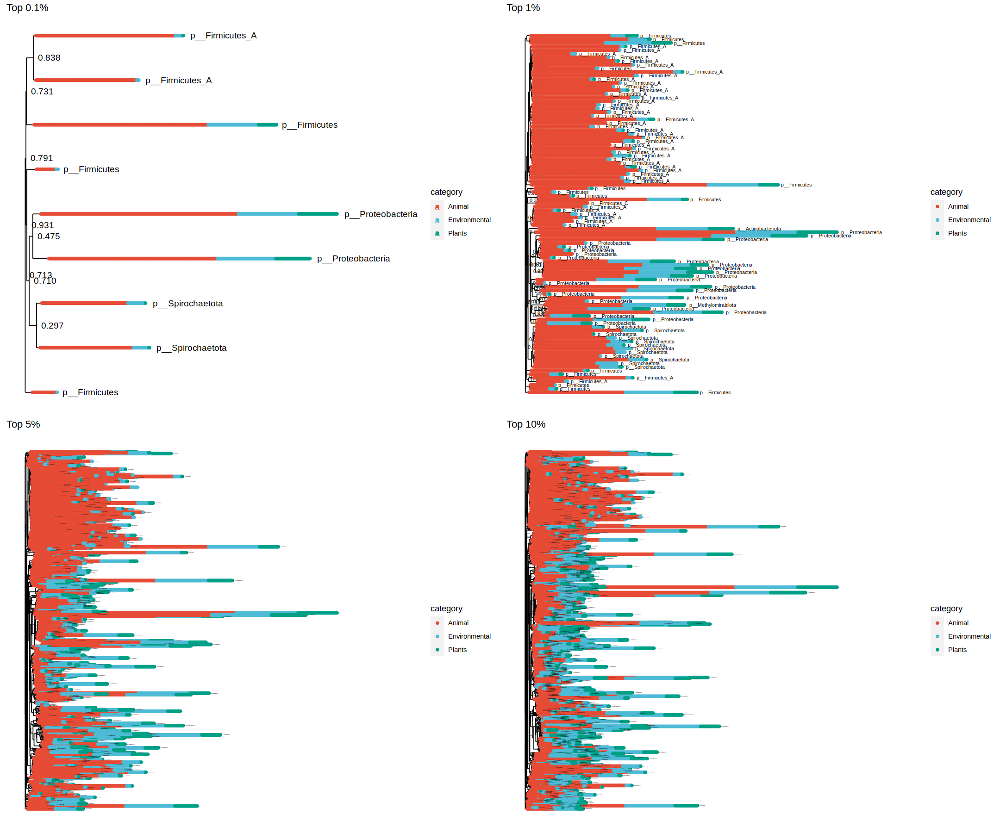

In [56]:
options(repr.plot.width=18,repr.plot.height=15)
grid.arrange(tre.top.0.1,
             tre.top.1,
             tre.top.5,
             tre.top.10,
             nrow=2)

### Plot OTUs network

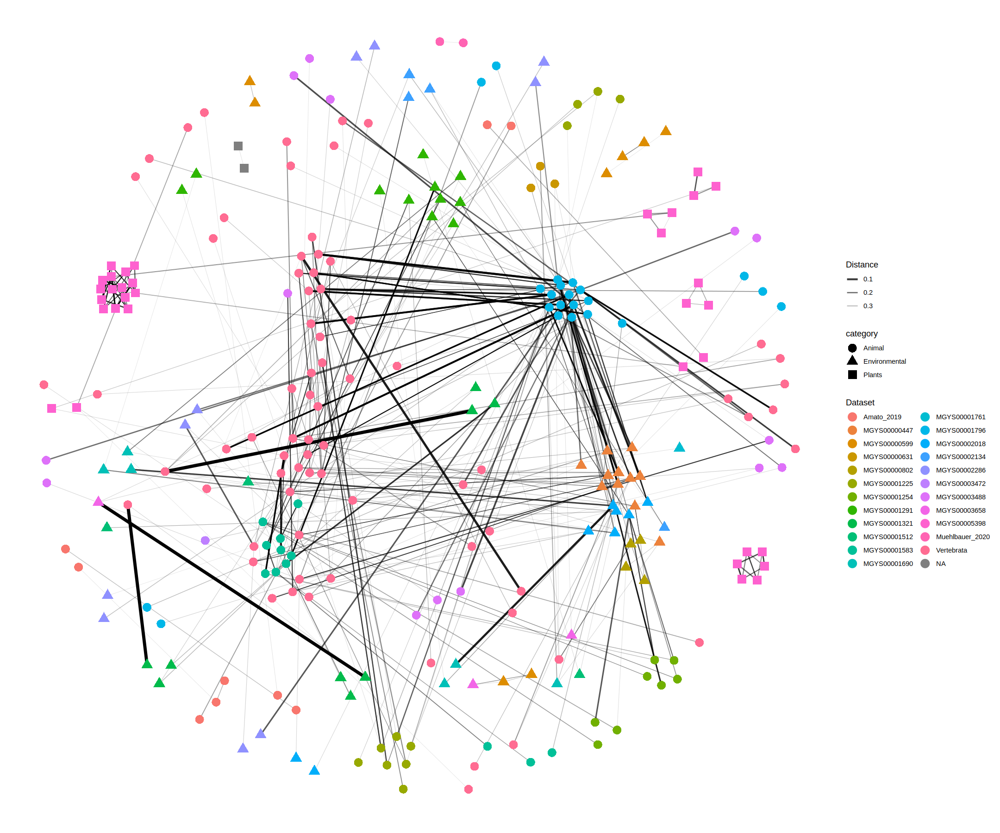

In [57]:
plot_net(filter_taxa_All, maxdist=0.4, color="Dataset", shape="category")

## 3B. Host-associated samples

In [ ]:
#Samples from infected tomato. Remove them in next step.
#to.filter.out=c("SRR10527383","SRR10527384","SRR10527385","SRR10527386","SRR10527387","SRR10527388","SRR10527390","SRR10527391","SRR10527392","SRR10527393","SRR10527394","SRR10527395","SRR10527396","SRR10527397","SRR10527389")

In [ ]:
#filter_taxa_All_count, psAll_count
subset.host.filt=subset_samples(filter_taxa_All_count,biome_1=="Host-associated")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [ ]:
subset.host.filt

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 938 taxa and 659 samples ]
sample_data() Sample Data:       [ 659 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 938 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 938 tips and 937 internal nodes ]

In [ ]:
subset.host.filt.rel=subset_samples(filter_taxa_All,biome_1=="Host-associated")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [ ]:
subset.host.filt

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 938 taxa and 659 samples ]
sample_data() Sample Data:       [ 659 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 938 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 938 tips and 937 internal nodes ]

### Richness plots

In [ ]:
values.plot=c("#e64b35b2","#4dbbd5b2","#00a087b2","#3c5488b2","#f39b7fb2","#8491b4b2")#,"#91d1c2b2","#dc0000b2","#7e6148b2")
breaks.plot=c("Actinopterygii","Amphibia","Aves","Mammalia","Plants","Reptilia")

In [ ]:
richness.estimates.host.filt=mutate(as_tibble(subset.host.filt@sam_data),estimate_richness(subset.host.filt, split = TRUE, measures = c("Observed","Chao1","Shannon","Simpson")))

In [ ]:
head(richness.estimates.host.filt)

Sample,Dataset,biome_0,biome_1,biome_2,biome_3,biome_4,family,category,mammals,Observed,Chao1,se.chao1,Shannon,Simpson
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ERS1065340,MGYS00000631,root,Host-associated,Mammalia,Digestive system,Stomach,Bovidae,Animal,Mammalia,294,458.8936,40.10175,4.397118,0.9660586
ERS1065341,MGYS00000631,root,Host-associated,Mammalia,Digestive system,Stomach,Bovidae,Animal,Mammalia,396,654.8824,56.58621,4.636187,0.9758817
ERS1065342,MGYS00000631,root,Host-associated,Mammalia,Digestive system,Stomach,Bovidae,Animal,Mammalia,264,407.8182,36.63174,3.948338,0.9491753
ERS1353918,MGYS00001254,root,Host-associated,Mammalia,Digestive system,Large intestine,Cricetidae,Animal,Mammalia,239,371.2222,39.85191,3.149245,0.8207401
ERS1353919,MGYS00001254,root,Host-associated,Mammalia,Digestive system,Large intestine,Cricetidae,Animal,Mammalia,282,430.3333,43.83913,3.545150,0.8794014
ERS1353920,MGYS00001254,root,Host-associated,Mammalia,Digestive system,Large intestine,Cricetidae,Animal,Mammalia,258,396.1034,40.37598,3.349012,0.8880629


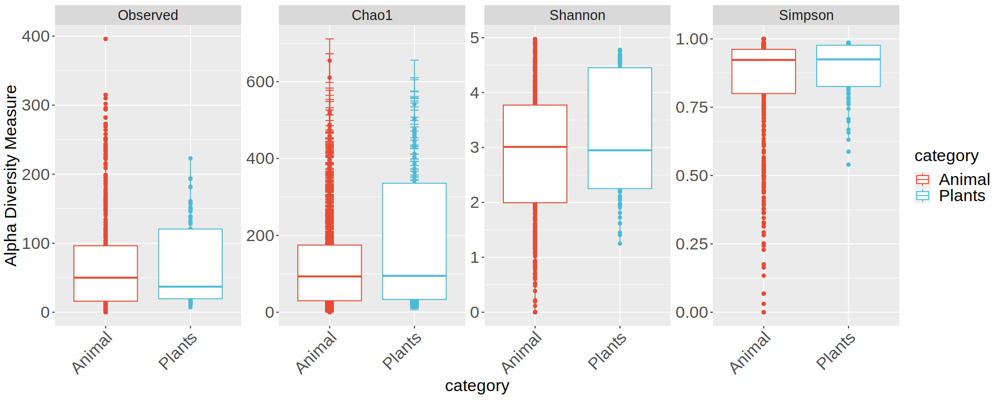

In [ ]:
options(repr.plot.width=15,repr.plot.height=6)
plot_richness(subset.host.filt,x="category",measures=c("Observed","Chao1","Shannon","Simpson"),color="category")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

### Statistics on richness estimates

#### I. Kruskal tests by category

In [ ]:
kruskal.test(Observed~category,data=richness.estimates.host.filt)


	Kruskal-Wallis rank sum test

data:  Observed by category
Kruskal-Wallis chi-squared = 0.023389, df = 1, p-value = 0.8784


In [ ]:
kruskal.test(Chao1~category,data=richness.estimates.host.filt)


	Kruskal-Wallis rank sum test

data:  Chao1 by category
Kruskal-Wallis chi-squared = 2.886, df = 1, p-value = 0.08935


In [ ]:
kruskal.test(Shannon~category,data=richness.estimates.host.filt)


	Kruskal-Wallis rank sum test

data:  Shannon by category
Kruskal-Wallis chi-squared = 4.5335, df = 1, p-value = 0.03324


In [ ]:
kruskal.test(Simpson~category,data=richness.estimates.host.filt)


	Kruskal-Wallis rank sum test

data:  Simpson by category
Kruskal-Wallis chi-squared = 3.2077, df = 1, p-value = 0.07329


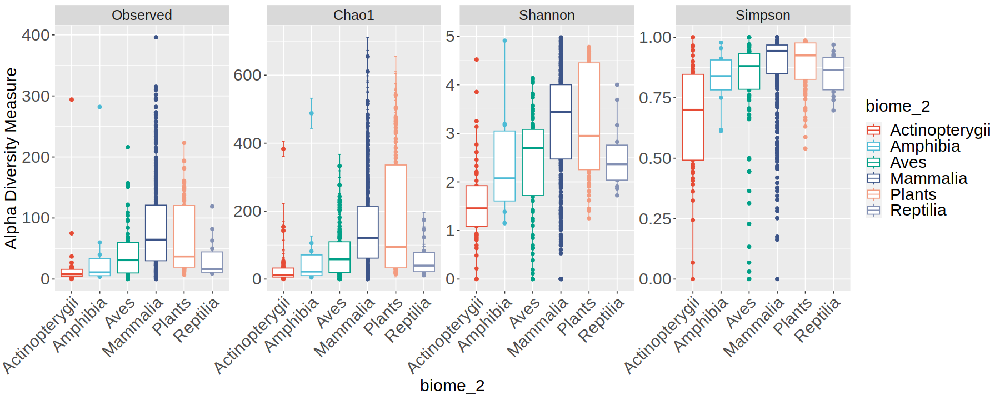

In [ ]:
plot_richness(subset.host.filt,x="biome_2",measures=c("Observed","Chao1","Shannon","Simpson"),color="biome_2")+
geom_boxplot()+
scale_color_npg()+#scale_color_manual(values=values.plot,breaks=breaks.plot)+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

#### II. Kruskal test by biome_2

In [ ]:
dplyr::count(richness.estimates.host.filt,biome_2)

biome_2,n
<chr>,<int>
Actinopterygii,53
Amphibia,11
Aves,100
Mammalia,394
Plants,87
Reptilia,14


In [ ]:
kruskal.test(Observed~biome_2,data=richness.estimates.host.filt)


	Kruskal-Wallis rank sum test

data:  Observed by biome_2
Kruskal-Wallis chi-squared = 122.16, df = 5, p-value < 2.2e-16


In [ ]:
kruskal.test(Chao1~biome_2,data=richness.estimates.host.filt)


	Kruskal-Wallis rank sum test

data:  Chao1 by biome_2
Kruskal-Wallis chi-squared = 112.7, df = 5, p-value < 2.2e-16


In [ ]:
kruskal.test(Shannon~biome_2,data=richness.estimates.host.filt)


	Kruskal-Wallis rank sum test

data:  Shannon by biome_2
Kruskal-Wallis chi-squared = 112.62, df = 5, p-value < 2.2e-16


In [ ]:
kruskal.test(Simpson~biome_2,data=richness.estimates.host.filt)


	Kruskal-Wallis rank sum test

data:  Simpson by biome_2
Kruskal-Wallis chi-squared = 82.635, df = 5, p-value = 2.356e-16


#### II. Wilcoxon test by biome_2

In [ ]:
pairwise.wilcox.test(richness.estimates.host.filt$Observed, 
                     richness.estimates.host.filt$biome_2, 
                     p.adjust.method="fdr")

Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”



	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.host.filt$Observed and richness.estimates.host.filt$biome_2 

         Actinopterygii Amphibia Aves    Mammalia Plants
Amphibia 0.2330         -        -       -        -     
Aves     1.4e-06        0.2592   -       -        -     
Mammalia < 2e-16        0.0061   5.8e-09 -        -     
Plants   1.6e-14        0.0228   0.0188  0.0174   -     
Reptilia 0.0028         0.2924   0.5455  0.0043   0.0127

P value adjustment method: fdr 

In [ ]:
pairwise.wilcox.test(richness.estimates.host.filt$Chao1, 
                     richness.estimates.host.filt$biome_2, 
                     p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.host.filt$Chao1 and richness.estimates.host.filt$biome_2 

         Actinopterygii Amphibia Aves    Mammalia Plants
Amphibia 0.0806         -        -       -        -     
Aves     6.3e-07        0.2833   -       -        -     
Mammalia < 2e-16        0.0067   2.1e-08 -        -     
Plants   8.4e-13        0.0215   0.0039  0.6540   -     
Reptilia 0.0014         0.3974   0.5876  0.0058   0.0500

P value adjustment method: fdr 

In [ ]:
pairwise.wilcox.test(richness.estimates.host.filt$Shannon, 
                     richness.estimates.host.filt$biome_2, 
                     p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.host.filt$Shannon and richness.estimates.host.filt$biome_2 

         Actinopterygii Amphibia Aves    Mammalia Plants 
Amphibia 0.02872        -        -       -        -      
Aves     3.1e-05        0.92033  -       -        -      
Mammalia 5.7e-16        0.02872  2.0e-10 -        -      
Plants   1.5e-13        0.05012  0.00029 0.94429  -      
Reptilia 0.00029        0.76150  0.92033 0.01562  0.05012

P value adjustment method: fdr 

In [ ]:
pairwise.wilcox.test(richness.estimates.host.filt$Simpson, 
                     richness.estimates.host.filt$biome_2, 
                     p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.host.filt$Simpson and richness.estimates.host.filt$biome_2 

         Actinopterygii Amphibia Aves    Mammalia Plants
Amphibia 0.0344         -        -       -        -     
Aves     5.1e-05        0.7597   -       -        -     
Mammalia 2.9e-12        0.0485   4.3e-07 -        -     
Plants   1.6e-09        0.0978   0.0079  0.9810   -     
Reptilia 0.0079         0.9116   0.8609  0.0194   0.0682

P value adjustment method: fdr 

### Beta diversity

### 1. Ordination

In [ ]:
head(subset.host.filt@otu_table)

,ERS1065340,ERS1065341,ERS1065342,ERS1353918,ERS1353919,ERS1353920,ERS1353921,ERS1353922,ERS1353923,ERS1353924,⋯,36UNCULTURED_S10,400UNCULTURED_S11,40UNCULTURED_S15,4UNCULTURED_S2,500UNCULTURED_S13,8UNCULTURED_S5,lucaAR31_S16,lucaAR32_S17,lucaAR33_S18,lucaAR34_S19
WP_018305791.1,0,1,0,3,2,3,3,1,1,0,⋯,1,0,0,3,0,0,3,0,0,8
KJS48310.1,0,0,0,0,0,0,0,0,0,1,⋯,0,0,0,0,0,0,0,0,1,0
OBW58796.1,2,1,0,1,1,1,1,4,1,0,⋯,0,0,0,0,0,0,0,0,0,0
ESU34160.1,1,0,0,1,5,1,2,2,1,0,⋯,0,0,0,0,0,0,0,0,0,0
WP_087615600.1,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
WP_039042127.1,0,0,0,0,0,0,0,0,2,0,⋯,0,0,0,0,0,0,0,0,0,0


In [ ]:
jaccard.host.filt=ordinate(subset.host.filt.rel,distance="jaccard",method="PCoA")
unifrac.host.filt=ordinate(subset.host.filt.rel,distance="unifrac",method="PCoA")

### 2. Plots

#### By category

In [ ]:
plot.host.filt.jaccard.cat=plot_ordination(physeq = subset.host.filt.rel,jaccard.host.filt,type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

plot.host.filt.unifrac.cat=plot_ordination(physeq = subset.host.filt.rel,unifrac.host.filt,type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

#### By biome_2

In [ ]:
plot.host.filt.jaccard=plot_ordination(physeq = subset.host.filt.rel,jaccard.host.filt,type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

plot.host.filt.unifrac=plot_ordination(physeq = subset.host.filt.rel,unifrac.host.filt,type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

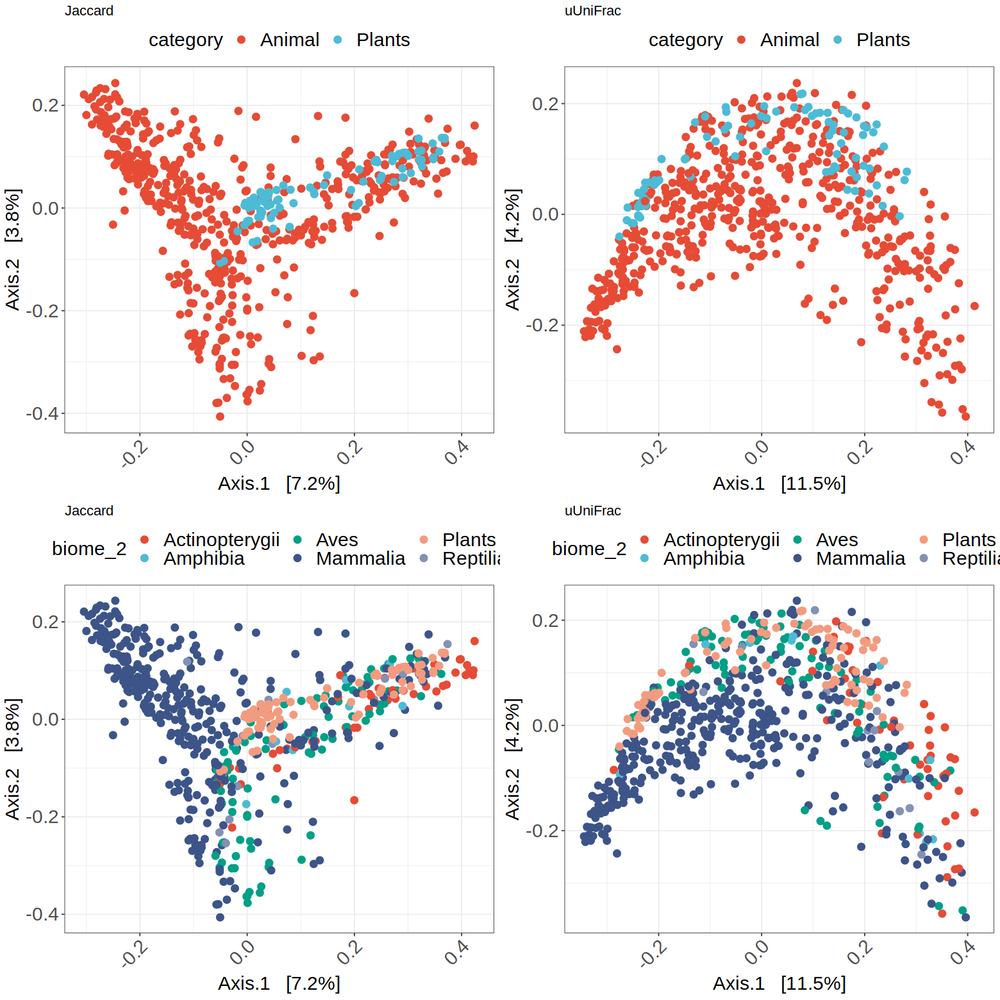

In [ ]:
options(repr.plot.width=13,repr.plot.height=13)
grid.arrange(plot.host.filt.jaccard.cat,
             plot.host.filt.unifrac.cat,
             plot.host.filt.jaccard,
             plot.host.filt.unifrac,
             nrow=2)

### 3. Pairwise dissimilarity

#### By category

In [ ]:
host.filt.diss.jacc1=phyloseq_group_dissimilarity(subset.host.filt.rel,group="category",method="jaccard",between_groups = TRUE)+ggtitle("Jaccard")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

host.filt.diss.unifrac1=phyloseq_group_dissimilarity(subset.host.filt.rel,group="category",method="unifrac",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



#### By biome_2

In [ ]:
host.filt.diss.jacc2=phyloseq_group_dissimilarity(subset.host.filt.rel,group="biome_2",method="jaccard",between_groups = TRUE)+ggtitle("Jaccard")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

host.filt.diss.unifrac2=phyloseq_group_dissimilarity(subset.host.filt.rel,group="biome_2",method="unifrac",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'



Warning message:
“This manual palette can handle a maximum of 10 values. You have supplied 21.”
Warning message:
“This manual palette can handle a maximum of 10 values. You have supplied 21.”


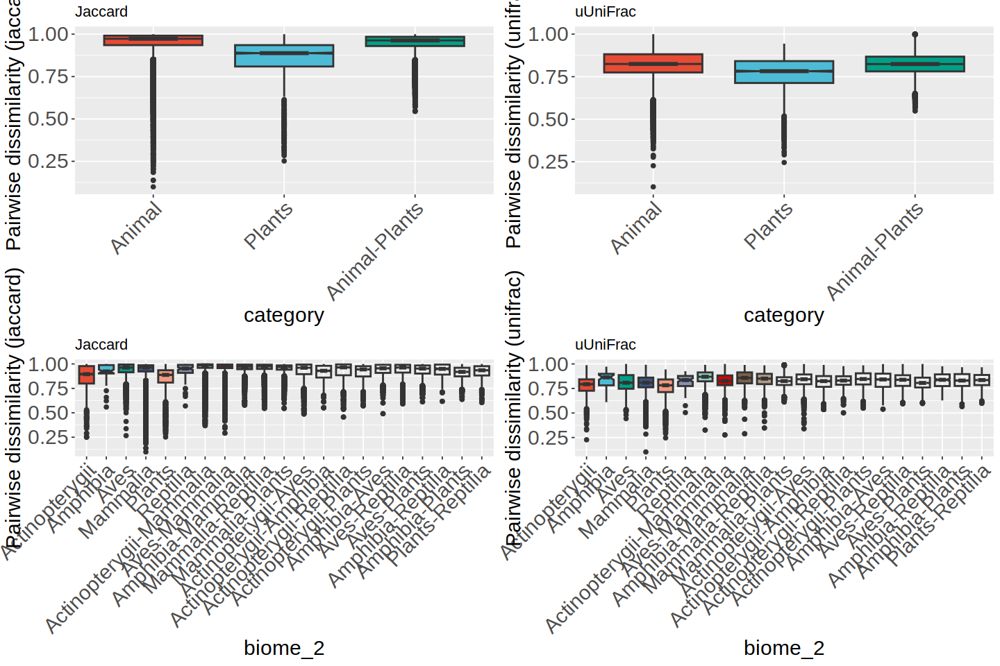

In [ ]:
options(repr.plot.width=12,repr.plot.height=8)
grid.arrange(host.filt.diss.jacc1,
             host.filt.diss.unifrac1,
             host.filt.diss.jacc2,
             host.filt.diss.unifrac2,
             nrow=2)

In [ ]:
subset.host.filt.no.mammals = subset_samples(subset.host.filt.rel,biome_2!="Mammalia")
subset.host.filt.no.mammals=subset_samples(subset.host.filt.no.mammals,biome_1=="Host-associated")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [ ]:
subset.host.filt.no.mammals

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 938 taxa and 257 samples ]
sample_data() Sample Data:       [ 257 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 938 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 938 tips and 937 internal nodes ]

In [ ]:
nonmammals.filt.jaccard=ordinate(subset.host.filt.no.mammals,distance="jaccard",method="PCoA")
nonmammals.filt.unifrac=ordinate(subset.host.filt.no.mammals,distance="unifrac",method="PCoA")

In [ ]:
jaccard.filt.non.mammals=plot_ordination(physeq = subset.host.filt.no.mammals,
                                          nonmammals.filt.jaccard,
                                          type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

unifrac.filt.non.mammals=plot_ordination(physeq = subset.host.filt.no.mammals,
                                          nonmammals.filt.unifrac,
                                          type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

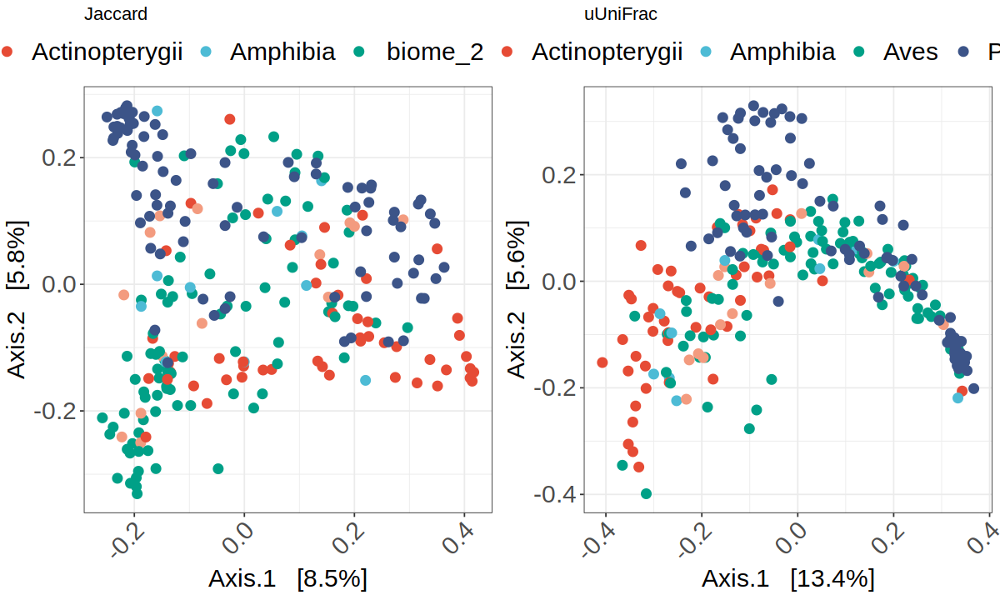

In [ ]:
options(repr.plot.width=10,repr.plot.height=6)
grid.arrange(jaccard.filt.non.mammals,
             unifrac.filt.non.mammals,
             nrow=1)

In [ ]:
host.tre.top=plot_tree(phyloseq_filter_top_taxa(subset.host.filt.rel,perc=10),color="category",label.tips="family")+scale_color_npg()

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



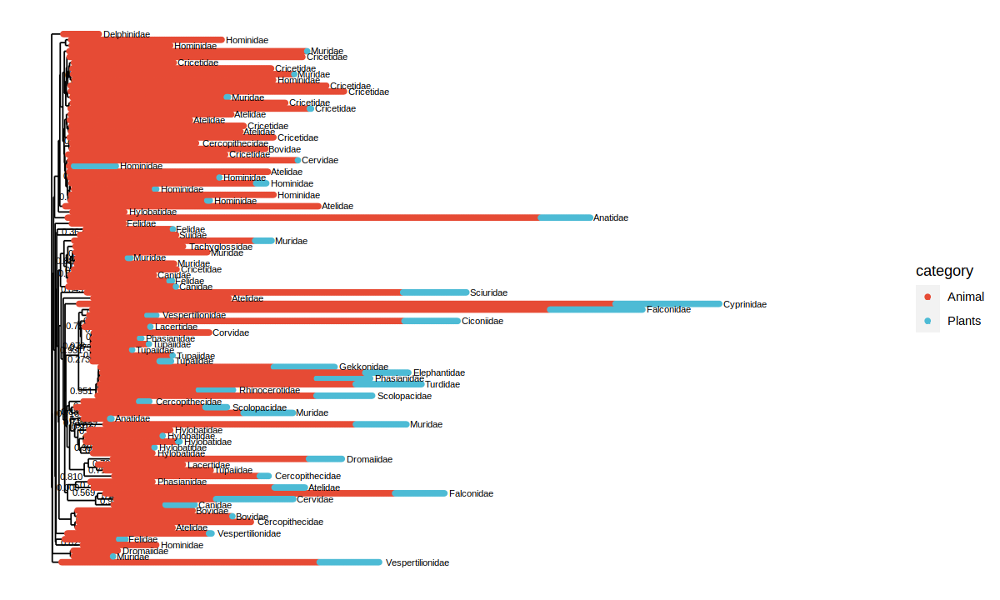

In [ ]:
host.tre.top

In [ ]:
tre.host.top.0.1=plot_tree(phyloseq_filter_top_taxa(subset.host.filt.rel,n=10),color="biome_2",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 0.1%")

tre.host.top.1=plot_tree(phyloseq_filter_top_taxa(subset.host.filt.rel,n=30),color="biome_2",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 1%")

tre.host.top.5=plot_tree(phyloseq_filter_top_taxa(subset.host.filt.rel,n=50),color="biome_2",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 5%")

tre.host.top.10=plot_tree(phyloseq_filter_top_taxa(subset.host.filt.rel,n=100),color="biome_2",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 10%")


Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plo

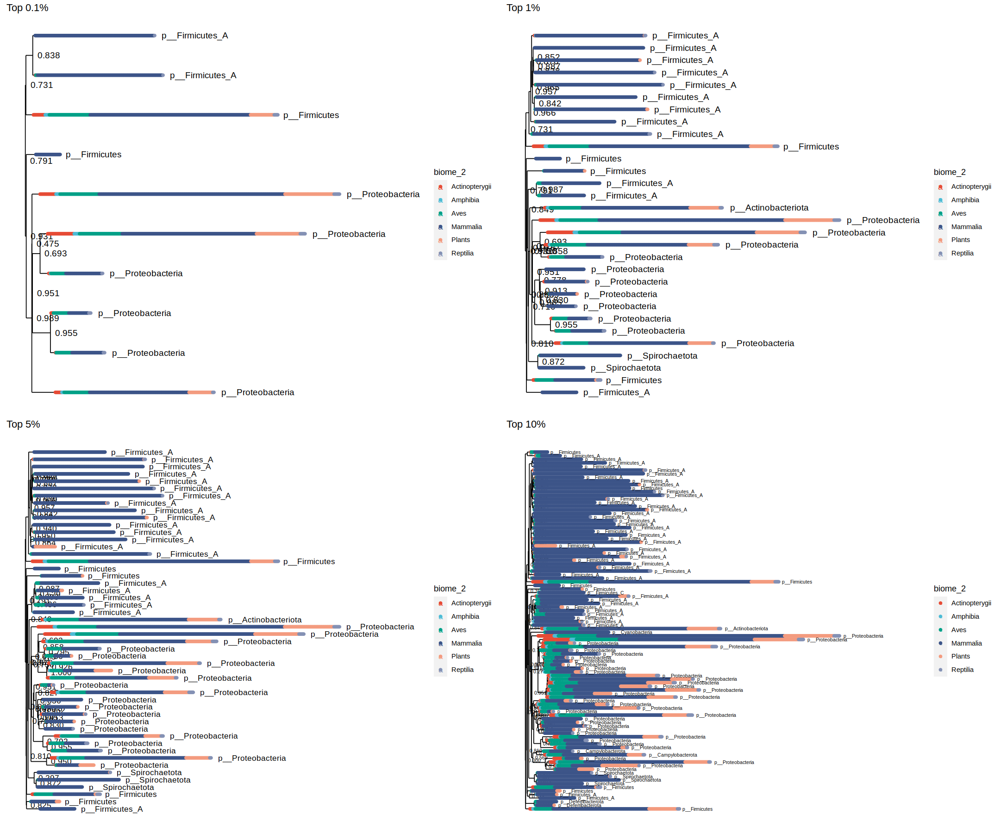

In [ ]:
options(repr.plot.width=18,repr.plot.height=15)
grid.arrange(tre.host.top.0.1,
             tre.host.top.1,
             tre.host.top.5,
             tre.host.top.10,
             nrow=2)

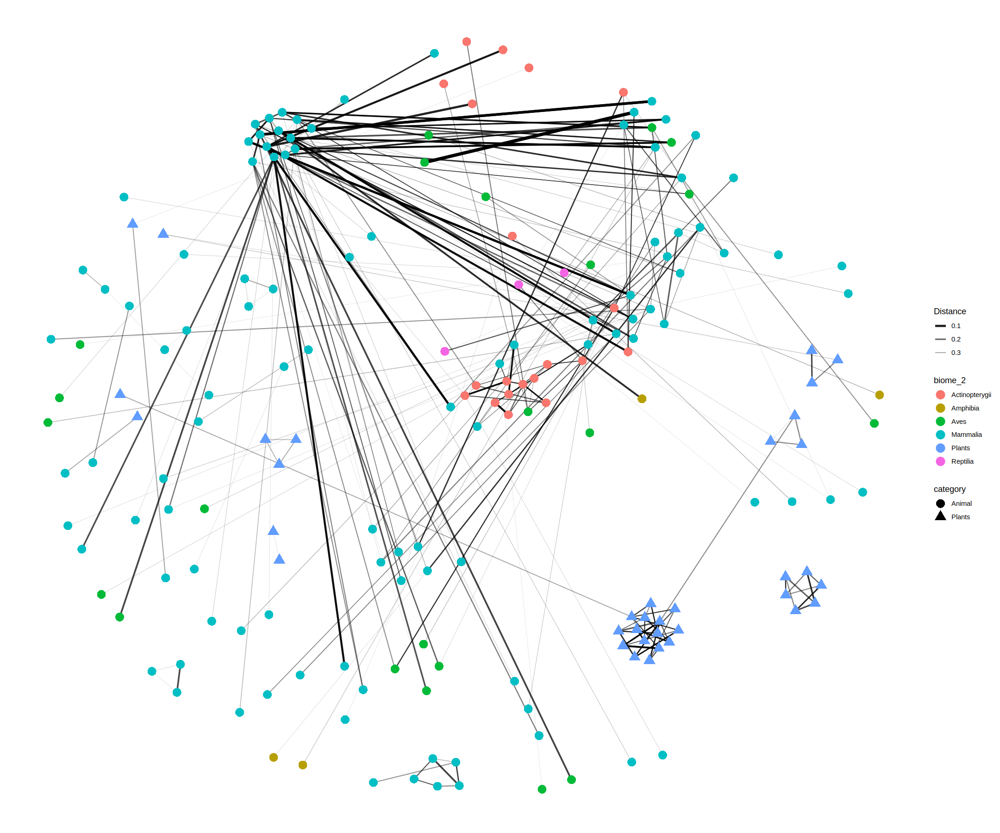

In [ ]:
plot_net(subset.host.filt.rel, maxdist=0.4, color="biome_2", shape="category")

# -Rarefaction results

## 4. Rarefaction even depth - All samples

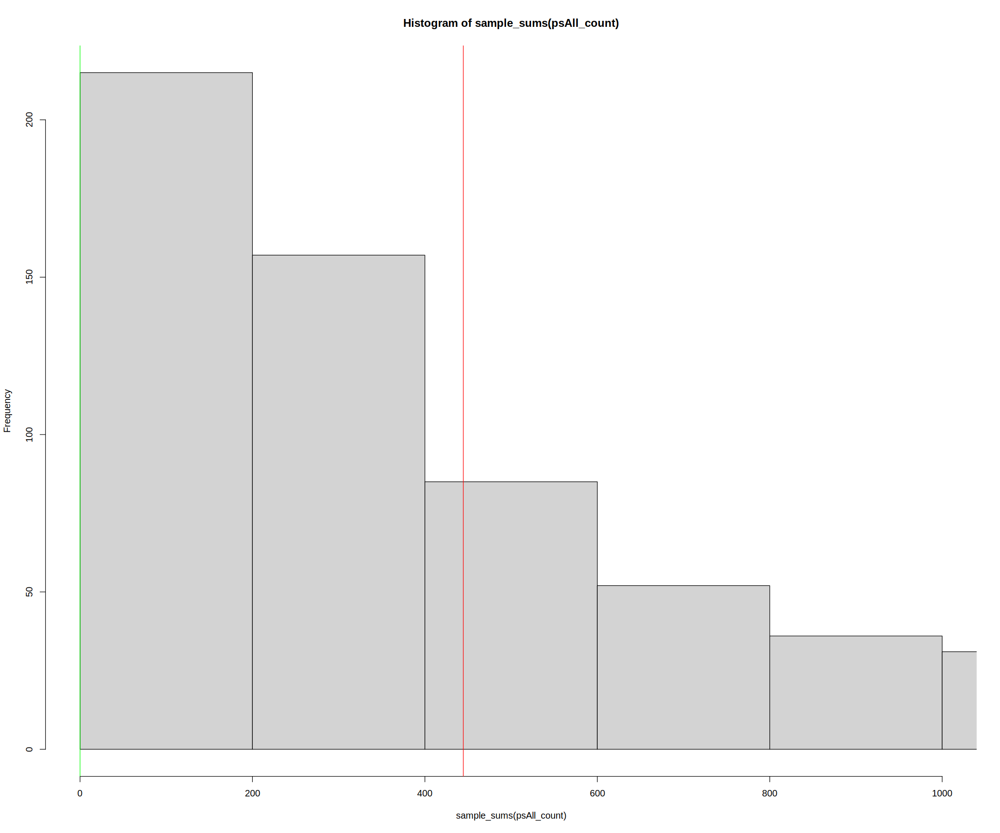

In [99]:
hist(sample_sums(psAll_count),xlim=c(0,1000),breaks=100)
abline(v=median(sample_sums(psAll_count)),col="red")
abline(v=mean(sample_sums(psAll_count)),col="blue")
abline(v=min(sample_sums(psAll_count)),col="green")

In [100]:
psAll_count

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9963 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9963 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9963 tips and 9945 internal nodes ]

In [101]:
rarefied.ps.All=rarefy_even_depth(psAll_count, sample.size=median(sample_sums(psAll_count)),
  rngseed = TRUE, replace = TRUE, trimOTUs = TRUE, verbose = TRUE)

`set.seed(TRUE)` was used to initialize repeatable random subsampling.

Please record this for your records so others can reproduce.

Try `set.seed(TRUE); .Random.seed` for the full vector

...

396 samples removedbecause they contained fewer reads than `sample.size`.

Up to first five removed samples are: 


ERS1030533ERS1286097ERS1286101ERS1286102ERS1286103

...

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

956OTUs were removed because they are no longer 
present in any sample after random subsampling


...

Found more than one class "phylo" in cache; using the first, from namespa

In [423]:
rarefied.ps.All

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9007 taxa and 396 samples ]
sample_data() Sample Data:       [ 396 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9007 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9007 tips and 8997 internal nodes ]

In [103]:
count(as_tibble(psAll_count@sam_data),biome_1)

biome_1,n
<chr>,<int>
Environmental,133
Host-associated,659


In [487]:
count(as_tibble(rarefied.ps.All@sam_data),biome_2)

biome_2,n
<chr>,<int>
Actinopterygii,4
Amphibia,1
Aquatic,71
Aves,36
Mammalia,216
Plants,32
Reptilia,5
Terrestrial,31


In [105]:
rarefied.ps.All

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9007 taxa and 396 samples ]
sample_data() Sample Data:       [ 396 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9007 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9007 tips and 8997 internal nodes ]

In [106]:
write_tsv(as_tibble(rarefied.ps.All@otu_table),"otus_RareSubsetHost.tsv")
write_tsv(as_tibble(rarefied.ps.All@sam_data),"mapping_RareSubsetHost.tsv")
write_tsv(as_tibble(rarefied.ps.All@tax_table),"flags.tax_RareSubsetHost.tsv")
write.tree(rarefied.ps.All@phy_tree,"flags.tre_RareSubsetHost.tre")

In [424]:
# Flagellins in plants
flas.plants.rare = ps_filter(rarefied.ps.All,category=="Plants")
flas.present.plants.rare = phyloseq_filter_prevalence(flas.plants.rare, abund.trh = 1,
  threshold_condition = "OR", abund.type = "total")
write.tree(flas.present.plants.rare@phy_tree,"edgeR/flags.tre_Plants.rare.tre")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [428]:
flas.present.animals.rare

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 6968 taxa and 262 samples ]
sample_data() Sample Data:       [ 262 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 6968 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 6968 tips and 6961 internal nodes ]

In [434]:
#Flagellins in animals
flas.animals.rare = ps_filter(rarefied.ps.All,category=="Animal")
flas.present.animals.rare = phyloseq_filter_prevalence(flas.animals.rare, abund.trh = 1,
  threshold_condition = "OR", abund.type = "total")
#write.tree(flas.present.animals.rare@phy_tree,"edgeR/flags.tre_Animals.rare.tre")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [435]:
flas.animals.rare

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 6968 taxa and 262 samples ]
sample_data() Sample Data:       [ 262 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 6968 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 6968 tips and 6961 internal nodes ]

In [426]:
#Flagellins in environmental
flas.env.rare = ps_filter(rarefied.ps.All,category=="Environmental")
flas.present.env.rare = phyloseq_filter_prevalence(flas.env.rare, abund.trh = 1,
  threshold_condition = "OR", abund.type = "total")
write.tree(flas.present.env.rare@phy_tree,"edgeR/flags.tre_Env.rare.tre")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



## 5. Diversity analyses - rarefied and non-filtered by prevalence

In [107]:
count(as_tibble(rarefied.ps.All@sam_data),biome_1)

biome_1,n
<chr>,<int>
Environmental,102
Host-associated,294


### Composition plots

In [108]:
top.100.rare=phyloseq_filter_top_taxa(rarefied.ps.All,n=100)
top.30.rare=phyloseq_filter_top_taxa(rarefied.ps.All,n=30)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [109]:
values.taxa=c("#e64b35b2","#4dbbd5b2","#00a087b2","#3c5488b2","#f39b7fb2","#8491b4b2","#91d1c2b2")#,"#dc0000b2","#7e6148b2")
breaks.taxa=c("p__Actinobacteria","p__Firmicutes","p__Firmicutes_A","p__Firmicutes_C","p__Methylomirabilota","p__Proteobacteria","p__Spirochaetota")

In [110]:
top.100.rare.barplot=plot_bar(transform_sample_counts(top.100.rare, function(x) (1E6 * x / sum(x))),
fill="Phylum")+
                         geom_bar(position="stack",stat="identity")+
                         facet_wrap(~biome_1,scales="free")+
                         theme_minimal()+
                         labels.legend+
                         theme(axis.text.x = element_blank())+
                         #scale_fill_manual(breaks=breaks.taxa,values=values.taxa)+
                         ggtitle("Top 100 taxa")

top.30.rare.barplot=plot_bar(transform_sample_counts(top.30.rare, function(x) (1E6 * x / sum(x))),
fill="Phylum")+
                         geom_bar(position="stack",stat="identity")+
                         facet_wrap(~biome_1,scales="free")+
                         theme_minimal()+
                         labels.legend+
                         theme(axis.text.x = element_blank())+
                         #scale_fill_manual(breaks=breaks.taxa,values=values.taxa)+
                         ggtitle("Top 30 taxa")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" 

### 5.1. Richness estimates

In [112]:
richness.estimates.rarefiedpsAll=mutate(as_tibble(rarefied.ps.All@sam_data),estimate_richness(rarefied.ps.All, split = TRUE, measures = NULL))

In [113]:
head(richness.estimates.rarefiedpsAll)

Sample,Dataset,biome_0,biome_1,biome_2,biome_3,biome_4,family,category,mammals,Observed,Chao1,se.chao1,ACE,se.ACE,Shannon,Simpson,InvSimpson,Fisher
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ERS1030529,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,190,328.3171,36.26924,378.5539,13.759375,4.657671,0.9721309,35.88205,125.75559
ERS1030531,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,187,250.0172,17.80946,269.6128,9.340082,4.745678,0.9787558,47.07163,121.70978
ERS1030532,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,169,280.2500,31.64955,295.1517,10.354278,4.424149,0.9587797,24.25991,99.57011
ERS1030534,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,168,304.4865,37.03283,373.7152,12.679324,4.450154,0.9749006,39.84155,98.43925
ERS1030535,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,183,316.7727,34.55396,392.9212,13.816907,4.597434,0.9785529,46.62630,116.48167
ERS1030536,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,168,232.9091,18.45910,280.2483,10.710811,4.135320,0.9183001,12.23991,98.43925


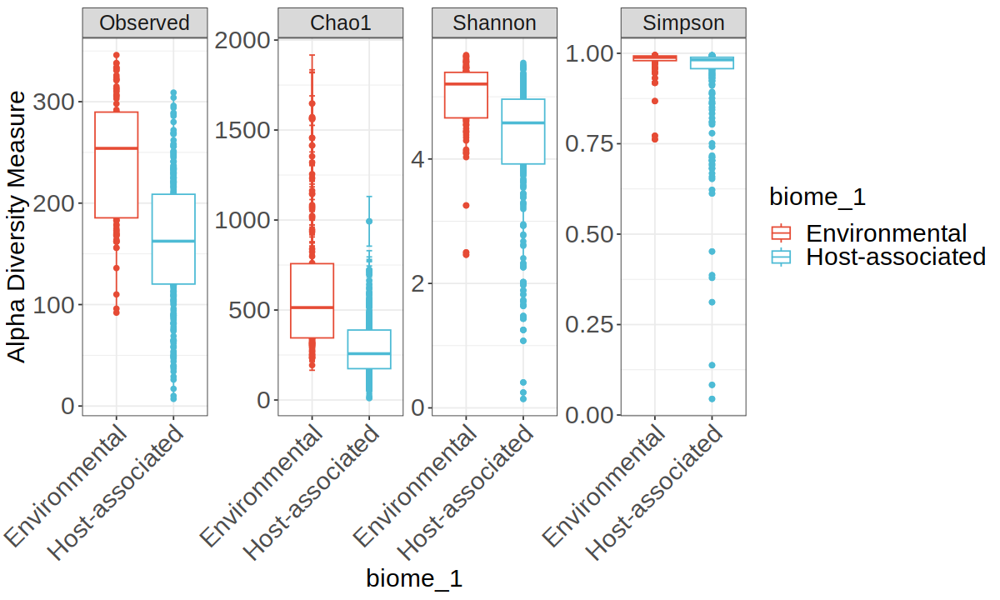

In [490]:
options(repr.plot.width=10,repr.plot.height=6)
plot_richness(rarefied.ps.All,x="biome_1",measures=c("Observed","Chao1","Shannon","Simpson"),color="biome_1")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

### Statistics on richness estimates

#### I. Kruskal tests by biome_1

In [115]:
kruskal.test(Observed~biome_1,data=richness.estimates.rarefiedpsAll)


	Kruskal-Wallis rank sum test

data:  Observed by biome_1
Kruskal-Wallis chi-squared = 87.915, df = 1, p-value < 2.2e-16


In [116]:
kruskal.test(Chao1~biome_1,data=richness.estimates.rarefiedpsAll)


	Kruskal-Wallis rank sum test

data:  Chao1 by biome_1
Kruskal-Wallis chi-squared = 98.073, df = 1, p-value < 2.2e-16


In [117]:
kruskal.test(Shannon~biome_1,data=richness.estimates.rarefiedpsAll)


	Kruskal-Wallis rank sum test

data:  Shannon by biome_1
Kruskal-Wallis chi-squared = 62.493, df = 1, p-value = 2.673e-15


In [118]:
kruskal.test(Simpson~biome_1,data=richness.estimates.rarefiedpsAll)


	Kruskal-Wallis rank sum test

data:  Simpson by biome_1
Kruskal-Wallis chi-squared = 28.244, df = 1, p-value = 1.069e-07


#### II. Kruskal tests by category

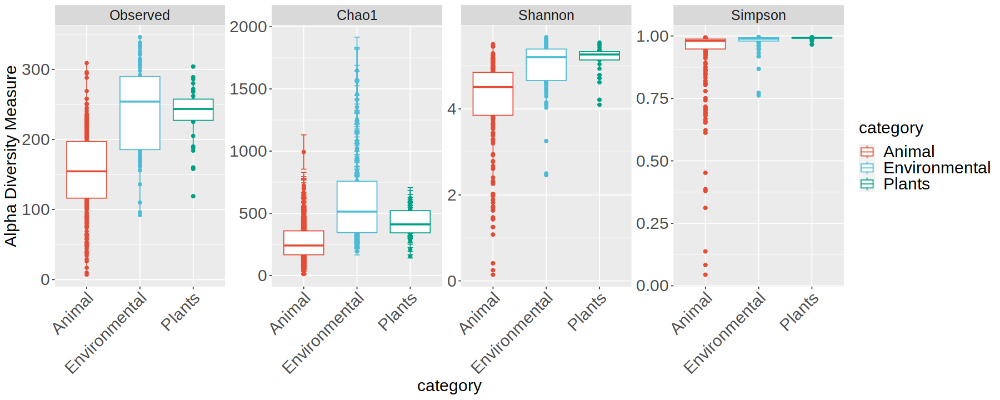

In [119]:
options(repr.plot.width=15,repr.plot.height=6)
plot_richness(rarefied.ps.All,x="category",measures=c("Observed","Chao1","Shannon","Simpson"),color="category")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

In [120]:
kruskal.test(Observed~category,data=richness.estimates.rarefiedpsAll)


	Kruskal-Wallis rank sum test

data:  Observed by category
Kruskal-Wallis chi-squared = 132.46, df = 2, p-value < 2.2e-16


In [121]:
kruskal.test(Chao1~category,data=richness.estimates.rarefiedpsAll)


	Kruskal-Wallis rank sum test

data:  Chao1 by category
Kruskal-Wallis chi-squared = 124.11, df = 2, p-value < 2.2e-16


In [122]:
kruskal.test(Shannon~category,data=richness.estimates.rarefiedpsAll)


	Kruskal-Wallis rank sum test

data:  Shannon by category
Kruskal-Wallis chi-squared = 112.29, df = 2, p-value < 2.2e-16


In [123]:
kruskal.test(Simpson~category,data=richness.estimates.rarefiedpsAll)


	Kruskal-Wallis rank sum test

data:  Simpson by category
Kruskal-Wallis chi-squared = 83.869, df = 2, p-value < 2.2e-16


#### III. Wilcoxon tests by category

In [124]:
pairwise.wilcox.test(richness.estimates.rarefiedpsAll$Observed, richness.estimates.rarefiedpsAll$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.rarefiedpsAll$Observed and richness.estimates.rarefiedpsAll$category 

              Animal  Environmental
Environmental < 2e-16 -            
Plants        1.8e-12 0.4          

P value adjustment method: fdr 

In [125]:
pairwise.wilcox.test(richness.estimates.rarefiedpsAll$Chao1, richness.estimates.rarefiedpsAll$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.rarefiedpsAll$Chao1 and richness.estimates.rarefiedpsAll$category 

              Animal Environmental
Environmental <2e-16 -            
Plants        5e-08  0.016        

P value adjustment method: fdr 

In [126]:
pairwise.wilcox.test(richness.estimates.rarefiedpsAll$Shannon, richness.estimates.rarefiedpsAll$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.rarefiedpsAll$Shannon and richness.estimates.rarefiedpsAll$category 

              Animal  Environmental
Environmental < 2e-16 -            
Plants        5.3e-13 0.42         

P value adjustment method: fdr 

In [127]:
pairwise.wilcox.test(richness.estimates.rarefiedpsAll$Simpson, richness.estimates.rarefiedpsAll$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.rarefiedpsAll$Simpson and richness.estimates.rarefiedpsAll$category 

              Animal  Environmental
Environmental 5.6e-11 -            
Plants        8.9e-13 0.00048      

P value adjustment method: fdr 

### 5.2. Beta diversity

#### I. Ordination matrices

In [128]:
rare.jaccard.ordination=ordinate(rarefied.ps.All,distance="jaccard",method="PCoA")
rare.unifrac.ordination=ordinate(rarefied.ps.All,distance="unifrac",method="PCoA")

Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- WP_036798668.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



#### I. Ordination plots

Ordination plots by biome_1

In [129]:
rare.jaccard.biome1=plot_ordination(physeq = rarefied.ps.All,rare.jaccard.ordination,type="samples",color="biome_1")+
  theme_bw()+
  geom_point(size=2)+
  scale_color_npg()+
theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

rare.unifrac.biome1=plot_ordination(physeq = rarefied.ps.All,rare.unifrac.ordination,type="samples",color="biome_1")+
  theme_bw()+
  geom_point(size=2)+
  scale_color_npg()+
theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

Ordination plots by category

In [130]:
rare.jaccard.category=plot_ordination(physeq = rarefied.ps.All,rare.jaccard.ordination,type="samples",color="category")+
  theme_bw()+
  geom_point(size=2)+
  scale_color_npg()+
theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

rare.unifrac.category=plot_ordination(physeq = rarefied.ps.All,rare.unifrac.ordination,type="samples",color="category")+
  theme_bw()+
  geom_point(size=2)+
  scale_color_npg()+
theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend


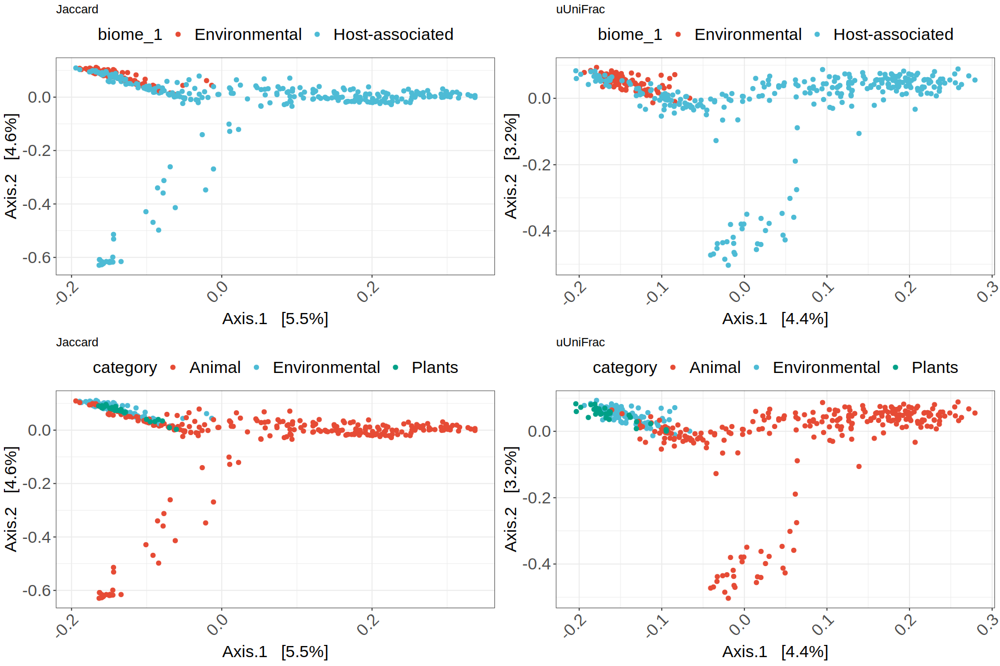

In [131]:
options(repr.plot.width=15,repr.plot.height=10)
grid.arrange(rare.jaccard.biome1,
             rare.unifrac.biome1,
             rare.jaccard.category,
             rare.unifrac.category,
             nrow=2)

### 5.3. Pairwise dissimilarities

By biome_1

In [132]:
rare.diss.jacc1=phyloseq_group_dissimilarity(rarefied.ps.All,group="biome_1",method="jaccard",between_groups = TRUE)+ggtitle("Jaccard")+labels.x + labels.y + labels.legend+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))+theme(legend.position = "none")

rare.diss.unifrac1=phyloseq_group_dissimilarity(rarefied.ps.All,group="biome_1",method="unifrac",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))+theme(legend.position = "none")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- WP_032333159.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first,

By category

In [133]:
rare.diss.jaccard.cat=phyloseq_group_dissimilarity(rarefied.ps.All,group="category",method="jaccard",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))+theme(legend.position = "none")

rare.diss.unifrac.cat=phyloseq_group_dissimilarity(rarefied.ps.All,group="category",method="unifrac",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))+theme(legend.position = "none")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- WP_034754002.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first,

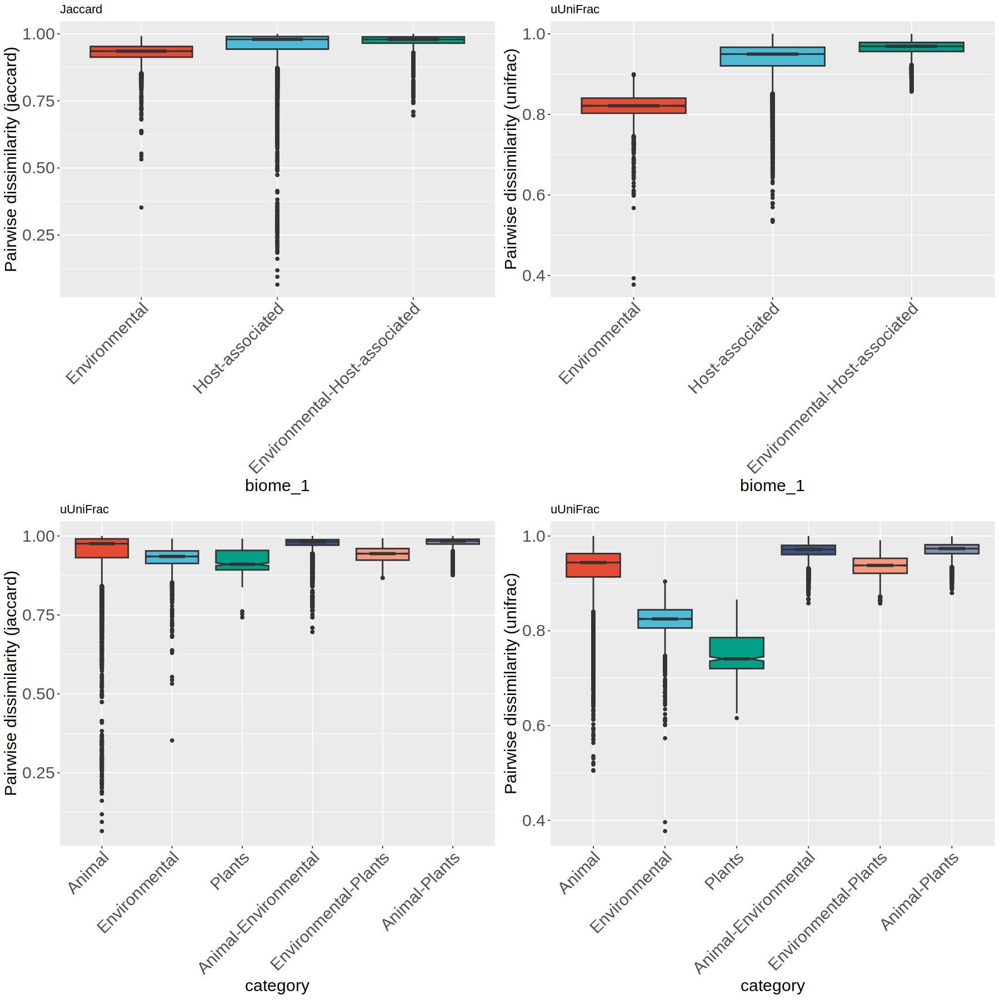

In [134]:
options(repr.plot.width=15,repr.plot.height=15)
grid.arrange(rare.diss.jacc1,
             rare.diss.unifrac1,
             rare.diss.jaccard.cat,
             rare.diss.unifrac.cat,
             nrow=2)

### 5.4. OTU tree

In [135]:
rare.tre=plot_tree(rarefied.ps.All,color="category",label.tips="taxa_names")+scale_color_npg()

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



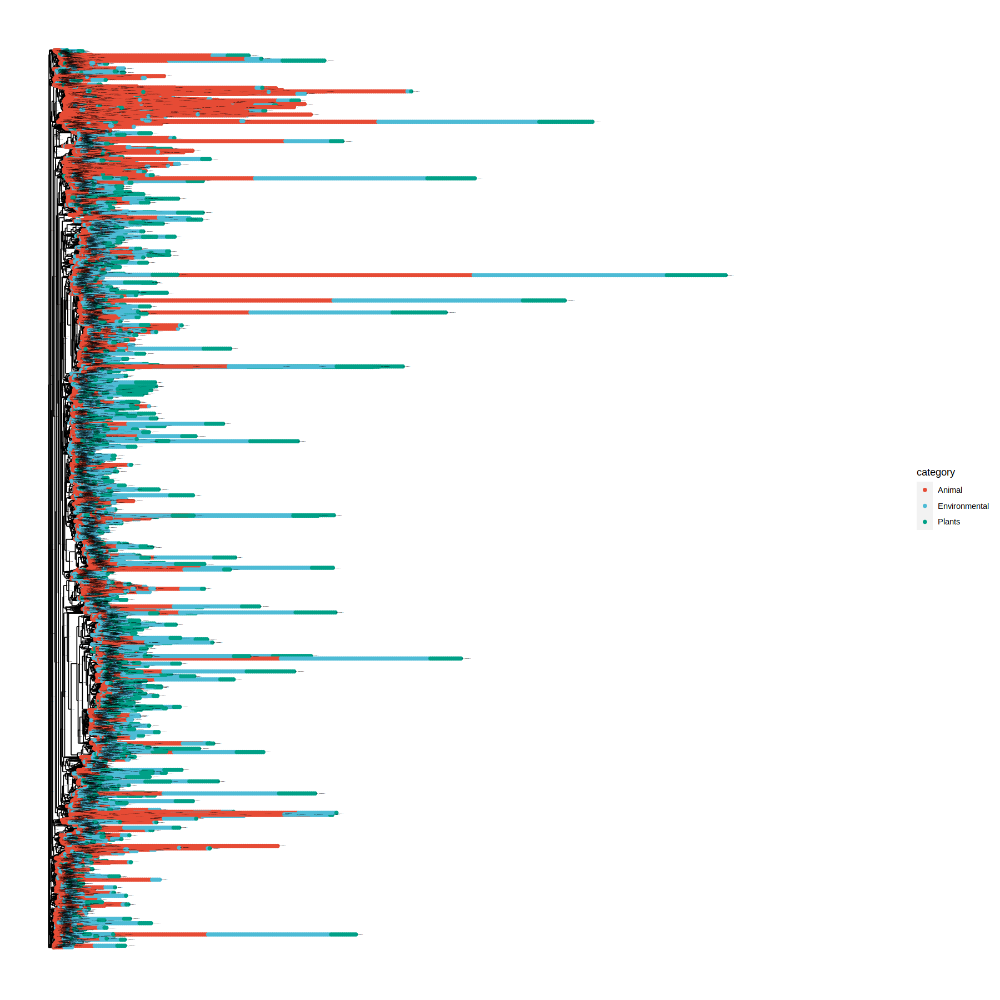

In [136]:
rare.tre

In [137]:
rare.tre.top.0.1=plot_tree(phyloseq_filter_top_taxa(rarefied.ps.All,perc=0.1),color="category",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 0.1%")

rare.tre.top.1=plot_tree(phyloseq_filter_top_taxa(rarefied.ps.All,perc=1),color="category",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 1%")

rare.tre.top.5=plot_tree(phyloseq_filter_top_taxa(rarefied.ps.All,perc=5),color="category",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 5%")

rare.tre.top.10=plot_tree(phyloseq_filter_top_taxa(rarefied.ps.All,perc=10),color="category",label.tips='Phylum')+scale_color_npg()+ggtitle("Top 10%")


Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plo

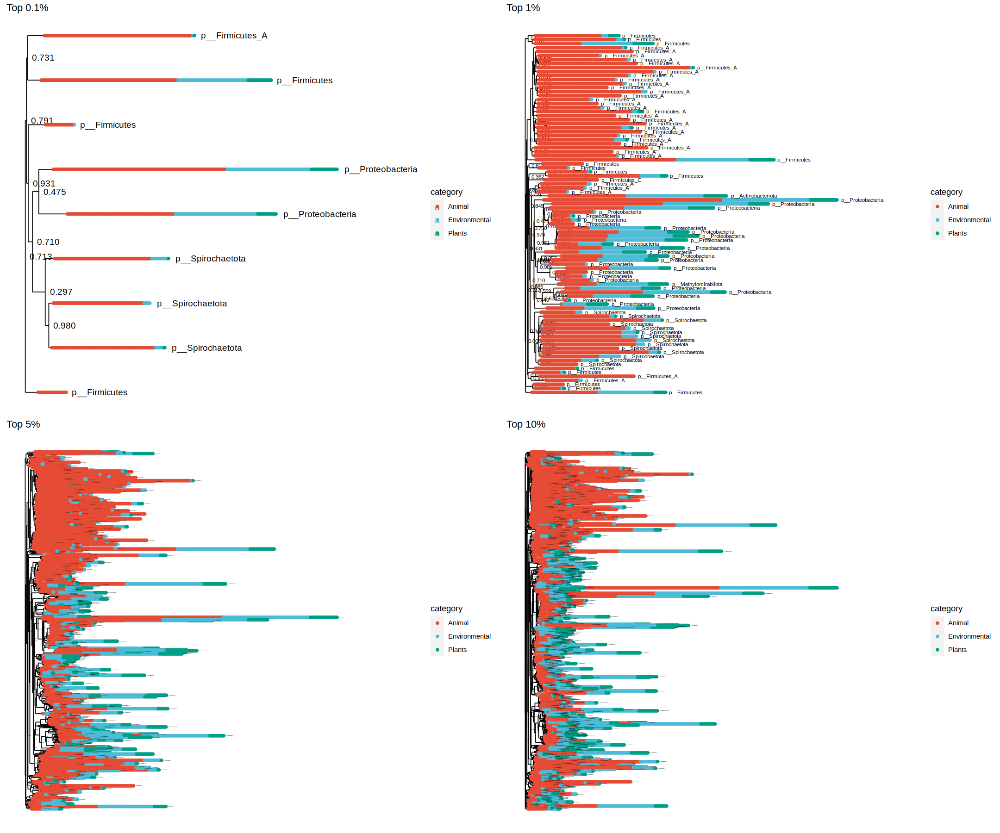

In [138]:
options(repr.plot.width=18,repr.plot.height=15)
grid.arrange(rare.tre.top.0.1,
             rare.tre.top.1,
             rare.tre.top.5,
             rare.tre.top.10,
             nrow=2)

## 6. Filtered by prevalence (and rarefied)

In [139]:
rarefied.psAll.filt=phyloseq_filter_prevalence(rarefied.ps.All, prev.trh = 0.05, abund.trh = NULL,
  threshold_condition = "OR", abund.type = "total")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [140]:
rarefied.psAll.filt

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 701 taxa and 396 samples ]
sample_data() Sample Data:       [ 396 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 701 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 701 tips and 700 internal nodes ]

### Composition plot

Top 50 and 100 taxa for next plot

In [141]:
top.100.filt.rare=phyloseq_filter_top_taxa(rarefied.psAll.filt,n=100)
top.30.filt.rare=phyloseq_filter_top_taxa(rarefied.psAll.filt,n=30)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [142]:
top.100.barplot=plot_bar(transform_sample_counts(top.100.filt.rare, function(x) (1E6 * x / sum(x))),
fill="Phylum")+
                         geom_bar(position="stack",stat="identity")+
                         facet_wrap(~biome_1,scales="free")+
                         theme_minimal()+
                         labels.legend+
                         theme(axis.text.x = element_blank())+
                         scale_fill_npg()

top.30.barplot=plot_bar(transform_sample_counts(top.30.filt.rare, function(x) (1E6 * x / sum(x))),
fill="Phylum")+
                         geom_bar(position="stack",stat="identity")+
                         facet_wrap(~biome_1,scales="free")+
                         theme_minimal()+
                         labels.legend+
                         theme(axis.text.x = element_blank())+
                         scale_fill_npg()

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" 

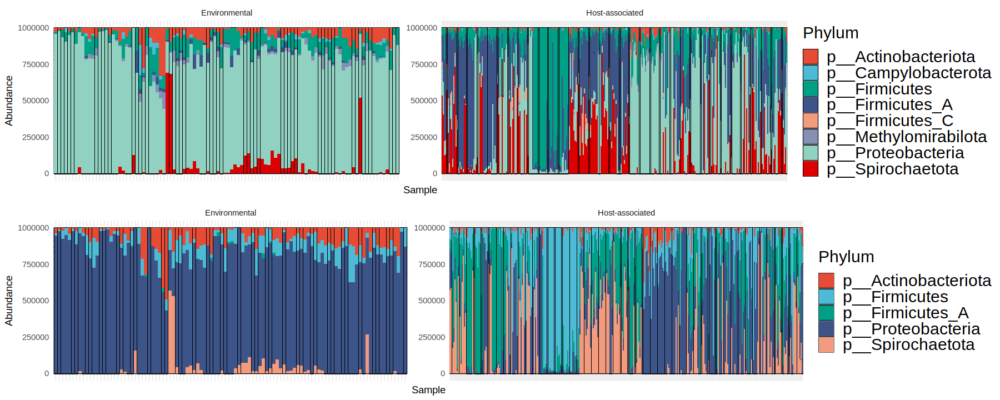

In [143]:
options(repr.plot.width=15,repr.plot.height=6)
grid.arrange(top.100.barplot,top.30.barplot,nrow=2)

### 6.1. Richness estimates

In [144]:
richness.estimates.rarefiedpsAll.filt=mutate(as_tibble(rarefied.psAll.filt@sam_data),estimate_richness(rarefied.psAll.filt, split = TRUE, measures = NULL))

In [145]:
head(richness.estimates.rarefiedpsAll.filt)

Sample,Dataset,biome_0,biome_1,biome_2,biome_3,biome_4,family,category,mammals,Observed,Chao1,se.chao1,ACE,se.ACE,Shannon,Simpson,InvSimpson,Fisher
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ERS1030529,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,55,78.00000,12.463640,83.62290,5.917188,3.119841,0.8780196,8.198037,25.40262
ERS1030531,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,55,70.40000,8.678156,70.87008,3.967929,3.225848,0.9057075,10.605293,25.77074
ERS1030532,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,54,73.71429,10.632268,80.36127,4.605854,2.946587,0.8480989,6.583232,22.78182
ERS1030534,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,53,80.00000,13.814332,94.74183,5.490244,3.188167,0.9132410,11.526181,24.37859
ERS1030535,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,56,67.05263,6.447576,78.08171,5.290733,3.393120,0.9317208,14.645756,26.87985
ERS1030536,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,52,73.66667,11.222479,91.80836,5.817371,2.429661,0.7181892,3.548480,20.67672


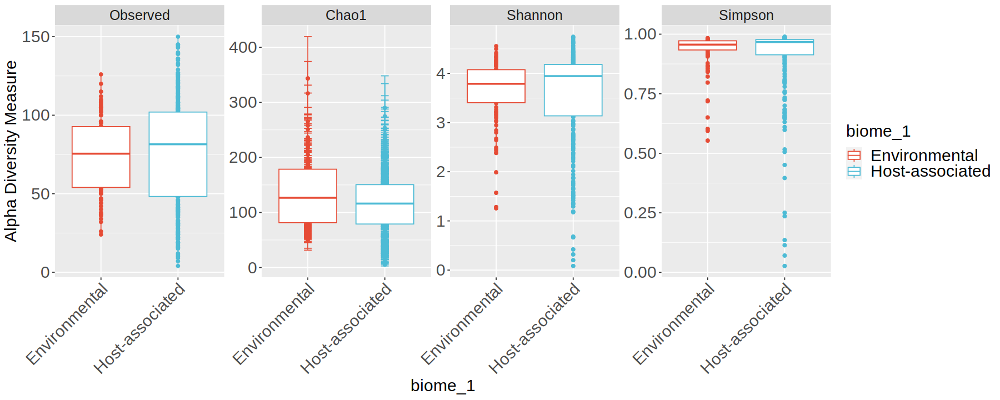

In [146]:
options(repr.plot.width=15,repr.plot.height=6)
plot_richness(rarefied.psAll.filt,x="biome_1",measures=c("Observed","Chao1","Shannon","Simpson"),color="biome_1")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

### Statistics on richness estimates

#### I. Kruskal tests by biome_1

In [147]:
kruskal.test(Observed~biome_1,data=richness.estimates.rarefiedpsAll.filt)


	Kruskal-Wallis rank sum test

data:  Observed by biome_1
Kruskal-Wallis chi-squared = 1.2032, df = 1, p-value = 0.2727


In [148]:
kruskal.test(Chao1~biome_1,data=richness.estimates.rarefiedpsAll.filt)


	Kruskal-Wallis rank sum test

data:  Chao1 by biome_1
Kruskal-Wallis chi-squared = 4.6139, df = 1, p-value = 0.03171


In [149]:
kruskal.test(Shannon~biome_1,data=richness.estimates.rarefiedpsAll.filt)


	Kruskal-Wallis rank sum test

data:  Shannon by biome_1
Kruskal-Wallis chi-squared = 0.42849, df = 1, p-value = 0.5127


In [150]:
kruskal.test(Simpson~biome_1,data=richness.estimates.rarefiedpsAll.filt)


	Kruskal-Wallis rank sum test

data:  Simpson by biome_1
Kruskal-Wallis chi-squared = 3.2985, df = 1, p-value = 0.06934


#### II. Kruskal tests by category

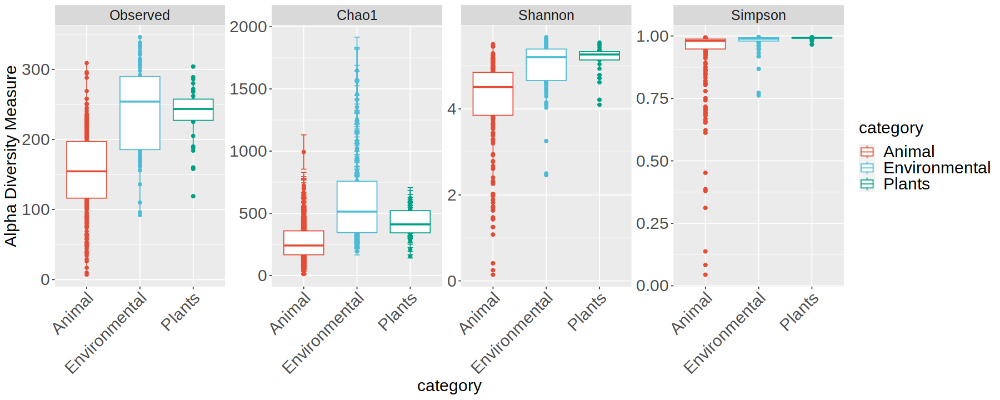

In [151]:
options(repr.plot.width=15,repr.plot.height=6)
plot_richness(rarefied.ps.All,x="category",measures=c("Observed","Chao1","Shannon","Simpson"),color="category")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

In [152]:
kruskal.test(Observed~category,data=richness.estimates.rarefiedpsAll.filt)


	Kruskal-Wallis rank sum test

data:  Observed by category
Kruskal-Wallis chi-squared = 1.7367, df = 2, p-value = 0.4196


In [153]:
kruskal.test(Chao1~category,data=richness.estimates.rarefiedpsAll.filt)


	Kruskal-Wallis rank sum test

data:  Chao1 by category
Kruskal-Wallis chi-squared = 4.7017, df = 2, p-value = 0.09529


In [154]:
kruskal.test(Shannon~category,data=richness.estimates.rarefiedpsAll.filt)


	Kruskal-Wallis rank sum test

data:  Shannon by category
Kruskal-Wallis chi-squared = 5.0784, df = 2, p-value = 0.07893


In [155]:
kruskal.test(Simpson~category,data=richness.estimates.rarefiedpsAll.filt)


	Kruskal-Wallis rank sum test

data:  Simpson by category
Kruskal-Wallis chi-squared = 14.2, df = 2, p-value = 0.0008252


#### III. Wilcoxon tests by category

In [156]:
pairwise.wilcox.test(richness.estimates.rarefiedpsAll.filt$Observed, richness.estimates.rarefiedpsAll.filt$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.rarefiedpsAll.filt$Observed and richness.estimates.rarefiedpsAll.filt$category 

              Animal Environmental
Environmental 0.62   -            
Plants        0.62   0.83         

P value adjustment method: fdr 

In [157]:
pairwise.wilcox.test(richness.estimates.rarefiedpsAll.filt$Chao1, richness.estimates.rarefiedpsAll.filt$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.rarefiedpsAll.filt$Chao1 and richness.estimates.rarefiedpsAll.filt$category 

              Animal Environmental
Environmental 0.12   -            
Plants        0.77   0.22         

P value adjustment method: fdr 

In [158]:
pairwise.wilcox.test(richness.estimates.rarefiedpsAll.filt$Shannon, richness.estimates.rarefiedpsAll.filt$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.rarefiedpsAll.filt$Shannon and richness.estimates.rarefiedpsAll.filt$category 

              Animal Environmental
Environmental 0.871  -            
Plants        0.077  0.025        

P value adjustment method: fdr 

In [159]:
pairwise.wilcox.test(richness.estimates.rarefiedpsAll.filt$Simpson, richness.estimates.rarefiedpsAll.filt$category, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.rarefiedpsAll.filt$Simpson and richness.estimates.rarefiedpsAll.filt$category 

              Animal Environmental
Environmental 0.2908 -            
Plants        0.0042 2.4e-05      

P value adjustment method: fdr 

### 6.2. Ordination plots

#### I. Ordination matrices

In [160]:
rare.filt.jaccard.ord=ordinate(rarefied.psAll.filt,distance="jaccard",method="PCoA")
rare.filt.unifrac.ord=ordinate(rarefied.psAll.filt,distance="unifrac",method="PCoA")

#### II. Ordination plots

By biome_1

In [161]:
rare.filt.jaccard.biome1=plot_ordination(physeq = rarefied.psAll.filt,rare.filt.jaccard.ord,type="samples",color="biome_1")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

rare.filt.unifrac.biome1=plot_ordination(physeq = rarefied.psAll.filt,rare.filt.unifrac.ord,type="samples",color="biome_1")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

By category

In [162]:
rare.filt.jaccard.category=plot_ordination(physeq = rarefied.psAll.filt,rare.filt.jaccard.ord,type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

rare.filt.unifrac.category=plot_ordination(physeq = rarefied.psAll.filt,rare.filt.unifrac.ord,type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

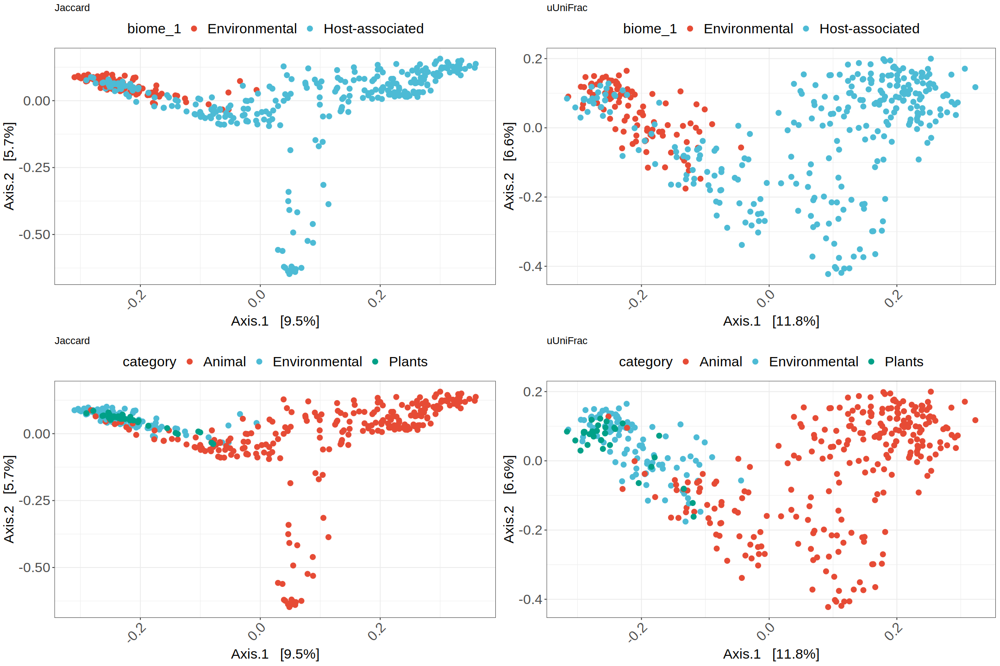

In [163]:
options(repr.plot.width=18,repr.plot.height=12)
grid.arrange(rare.filt.jaccard.biome1,
             rare.filt.unifrac.biome1,
             rare.filt.jaccard.category,
             rare.filt.unifrac.category,
             nrow=2)

### 6.3. Pairwise dissimilarities

Biome 1

In [164]:
rare.filt.diss.jacc1=phyloseq_group_dissimilarity(rarefied.psAll.filt,group="biome_1",method="jaccard",between_groups = TRUE)+
    ggtitle("Jaccard")+
    labels.x+ 
    labels.y + 
    labels.legend+
    theme(legend.position = "none")+
    scale_fill_npg()+
    theme(axis.text.x = element_text(angle=45))

rare.filt.diss.unifrac1=phyloseq_group_dissimilarity(rarefied.psAll.filt,group="biome_1",method="unifrac",between_groups = TRUE)+
    ggtitle("uUniFrac")+
    labels.x + 
    labels.y + 
    labels.legend+
    theme(legend.position = "none")+
    scale_fill_npg()+
    theme(axis.text.x = element_text(angle=45))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



Category

In [165]:
rare.filt.diss.jacc.cat=phyloseq_group_dissimilarity(rarefied.psAll.filt,group="category",method="jaccard",between_groups = TRUE)+
    ggtitle("Jaccard")+
    labels.x + 
    labels.y + 
    labels.legend+
    theme(legend.position = "none")+
    scale_fill_npg()+
    theme(axis.text.x = element_text(angle=45))

rare.filt.diss.unifrac.cat=phyloseq_group_dissimilarity(rarefied.psAll.filt,group="category",method="unifrac",between_groups = TRUE)+
    ggtitle("uUniFrac")+
    labels.x + 
    labels.y + 
    labels.legend+
    theme(legend.position = "none")+
    scale_fill_npg()+
    theme(axis.text.x = element_text(angle=45))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



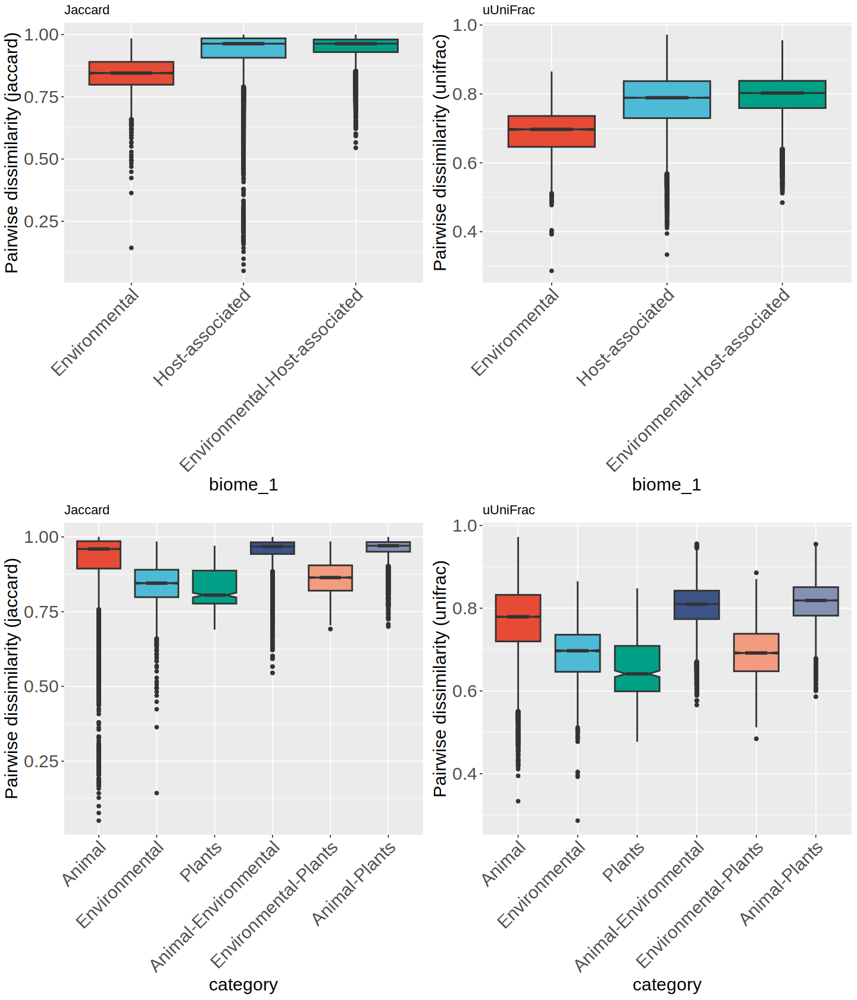

In [166]:
options(repr.plot.width=12,repr.plot.height=14)
grid.arrange(rare.filt.diss.jacc1,
             rare.filt.diss.unifrac1,
             rare.filt.diss.jacc.cat,
             rare.filt.diss.unifrac.cat,
             nrow=2)

### 6.4. OTU tree

In [167]:
rarefied.psAll.filt

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 701 taxa and 396 samples ]
sample_data() Sample Data:       [ 396 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 701 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 701 tips and 700 internal nodes ]

In [168]:
rare.filt.tre.top100=plot_tree(phyloseq_filter_top_taxa(rarefied.psAll.filt,n=100),color="Phylum",label.tips="biome_1")+scale_color_npg()

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [169]:
rare.filt.tre.perc.10=plot_tree(phyloseq_filter_top_taxa(rarefied.psAll.filt,perc=10),color="Phylum",label.tips='biome_1')+scale_color_npg()
rare.filt.tre.perc.15=plot_tree(phyloseq_filter_top_taxa(rarefied.psAll.filt,perc=15),color="Phylum",label.tips='biome_1')+scale_color_npg()
rare.filt.tre.perc.20=plot_tree(phyloseq_filter_top_taxa(rarefied.psAll.filt,perc=20),color="Phylum",label.tips='biome_1')+scale_color_npg()


Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plo

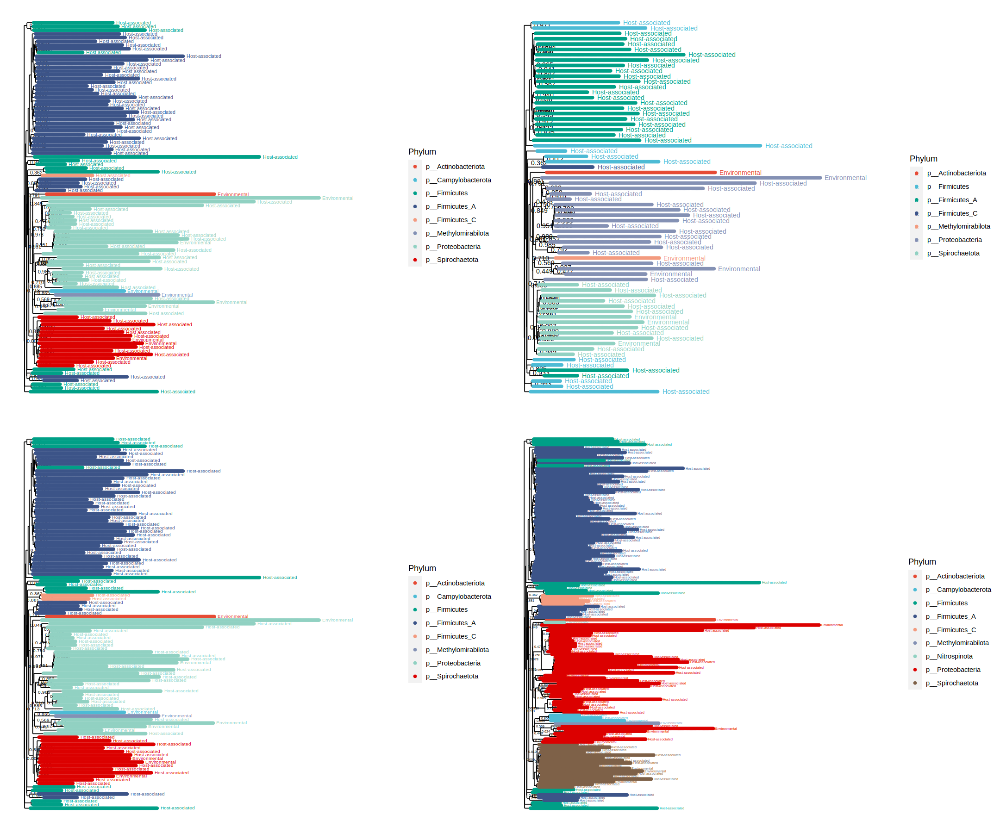

In [170]:
options(repr.plot.width=18,repr.plot.height=15)
grid.arrange(rare.filt.tre.top100,
             rare.filt.tre.perc.10,
             rare.filt.tre.perc.15,
             rare.filt.tre.perc.20,
             nrow=2)

In [171]:
rare.filt.tre.cat.perc.5=plot_tree(phyloseq_filter_top_taxa(rarefied.psAll.filt,perc=5),color="Phylum",label.tips='category')+scale_color_npg()
rare.filt.tre.cat.perc.10=plot_tree(phyloseq_filter_top_taxa(rarefied.psAll.filt,perc=10),color="Phylum",label.tips='category')+scale_color_npg()
rare.filt.tre.cat.perc.15=plot_tree(phyloseq_filter_top_taxa(rarefied.psAll.filt,perc=15),color="Phylum",label.tips='category')+scale_color_npg()
rare.filt.tre.cat.perc.20=plot_tree(phyloseq_filter_top_taxa(rarefied.psAll.filt,perc=20),color="Phylum",label.tips='category')+scale_color_npg()


Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plo

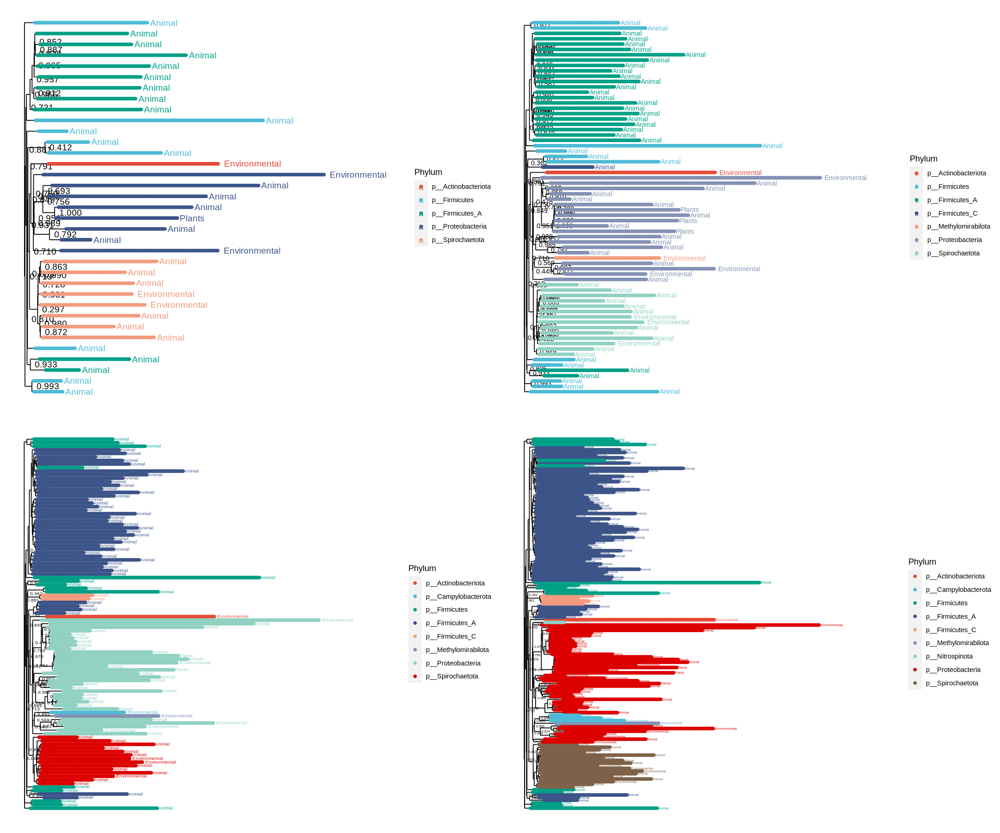

In [172]:
options(repr.plot.width=18,repr.plot.height=15)
grid.arrange(rare.filt.tre.cat.perc.5,
             rare.filt.tre.cat.perc.10,
             rare.filt.tre.cat.perc.15,
             rare.filt.tre.cat.perc.20,
             nrow=2)

## 7. Test- Rarefaction sampling depth=200

In [173]:
rarefied.ps.All.200=rarefy_even_depth(psAll_count, sample.size=200,
  rngseed = FALSE, replace = TRUE, trimOTUs = TRUE, verbose = TRUE)

You set `rngseed` to FALSE. Make sure you've set & recorded
 the random seed of your session for reproducibility.
See `?set.seed`


...

212 samples removedbecause they contained fewer reads than `sample.size`.

Up to first five removed samples are: 


ERS1286097ERS1286101ERS1286102ERS1286103ERS1286104

...

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

1550OTUs were removed because they are no longer 
present in any sample after random subsampling


...

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [174]:
count(as_tibble(rarefied.ps.All.200@sam_data),biome_1)

biome_1,n
<chr>,<int>
Environmental,118
Host-associated,462


In [175]:
tmp.host=subset_samples(rarefied.ps.All.200,biome_1=="Host-associated")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [176]:
head(tmp.host@sam_data)

,Sample,Dataset,biome_0,biome_1,biome_2,biome_3,biome_4,family,category,mammals
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
ERS1065340,ERS1065340,MGYS00000631,root,Host-associated,Mammalia,Digestive system,Stomach,Bovidae,Animal,Mammalia
ERS1065341,ERS1065341,MGYS00000631,root,Host-associated,Mammalia,Digestive system,Stomach,Bovidae,Animal,Mammalia
ERS1065342,ERS1065342,MGYS00000631,root,Host-associated,Mammalia,Digestive system,Stomach,Bovidae,Animal,Mammalia
ERS1353918,ERS1353918,MGYS00001254,root,Host-associated,Mammalia,Digestive system,Large intestine,Cricetidae,Animal,Mammalia
ERS1353919,ERS1353919,MGYS00001254,root,Host-associated,Mammalia,Digestive system,Large intestine,Cricetidae,Animal,Mammalia
ERS1353920,ERS1353920,MGYS00001254,root,Host-associated,Mammalia,Digestive system,Large intestine,Cricetidae,Animal,Mammalia


### Richness plots

In [177]:
richness.estimates=mutate(as_tibble(rarefied.ps.All.200@sam_data),estimate_richness(rarefied.ps.All.200, split = FALSE, measures = NULL))

In [178]:
head(richness.estimates)

Sample,Dataset,biome_0,biome_1,biome_2,biome_3,biome_4,family,category,mammals,Observed,Chao1,se.chao1,ACE,se.ACE,Shannon,Simpson,InvSimpson,Fisher
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ERS1030529,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,8413,9179.304,55.06366,9139.961,43.56511,7.587467,0.9956076,227.6637,2083.892
ERS1030531,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,8413,9179.304,55.06366,9139.961,43.56511,7.587467,0.9956076,227.6637,2083.892
ERS1030532,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,8413,9179.304,55.06366,9139.961,43.56511,7.587467,0.9956076,227.6637,2083.892
ERS1030533,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,8413,9179.304,55.06366,9139.961,43.56511,7.587467,0.9956076,227.6637,2083.892
ERS1030534,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,8413,9179.304,55.06366,9139.961,43.56511,7.587467,0.9956076,227.6637,2083.892
ERS1030535,MGYS00000599,root,Environmental,Aquatic,Freshwater,Ice,NA,Environmental,Others,8413,9179.304,55.06366,9139.961,43.56511,7.587467,0.9956076,227.6637,2083.892


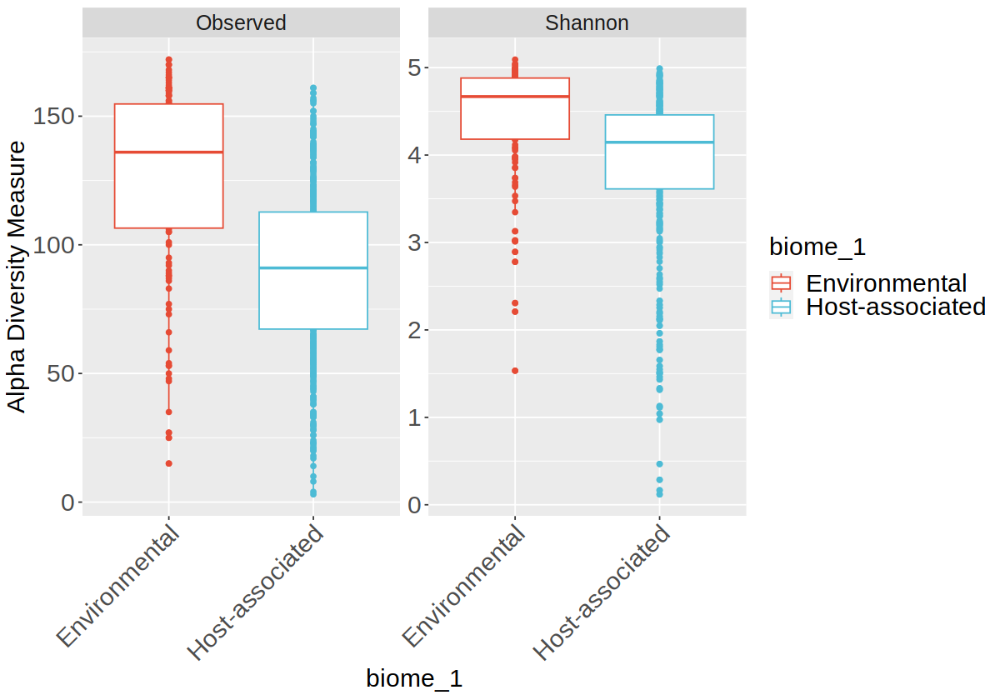

In [179]:
options(repr.plot.width=10,repr.plot.height=7)
plot_richness(rarefied.ps.All.200,x="biome_1",measures=c("Observed","Shannon"),color="biome_1")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

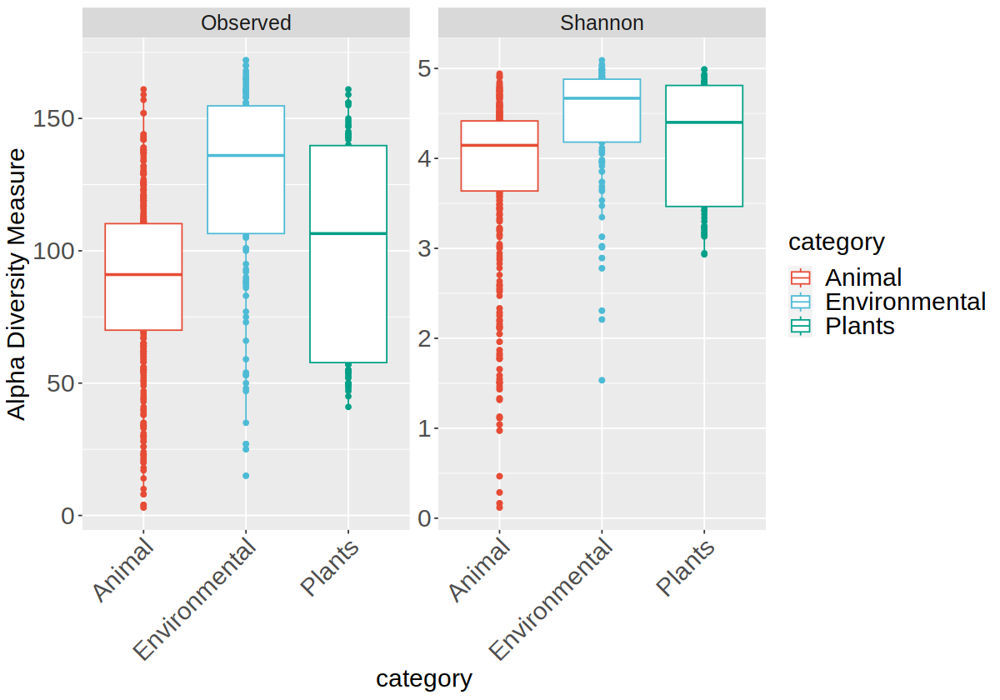

In [180]:
options(repr.plot.width=10,repr.plot.height=7)
plot_richness(rarefied.ps.All.200,x="category",measures=c("Observed","Shannon"),color="category")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

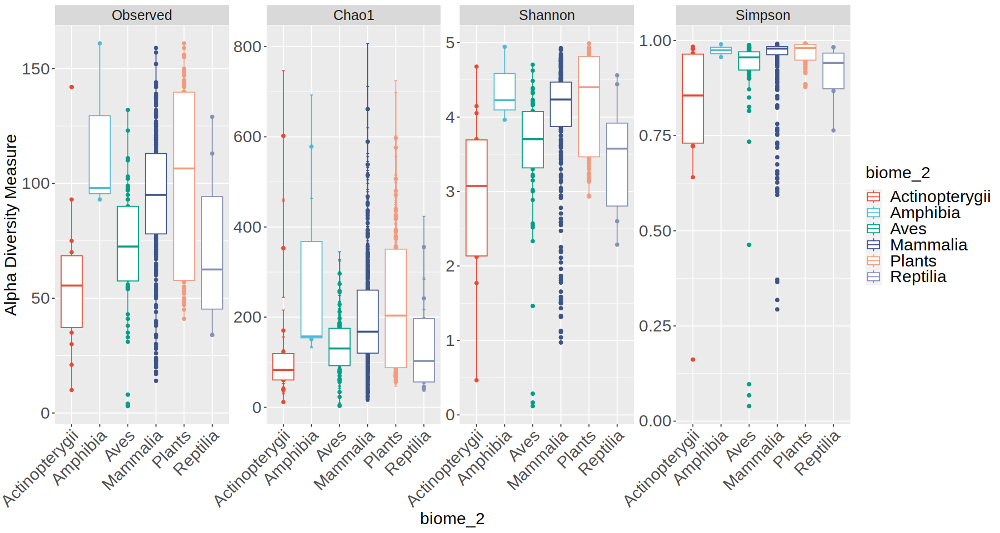

In [181]:
options(repr.plot.width=15,repr.plot.height=8)
plot_richness(tmp.host,x="biome_2",measures=c("Observed","Chao1","Shannon","Simpson"),color="biome_2")+
geom_boxplot()+
scale_color_npg()+#scale_color_manual(values=values.plot,breaks=breaks.plot)+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

### Beta diversity

#### Ordination matrices

In [182]:
jaccard.rare200 = ordinate(rarefied.ps.All.200,distance="jaccard",method="PCoA")
unifrac.rare200 = ordinate(rarefied.ps.All.200,distance="unifrac",method="PCoA")

Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- WP_092998267.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



#### Ordination plots

In [183]:
rare.filt.jaccard.host=plot_ordination(physeq = rarefied.ps.All.200,ordinate(rarefied.ps.All.200,distance="jaccard",method="PCoA"),type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

rare.filt.unifrac.host=plot_ordination(physeq = rarefied.ps.All.200,ordinate(rarefied.ps.All.200,distance="unifrac",method="PCoA"),type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend


Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- KWV91679.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



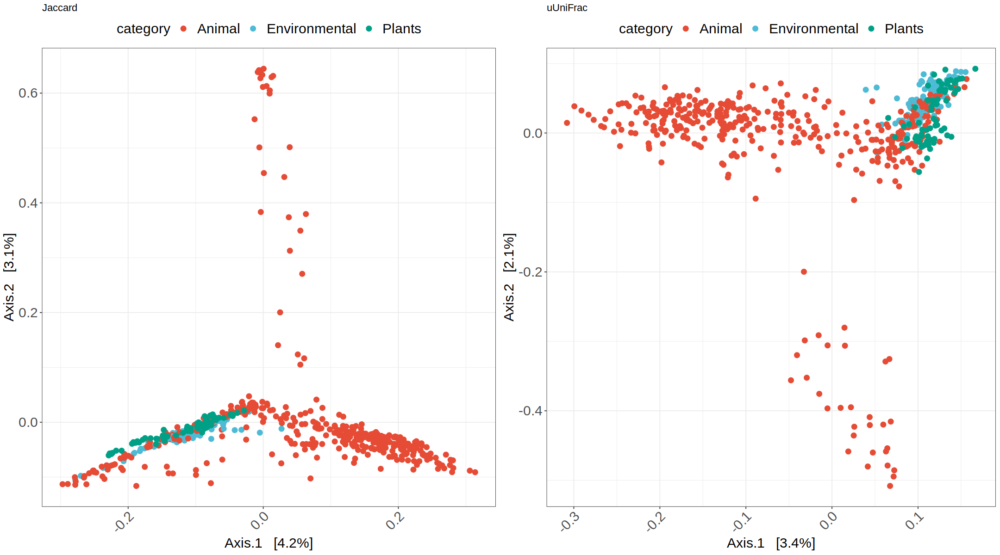

In [184]:
options(repr.plot.width=18,repr.plot.height=10)
grid.arrange(rare.filt.jaccard.host,rare.filt.unifrac.host,nrow=1)

In [185]:
tmp.jaccard.host=plot_ordination(physeq = tmp.host,ordinate(tmp.host,distance="jaccard",method="PCoA"),type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

tmp.unifrac.host=plot_ordination(physeq = tmp.host,ordinate(tmp.host,distance="unifrac",method="PCoA"),type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend


Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- EMT52255.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



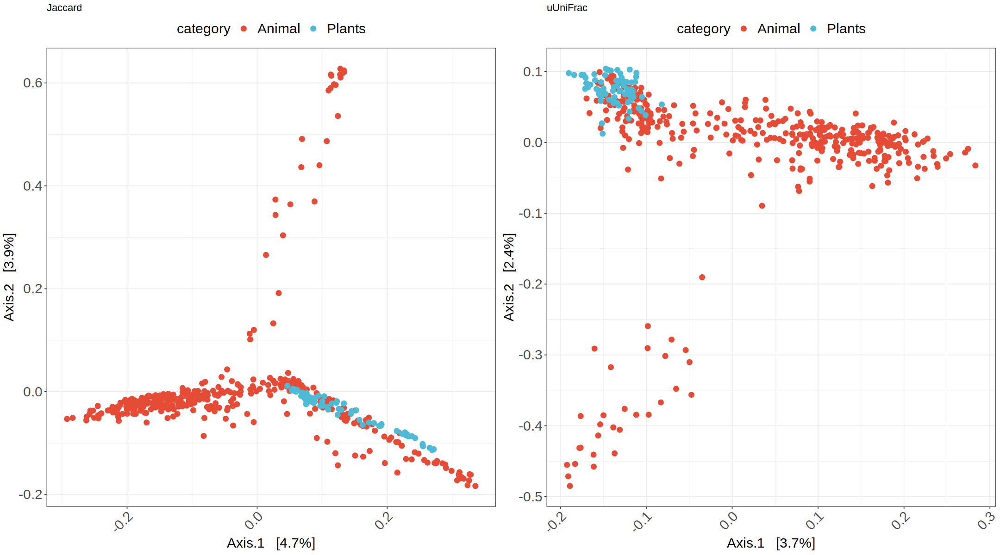

In [186]:
options(repr.plot.width=18,repr.plot.height=10)
grid.arrange(tmp.jaccard.host,tmp.unifrac.host,nrow=1)

In [187]:
tmp.jaccard.host2=plot_ordination(physeq = tmp.host,ordinate(tmp.host,distance="jaccard",method="PCoA"),type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

tmp.unifrac.host2=plot_ordination(physeq = tmp.host,ordinate(tmp.host,distance="unifrac",method="PCoA"),type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- WP_016216409.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



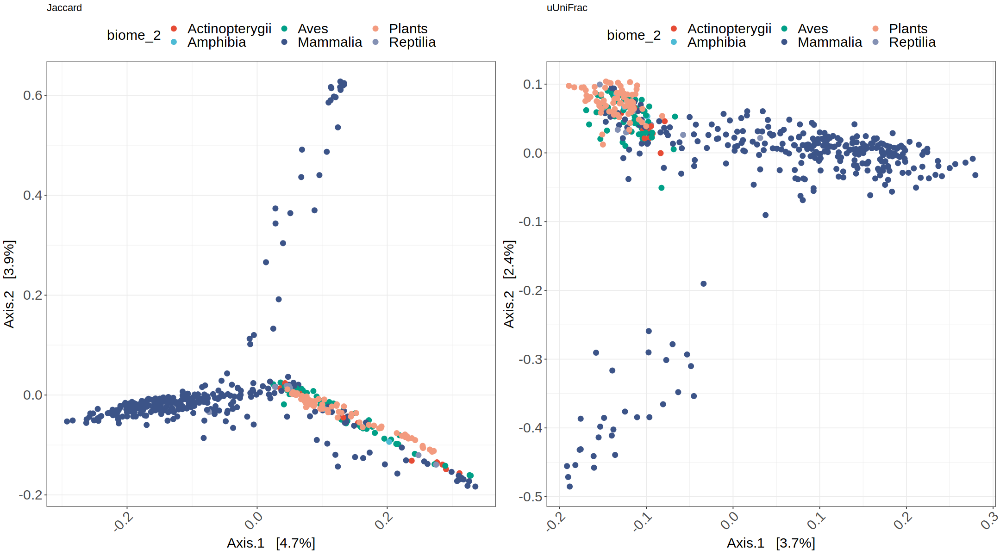

In [188]:
options(repr.plot.width=18,repr.plot.height=10)
grid.arrange(tmp.jaccard.host2,tmp.unifrac.host2,nrow=1)

In [189]:
tmp.host.diss.jacc1=phyloseq_group_dissimilarity(rarefied.ps.All.200,group="biome_1",method="jaccard",between_groups = TRUE)+ggtitle("Jaccard")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

tmp.host.diss.unifrac1=phyloseq_group_dissimilarity(rarefied.ps.All.200,group="biome_1",method="unifrac",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- WP_090129677.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first,

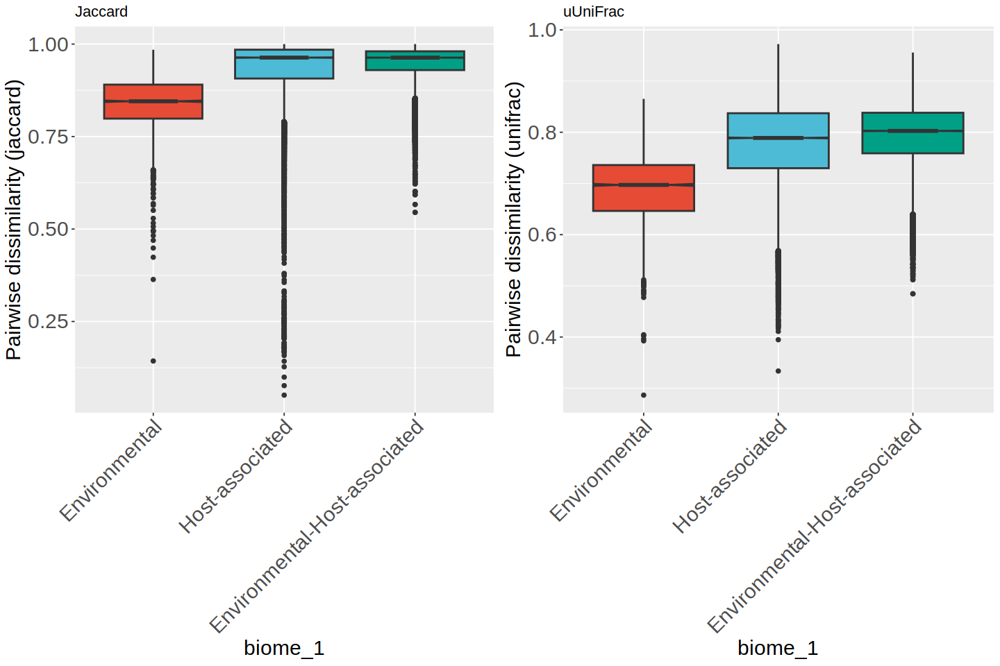

In [190]:
options(repr.plot.width=12,repr.plot.height=8)
grid.arrange(rare.filt.diss.jacc1,rare.filt.diss.unifrac1,nrow=1)

# Subset host-associated

In [191]:
to.filter.out=c("SRR10527383","SRR10527384","SRR10527385","SRR10527386","SRR10527387","SRR10527388","SRR10527390","SRR10527391","SRR10527392","SRR10527393","SRR10527394","SRR10527395","SRR10527396","SRR10527397","SRR10527389")

In [192]:
rarefied.ps.All

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9007 taxa and 396 samples ]
sample_data() Sample Data:       [ 396 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9007 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9007 tips and 8997 internal nodes ]

In [193]:
subset.host=subset_samples(rarefied.ps.All,biome_1=="Host-associated")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [194]:
subset.host

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9007 taxa and 294 samples ]
sample_data() Sample Data:       [ 294 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9007 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9007 tips and 8997 internal nodes ]

In [195]:
subset.host2 = subset_samples(subset.host, biome_2 != "Amphibia")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [196]:
subset.host2

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9007 taxa and 293 samples ]
sample_data() Sample Data:       [ 293 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9007 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9007 tips and 8997 internal nodes ]

## Richness plots

In [197]:
values.plot=c("#e64b35b2","#4dbbd5b2","#00a087b2","#3c5488b2","#f39b7fb2","#8491b4b2")#,"#91d1c2b2","#dc0000b2","#7e6148b2")
breaks.plot=c("Actinopterygii","Amphibia","Aves","Mammalia","Plants","Reptilia")

In [198]:
richness.estimates.host=mutate(as_tibble(subset.host2@sam_data),estimate_richness(subset.host2, split = TRUE, measures = NULL))

In [199]:
head(richness.estimates.host)

Sample,Dataset,biome_0,biome_1,biome_2,biome_3,biome_4,family,category,mammals,Observed,Chao1,se.chao1,ACE,se.ACE,Shannon,Simpson,InvSimpson,Fisher
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ERS1065340,MGYS00000631,root,Host-associated,Mammalia,Digestive system,Stomach,Bovidae,Animal,Mammalia,219,486.1842,64.08695,551.6919,15.517662,4.961617,0.9869430,76.58741,171.22785
ERS1065341,MGYS00000631,root,Host-associated,Mammalia,Digestive system,Stomach,Bovidae,Animal,Mammalia,234,663.3333,104.76903,663.0649,17.784352,5.093342,0.9903214,103.32075,200.25797
ERS1065342,MGYS00000631,root,Host-associated,Mammalia,Digestive system,Stomach,Bovidae,Animal,Mammalia,221,523.1667,72.47247,579.1834,15.154033,4.980271,0.9884039,86.23622,174.85194
ERS1353918,MGYS00001254,root,Host-associated,Mammalia,Digestive system,Large intestine,Cricetidae,Animal,Mammalia,153,292.8571,41.26079,323.7197,12.236100,4.096347,0.9372109,15.92632,82.58925
ERS1353919,MGYS00001254,root,Host-associated,Mammalia,Digestive system,Large intestine,Cricetidae,Animal,Mammalia,141,281.0455,44.68328,268.9078,9.592995,4.075478,0.9440792,17.88244,71.28127
ERS1353920,MGYS00001254,root,Host-associated,Mammalia,Digestive system,Large intestine,Cricetidae,Animal,Mammalia,160,317.5000,46.66082,321.7970,11.266990,4.468033,0.9765543,42.65167,89.73398


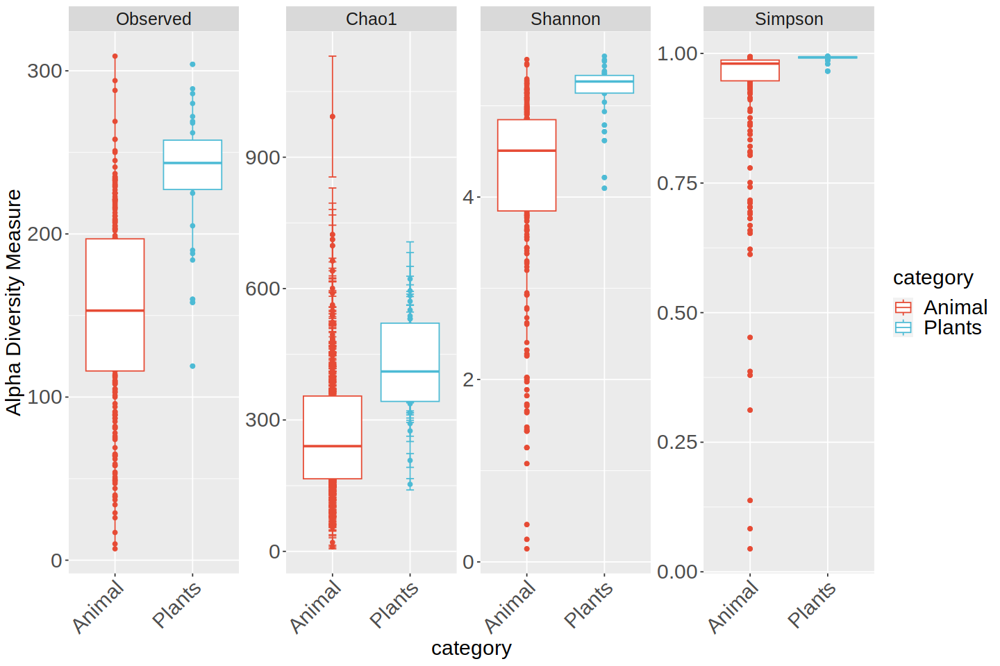

In [200]:
plot_richness(subset.host2,x="category",measures=c("Observed","Chao1","Shannon","Simpson"),color="category")+
geom_boxplot()+
scale_color_npg()+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

### Statistics on richness estimates

#### I. Kruskal tests by category

In [201]:
kruskal.test(Observed~category,data=richness.estimates.host)


	Kruskal-Wallis rank sum test

data:  Observed by category
Kruskal-Wallis chi-squared = 51.322, df = 1, p-value = 7.841e-13


In [202]:
kruskal.test(Chao1~category,data=richness.estimates.host)


	Kruskal-Wallis rank sum test

data:  Chao1 by category
Kruskal-Wallis chi-squared = 31.133, df = 1, p-value = 2.409e-08


In [203]:
kruskal.test(Shannon~category,data=richness.estimates.host)


	Kruskal-Wallis rank sum test

data:  Shannon by category
Kruskal-Wallis chi-squared = 53.704, df = 1, p-value = 2.33e-13


In [204]:
kruskal.test(Simpson~category,data=richness.estimates.host)


	Kruskal-Wallis rank sum test

data:  Simpson by category
Kruskal-Wallis chi-squared = 53.672, df = 1, p-value = 2.369e-13


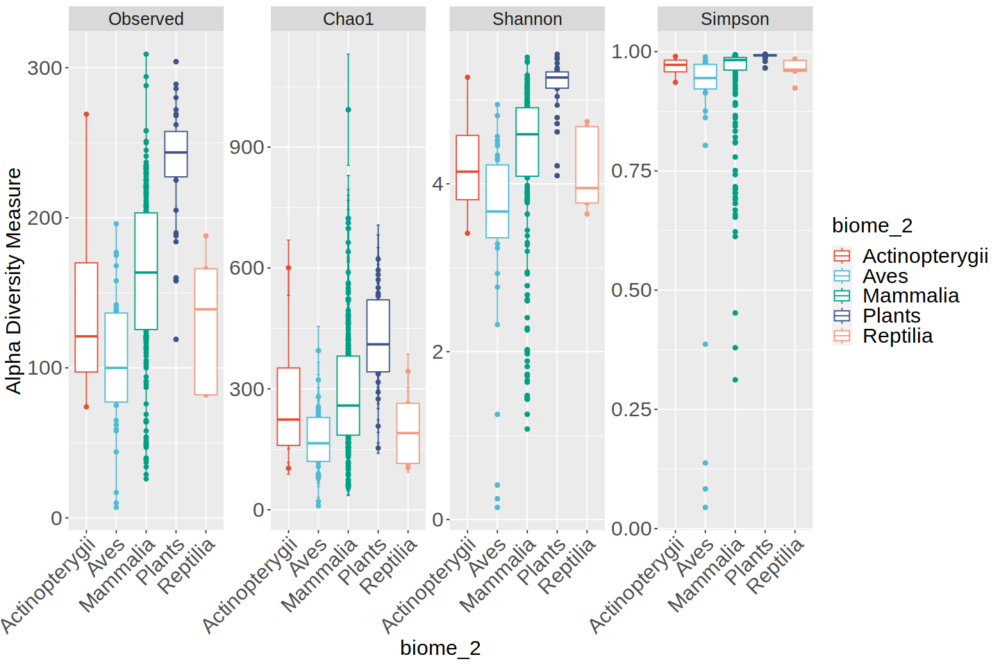

In [205]:
plot_richness(subset.host2,x="biome_2",measures=c("Observed","Chao1","Shannon","Simpson"),color="biome_2")+
geom_boxplot()+
scale_color_npg()+#scale_color_manual(values=values.plot,breaks=breaks.plot)+
labels.x+labels.y+labels.legend+
theme(strip.text=element_text(size=15))

#### II. Kruskal test by biome_2

In [206]:
dplyr::count(richness.estimates.host,biome_2)

biome_2,n
<chr>,<int>
Actinopterygii,4
Aves,36
Mammalia,216
Plants,32
Reptilia,5


In [207]:
kruskal.test(Observed~biome_2,data=richness.estimates.host)


	Kruskal-Wallis rank sum test

data:  Observed by biome_2
Kruskal-Wallis chi-squared = 79.115, df = 4, p-value = 2.682e-16


In [208]:
kruskal.test(Chao1~biome_2,data=richness.estimates.host)


	Kruskal-Wallis rank sum test

data:  Chao1 by biome_2
Kruskal-Wallis chi-squared = 56.167, df = 4, p-value = 1.85e-11


In [209]:
kruskal.test(Shannon~biome_2,data=richness.estimates.host)


	Kruskal-Wallis rank sum test

data:  Shannon by biome_2
Kruskal-Wallis chi-squared = 79.527, df = 4, p-value < 2.2e-16


In [210]:
kruskal.test(Simpson~biome_2,data=richness.estimates.host)


	Kruskal-Wallis rank sum test

data:  Simpson by biome_2
Kruskal-Wallis chi-squared = 76.176, df = 4, p-value = 1.124e-15


#### II. Wilcoxon test by biome_2

In [211]:
pairwise.wilcox.test(richness.estimates.host$Observed, richness.estimates.host$biome_2, p.adjust.method="fdr")

Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”
Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”
Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”
Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”
Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”
Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”



	Pairwise comparisons using Wilcoxon rank sum test with continuity correction 

data:  richness.estimates.host$Observed and richness.estimates.host$biome_2 

         Actinopterygii Aves    Mammalia Plants
Aves     0.494          -       -        -     
Mammalia 0.494          7.3e-08 -        -     
Plants   0.140          6.4e-11 6.4e-11  -     
Reptilia 0.902          0.360   0.360    0.004 

P value adjustment method: fdr 

In [212]:
pairwise.wilcox.test(richness.estimates.host$Chao1, richness.estimates.host$biome_2, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum exact test 

data:  richness.estimates.host$Chao1 and richness.estimates.host$biome_2 

         Actinopterygii Aves    Mammalia Plants
Aves     0.3209         -       -        -     
Mammalia 0.7785         1.9e-06 -        -     
Plants   0.2840         4.3e-13 1.9e-06  -     
Reptilia 0.9048         0.6529  0.2906   0.0023

P value adjustment method: fdr 

In [213]:
pairwise.wilcox.test(richness.estimates.host$Shannon, richness.estimates.host$biome_2, p.adjust.method="fdr")


	Pairwise comparisons using Wilcoxon rank sum exact test 

data:  richness.estimates.host$Shannon and richness.estimates.host$biome_2 

         Actinopterygii Aves    Mammalia Plants 
Aves     0.30326        -       -        -      
Mammalia 0.65234        2.5e-07 -        -      
Plants   0.04135        1.5e-14 1.3e-11  -      
Reptilia 1.00000        0.21326 0.30326  0.00048

P value adjustment method: fdr 

In [214]:
pairwise.wilcox.test(richness.estimates.host$Simpson, richness.estimates.host$biome_2, p.adjust.method="fdr")

Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”
Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”
Warning message in wilcox.test.default(xi, xj, paired = paired, ...):
“cannot compute exact p-value with ties”



	Pairwise comparisons using Wilcoxon rank sum exact test 

data:  richness.estimates.host$Simpson and richness.estimates.host$biome_2 

         Actinopterygii Aves    Mammalia Plants
Aves     0.1687         -       -        -     
Mammalia 0.6830         2.1e-06 -        -     
Plants   0.0104         9.4e-11 3.4e-11  -     
Reptilia 0.7302         0.3147  0.3147   0.0027

P value adjustment method: fdr 

## Beta diversity

### 1. Ordination

In [215]:
ordination.host.jacc=ordinate(subset.host2,distance="jaccard",method="PCoA")
ordination.host.unifrac=ordinate(subset.host2,distance="unifrac",method="PCoA")

Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- WP_054143702.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



### 2. Plots

By category

In [216]:
plot.host.jaccard.cat=plot_ordination(physeq = subset.host2,ordination.host.jacc,type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

plot.host.unifrac.cat=plot_ordination(physeq = subset.host2,ordination.host.unifrac,type="samples",color="category")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

By biome_2

In [217]:
plot.host.jaccard=plot_ordination(physeq = subset.host2,ordination.host.jacc,type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("Jaccard")+labels.x + labels.y + labels.legend

plot.host.unifrac=plot_ordination(physeq = subset.host2,ordination.host.unifrac,type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

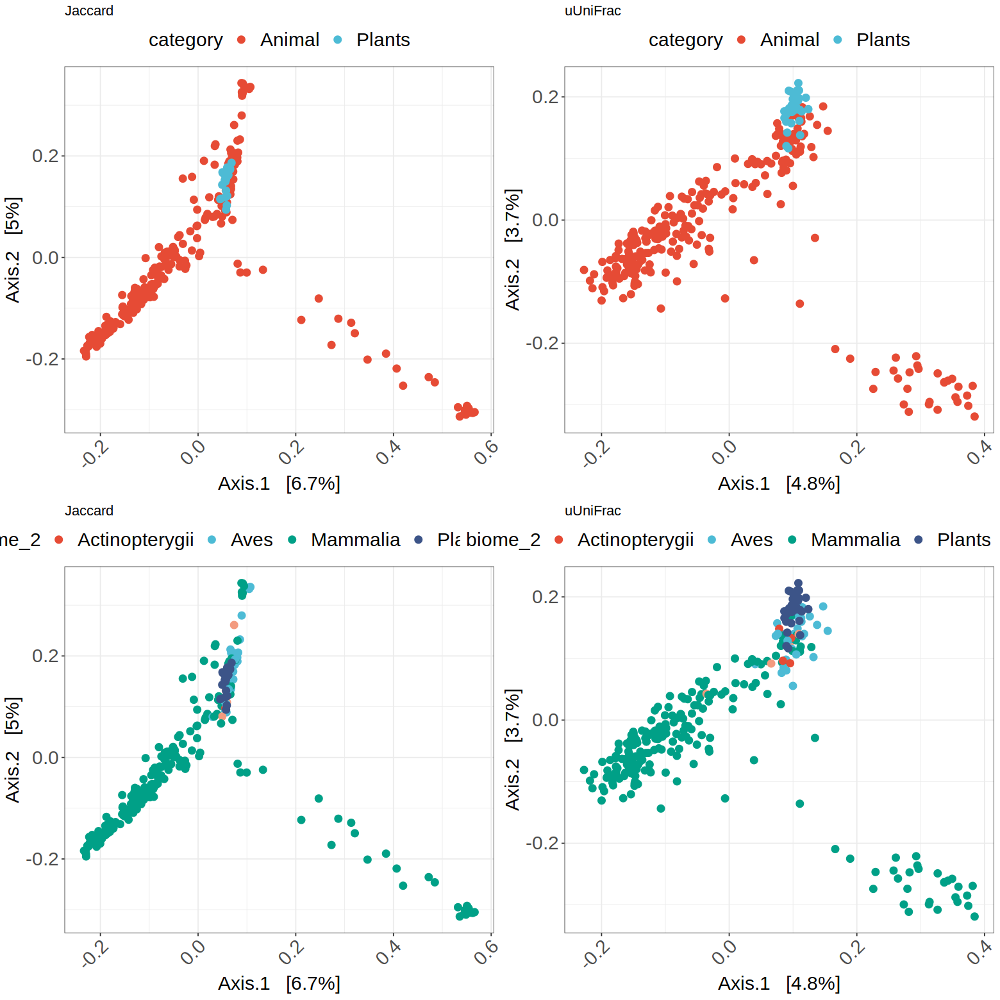

In [218]:
options(repr.plot.width=13,repr.plot.height=13)
grid.arrange(plot.host.jaccard.cat,
             plot.host.unifrac.cat,
             plot.host.jaccard,
             plot.host.unifrac,
             nrow=2)

### 3. Pairwise dissimilarity

By category

In [219]:
host.diss.jacc1=phyloseq_group_dissimilarity(subset.host2,group="category",method="jaccard",between_groups = TRUE)+ggtitle("Jaccard")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

host.diss.unifrac1=phyloseq_group_dissimilarity(subset.host2,group="category",method="unifrac",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in UniFrac(physeq, ...):
“Randomly assigning root as -- OFZ81854.1 -- in the phylogenetic tree in the data you provided.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, fro

By biome_2

In [220]:
host.diss.jacc2=phyloseq_group_dissimilarity(subset.host2,group="biome_2",method="jaccard",between_groups = TRUE)+ggtitle("Jaccard")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

host.diss.unifrac2=phyloseq_group_dissimilarity(subset.host2,group="biome_2",method="unifrac",between_groups = TRUE)+ggtitle("uUniFrac")+labels.x + labels.y + labels.legend+
theme(legend.position = "none")+scale_fill_npg()+theme(axis.text.x = element_text(angle=45))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'



Warning message:
“This manual palette can handle a maximum of 10 values. You have supplied 15.”
Notch went outside hinges
ℹ Do you want `notch = FALSE`?
Notch went outside hinges
ℹ Do you want `notch = FALSE`?
Notch went outside hinges
ℹ Do you want `notch = FALSE`?
Warning message:
“This manual palette can handle a maximum of 10 values. You have supplied 15.”
Notch went outside hinges
ℹ Do you want `notch = FALSE`?
Notch went outside hinges
ℹ Do you want `notch = FALSE`?


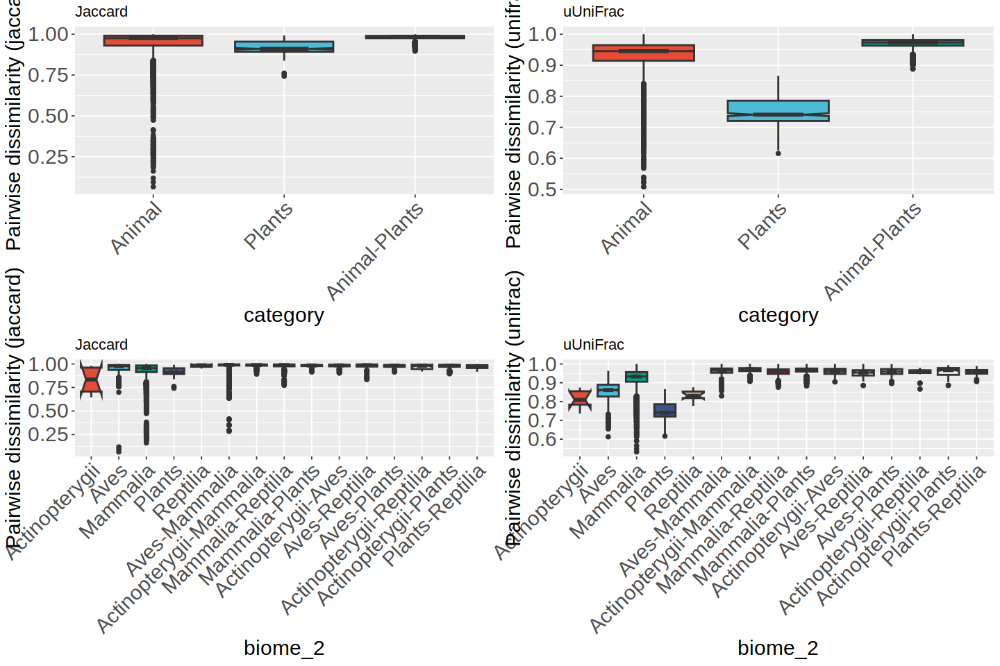

In [221]:
options(repr.plot.width=12,repr.plot.height=8)
grid.arrange(host.diss.jacc1,
             host.diss.unifrac1,
             host.diss.jacc2,
             host.diss.unifrac2,
             nrow=2)

In [222]:
subset.host2.no.mammals = subset_samples(subset.host2,biome_2!="Mammalia")
subset.host2.no.mammals=subset_samples(subset.host2.no.mammals,biome_1=="Host-associated")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [223]:
subset.host2.no.mammals

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9007 taxa and 77 samples ]
sample_data() Sample Data:       [ 77 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9007 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9007 tips and 8997 internal nodes ]

In [224]:
unifrac.host2.non.mammals=plot_ordination(physeq = subset.host2.no.mammals,ordinate(subset.host2.no.mammals,distance="jaccard",method="PCoA"),type="samples",color="biome_2")+
  theme_bw()+
  geom_point(size=3)+
  scale_color_npg()+
  theme(legend.position = "top")+
  ggtitle("uUniFrac")+labels.x + labels.y + labels.legend

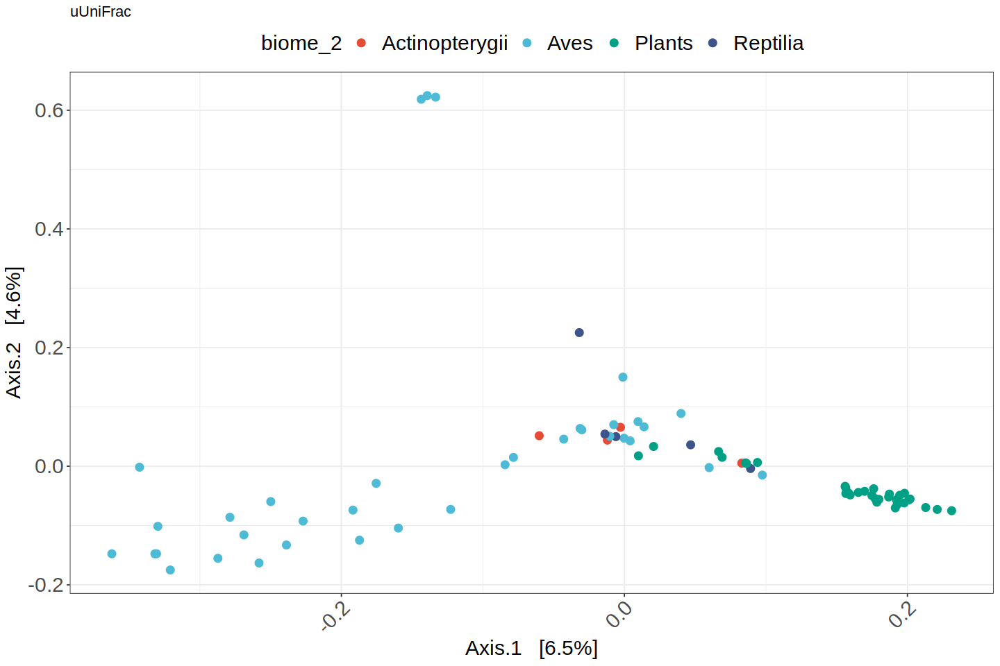

In [225]:
unifrac.host2.non.mammals

In [226]:
host.tre.top=plot_tree(phyloseq_filter_top_taxa(subset.host,perc=10),color="biome_2",label.tips="family")+scale_color_npg()

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



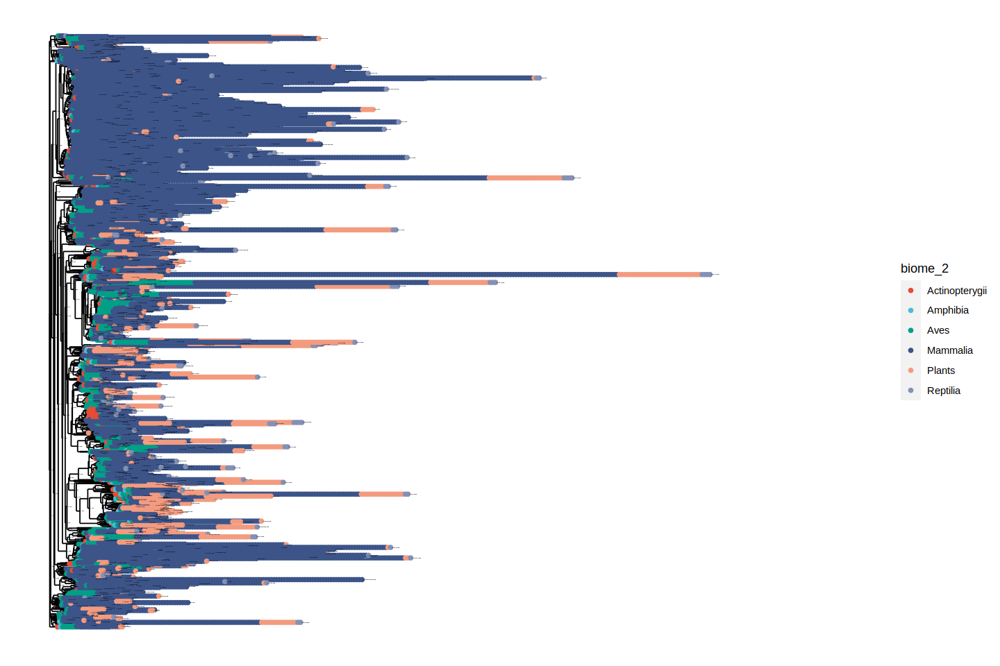

In [227]:
host.tre.top

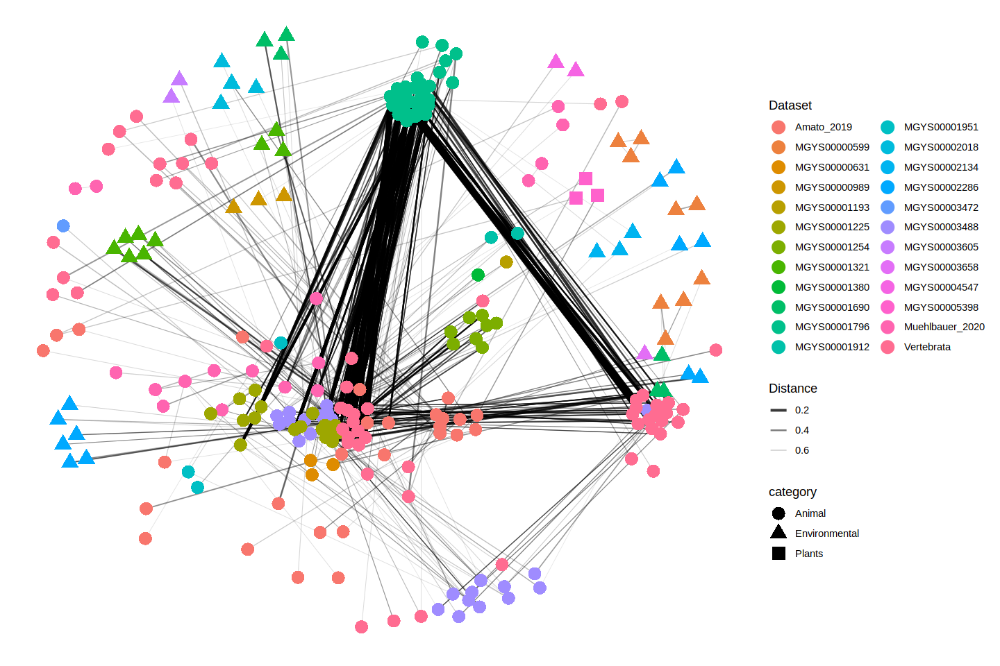

In [228]:
plot_net(rarefied.ps.All, maxdist=0.7, color="Dataset", shape="category")

## Bootstrap the phyloseq object

#### Define bootstrapping function

In [229]:
ps_boot = function (ps_object=ps){
    ps_ids=sample_names(ps_object)
    boot_ids <- sample(ps_ids, size = length(ps_ids), replace = FALSE)
    boot_df <- data.frame(seq_id = boot_ids)
    
  meta_df <- data.frame(sample_data(ps_object)) %>%
    rownames_to_column(var = "seq_id")
  
  join_df <- left_join(boot_df, meta_df)
  
  
  otu_df <- data.frame(t(otu_table(ps_object))) %>%
    rownames_to_column(var = "seq_id")
  
  join_otu <- left_join(boot_df, otu_df)
  
  
  join_df <- join_df %>%
    mutate(boot_id = paste("S", row_number(), sep = "")) %>%
    dplyr::select(-seq_id) %>%
    column_to_rownames(var = "boot_id")
  
  join_otu <- join_otu %>%
    mutate(boot_id = paste("S", row_number(), sep = "")) %>%
    dplyr::select(-seq_id) %>%
    column_to_rownames(var = "boot_id") %>%
    t() %>%
    data.frame()
  
  boot_ps <- phyloseq(sample_data(join_df),
                      otu_table(join_otu, taxa_are_rows = TRUE))
  
  return(boot_ps)
  
}

#### Boostrap phyloseq object

In [230]:
boot.ps.rarefied.All=ps_boot(rarefied.psAll.filt)

Joining, by = "seq_id"
Joining, by = "seq_id"


In [231]:
boot.ps.rarefied.All = phyloseq(boot.ps.rarefied.All@otu_table,boot.ps.rarefied.All@sam_data,rarefied.ps.All@tax_table,rarefied.ps.All@phy_tree)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [232]:
boot.ps.rarefied.All

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 701 taxa and 396 samples ]
sample_data() Sample Data:       [ 396 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 701 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 701 tips and 700 internal nodes ]

# 8. Enrichment analysis

In [233]:
library(edgeR)

Loading required package: limma



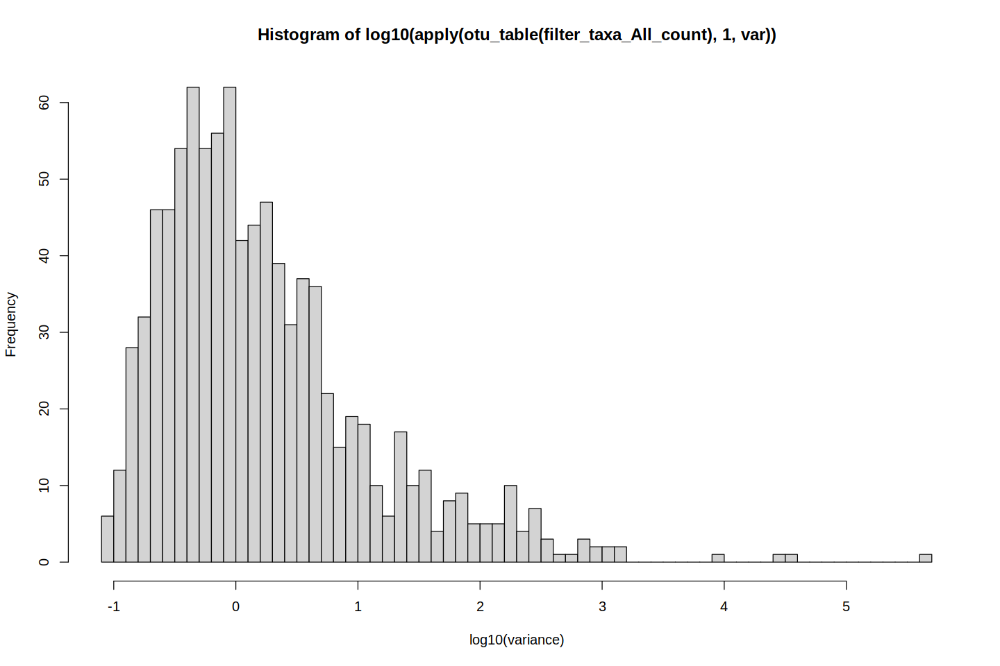

In [236]:
# #relative abundances
hist(log10(apply(otu_table(filter_taxa_All_count), 1, var)),
     xlab="log10(variance)",breaks=50)#,
     #main="A large fraction of OTUs have very low variance")

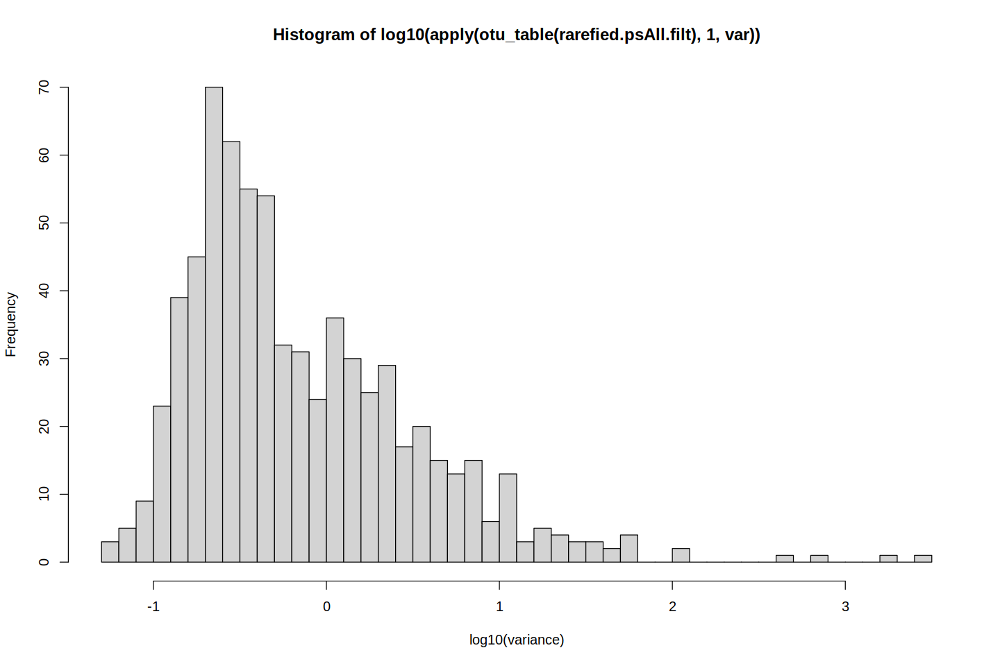

In [237]:
# #relative abundances
hist(log10(apply(otu_table(rarefied.psAll.filt), 1, var)),
     xlab="log10(variance)",breaks=50)#,
     #main="A large fraction of OTUs have very low variance")

In [238]:
################################################################################
#' Convert phyloseq OTU count data into DGEList for edgeR package
#' 
#' Further details.
#' 
#' @param physeq (Required).  A \code{\link{phyloseq-class}} or
#'  an \code{\link{otu_table-class}} object. 
#'  The latter is only appropriate if \code{group} argument is also a 
#'  vector or factor with length equal to \code{nsamples(physeq)}.
#'  
#' @param group (Required). A character vector or factor giving the experimental
#'  group/condition for each sample/library. Alternatively, you may provide
#'  the name of a sample variable. This name should be among the output of
#'  \code{sample_variables(physeq)}, in which case
#'  \code{get_variable(physeq, group)} would return either a character vector or factor.
#'  This is passed on to \code{\link[edgeR]{DGEList}},
#'  and you may find further details or examples in its documentation.
#'  
#' @param method (Optional). The label of the edgeR-implemented normalization to use.
#'  See \code{\link[edgeR]{calcNormFactors}} for supported options and details. 
#'  The default option is \code{"RLE"}, which is a scaling factor method 
#'  proposed by Anders and Huber (2010).
#'  At time of writing, the \link[edgeR]{edgeR} package supported 
#'  the following options to the \code{method} argument:
#'  
#'  \code{c("TMM", "RLE", "upperquartile", "none")}.
#'
#' @param ... Additional arguments passed on to \code{\link[edgeR]{DGEList}}
#' 
#' @examples
#' 
phyloseq_to_edgeR = function(physeq, group, method="RLE", ...){
  require("edgeR")
  require("phyloseq")
  # Enforce orientation.
  if( !taxa_are_rows(physeq) ){ physeq <- t(physeq) }
  x = as(otu_table(physeq), "matrix")
  # Add one to protect against overflow, log(0) issues.
  x = x + 1
  # Check `group` argument
  if( identical(all.equal(length(group), 1), TRUE) & nsamples(physeq) > 1 ){
    # Assume that group was a sample variable name (must be categorical)
    group = get_variable(physeq, group)
  }
  # Define gene annotations (`genes`) as tax_table
  taxonomy = tax_table(physeq, errorIfNULL=FALSE)
  if( !is.null(taxonomy) ){
    taxonomy = data.frame(as(taxonomy, "matrix"))
  } 
  # Now turn into a DGEList
  y = DGEList(counts=x, group=group, genes=taxonomy, remove.zeros = TRUE, ...)
  # Calculate the normalization factors
  z = calcNormFactors(y, method=method)
  # Check for division by zero inside `calcNormFactors`
  if( !all(is.finite(z$samples$norm.factors)) ){
    stop("Something wrong with edgeR::calcNormFactors on this data,
         non-finite $norm.factors, consider changing `method` argument")
  }
  # Estimate dispersions
  return(estimateTagwiseDisp(estimateCommonDisp(z)))
}
################################################################################

## EdgeR plants vs. animals

### I. Rarefied and filtered by prevalence and abundance

In [239]:
#mmult.rare.psAll <- phyloseq_mult_raref(psAll_count, replace = T, SampSize = 462, iter = 100)

In [240]:
subset.host #rarefied and filtered object

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9007 taxa and 294 samples ]
sample_data() Sample Data:       [ 294 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9007 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9007 tips and 8997 internal nodes ]

#### OTU trees in animal/mammal samples

In [241]:
animal.subset=ps_filter(subset.host,category=="Animal")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [242]:
mammals.subset=ps_filter(animal.subset,biome_2=="Mammalia")

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [243]:
firm.mammals=plot_tree(subset_taxa(mammals.subset,Phylum==c("p__Firmicutes_A","p__Firmicutes_C","p__Firmicutes")),color="family",label.tips="Family",ladderize="left")+scale_color_viridis_d()

Warning message in Phylum == c("p__Firmicutes_A", "p__Firmicutes_C", "p__Firmicutes"):
“longer object length is not a multiple of shorter object length”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeX

In [244]:
spiro.mammals=plot_tree(subset_taxa(mammals.subset,Phylum=="p__Spirochaetota"),color="family",label.tips="Family",ladderize="left")+scale_color_viridis_d()


Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" 

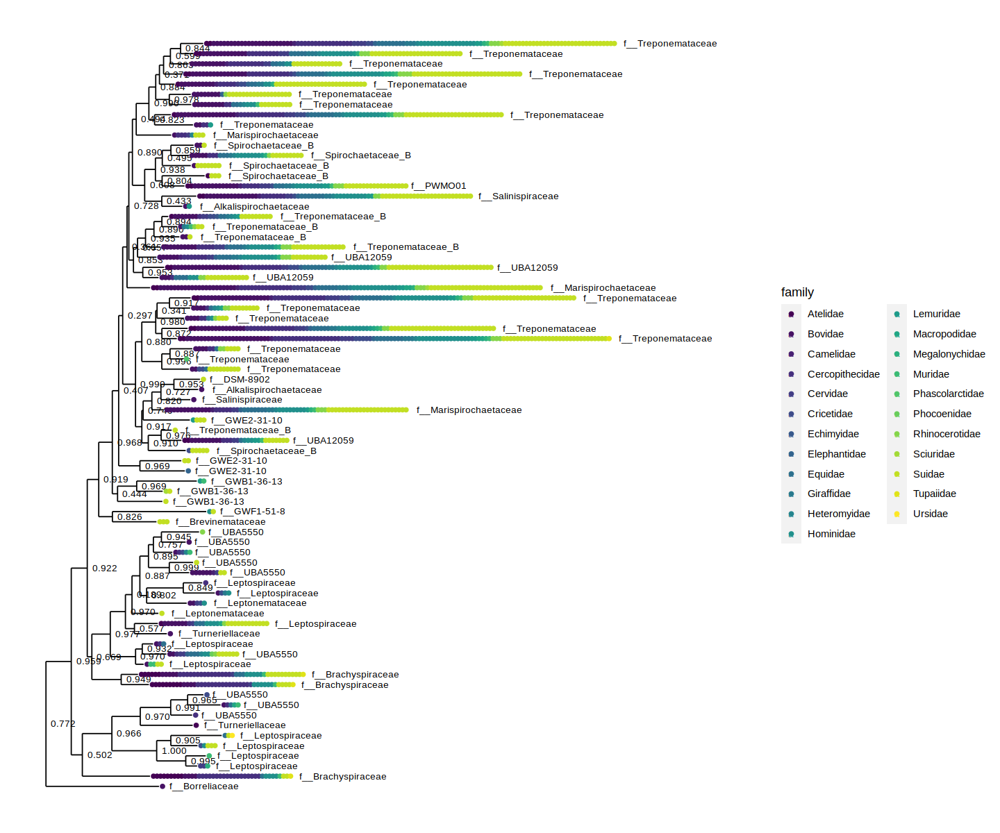

In [245]:
options(repr.plot.width=12,repr.plot.height=10)
spiro.mammals

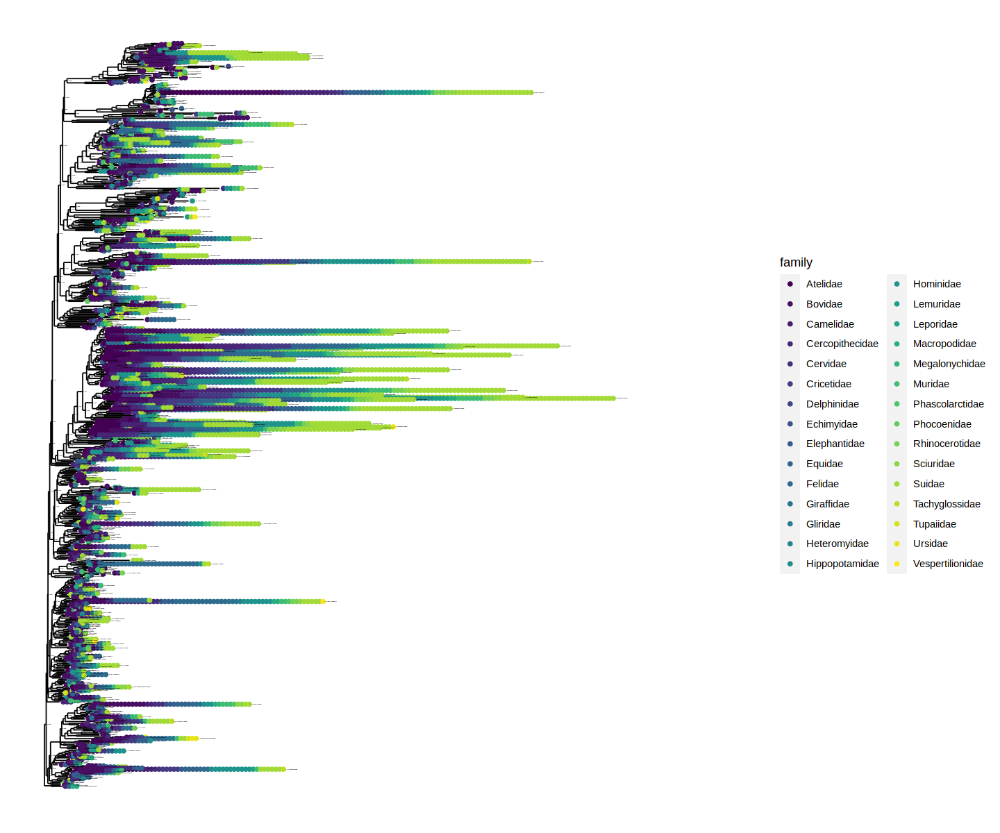

In [246]:
options(repr.plot.width=12,repr.plot.height=10)
firm.mammals

In [247]:
tre.firm=plot_tree(subset_taxa(rarefied.psAll.filt,Phylum==c("p__Firmicutes_A","p__Firmicutes_C","p__Firmicutes")),color="biome_2",label.tips="Species",ladderize="left",nodelabf=nodeplotboot())+scale_color_npg()

Warning message in Phylum == c("p__Firmicutes_A", "p__Firmicutes_C", "p__Firmicutes"):
“longer object length is not a multiple of shorter object length”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeX

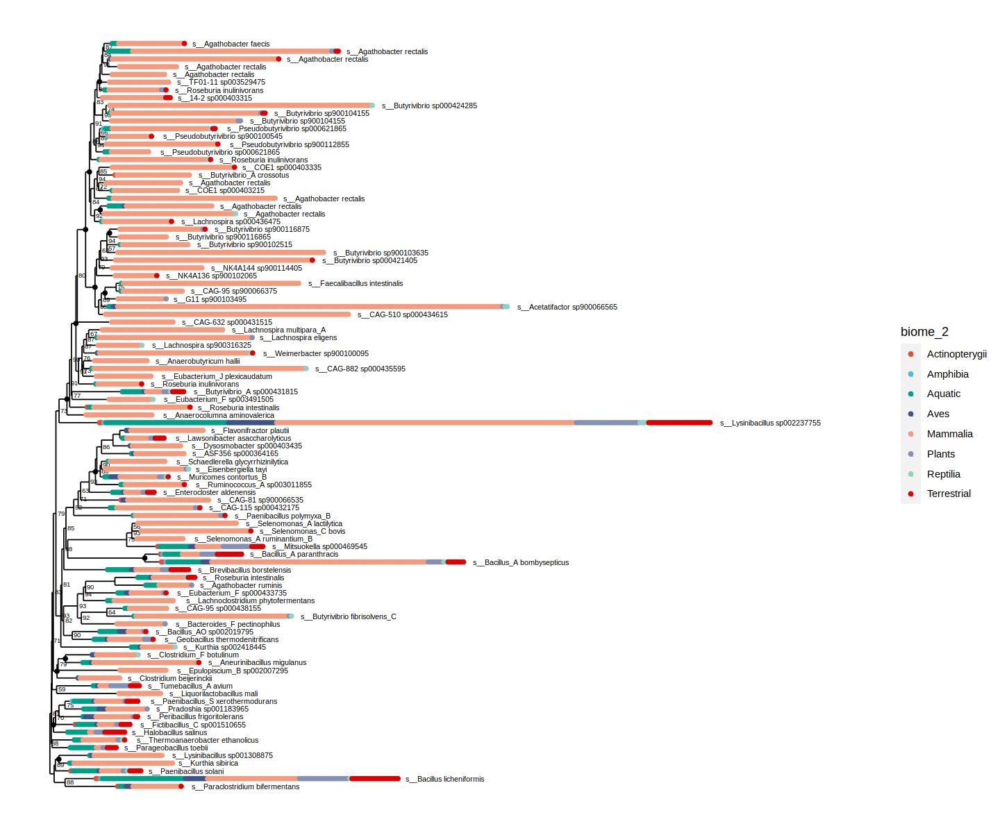

In [248]:
tre.firm

### Subset host

#### TEST - non-rarified non-filtered by prevalence/abundance

In [249]:
#rarefied.ps.All
subset.host2.tmp = subset_samples(psAll_count, biome_2 != "Host-associated")
#subset.host2.tmp=rarefy_even_depth(subset.host2.tmp, sample.size=200,
#  rngseed = FALSE, replace = TRUE, trimOTUs = TRUE, verbose = TRUE) 


Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [250]:
subset.host2.tmp

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9963 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9963 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9963 tips and 9945 internal nodes ]

In [251]:
varianceThreshold = 1e-5
keepOTUs.tmp = names(which(apply(otu_table(subset.host2.tmp), 1, var) > varianceThreshold))
filter_taxa_host.deseq.tmp = prune_taxa(keepOTUs.tmp, subset.host2.tmp)
dge.host.tmp = phyloseq_to_edgeR(filter_taxa_host.deseq.tmp, group="category")

# Perform binary test
et.tmp = exactTest(dge.host.tmp)

# Extract values from test results
tt.tmp = topTags(et.tmp, n=nrow(dge.host.tmp$table), adjust.method="BH", sort.by="PValue")
res.tmp = tt.tmp@.Data[[1]]
alpha = 0.001
sigtab.tmp = res.tmp[(res.tmp$FDR < alpha), ]

#sigtab = cbind(as.numeric(sigtab, "data.frame"), as(tax_table(filter_taxa_All2.deseq)[rownames(sigtab), ], "matrix"))
#dim(sigtab)

sigtab.host.tmp=filter(res.tmp,FDR<0.01)
head(tt.tmp)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
OUT94870.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Parvibaculales,f__RS24,g__UBA7378,s__UBA7378 sp002689195,3.317750,8.813138,6.736931e-191,6.660804e-187
KQT19785.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Beijerinckiaceae,g__Methylobacterium,s__Methylobacterium sp001423265,2.792312,8.841566,2.714599e-152,1.341962e-148
EEJ52905.1,d__Bacteria,p__Actinobacteriota,c__Actinomycetia,o__Actinomycetales,f__Actinomycetaceae,g__Mobiluncus,s__Mobiluncus mulieris,2.959748,9.472659,2.572353e-151,8.477620e-148
KDR32911.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Caballeronia,s__Caballeronia zhejiangensis,3.274548,11.699030,7.107621e-124,1.756826e-120
WP_068024403.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Xanthobacteraceae,g__Z2-YC6860,s__Z2-YC6860 sp001579845,2.673806,8.648183,6.501692e-113,1.285645e-109
OAS88434.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Achromobacter,s__Achromobacter xylosoxidans,2.470205,8.988472,1.874789e-112,3.089340e-109


In [252]:
nrow(sigtab.host.tmp)

[1] 1299

In [253]:
theme_set(theme_bw())
sigtabgen.host.tmp = subset(sigtab.host.tmp, !is.na(Genus))

# Phylum order
x = tapply(sigtabgen.host.tmp$logFC, sigtabgen.host.tmp$Phylum, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host.tmp$Phylum = factor(as.character(sigtabgen.host.tmp$Phylum), levels = names(x))

# Genus order
x = tapply(sigtabgen.host.tmp$logFC, sigtabgen.host.tmp$Genus, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host.tmp$Genus = factor(as.character(sigtabgen.host.tmp$Genus), levels = names(x))
           
# Family order
x = tapply(sigtabgen.host.tmp$logFC, sigtabgen.host.tmp$Family, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host.tmp$Family = factor(as.character(sigtabgen.host.tmp$Family), levels = names(x))
           
# Species order
x = tapply(sigtabgen.host.tmp$logFC, sigtabgen.host.tmp$Species, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host.tmp$Species = factor(as.character(sigtabgen.host.tmp$Species), levels = names(x))  

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


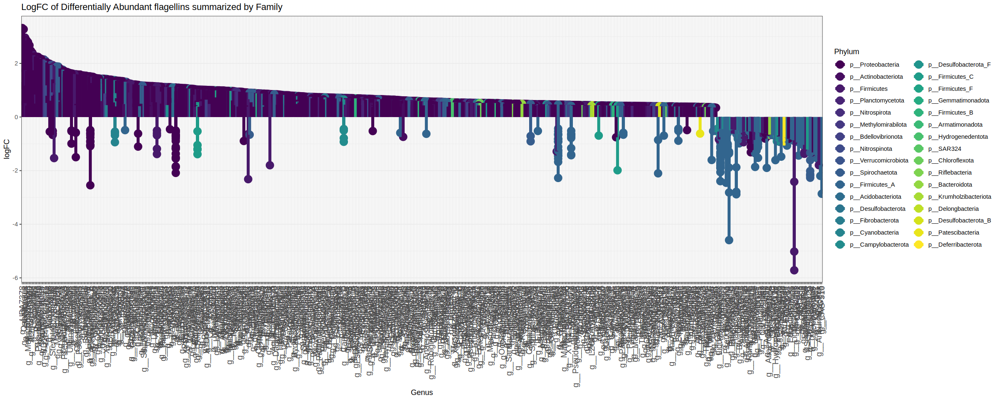

In [254]:
options(repr.plot.width=20,repr.plot.height=8)
ggplot(sigtabgen.host.tmp, aes(x = Genus, y = logFC, color = Phylum)) + geom_point(size=5) + 
  geom_segment(aes(y=0,yend=logFC,xend=Genus,xend=Genus),size=2)+
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()+
  ggtitle("LogFC of Differentially Abundant flagellins summarized by Family")

### Binary test DAs animals_plants

In [255]:
subset.host2

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 9007 taxa and 293 samples ]
sample_data() Sample Data:       [ 293 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 9007 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 9007 tips and 8997 internal nodes ]

In [256]:
varianceThreshold = 1e-5
keepOTUs = names(which(apply(otu_table(subset.host2), 1, var) > varianceThreshold))
filter_taxa_host.deseq = prune_taxa(keepOTUs, subset.host2)

dge.host = phyloseq_to_edgeR(filter_taxa_host.deseq, group="category")

# Perform binary test
et = exactTest(dge.host)

# Extract values from test results
tt = topTags(et, n=nrow(dge.host$table), adjust.method="BH", sort.by="PValue")
res = tt@.Data[[1]]
alpha = 0.001
sigtab = res[(res$FDR < alpha), ]

#sigtab = cbind(as.numeric(sigtab, "data.frame"), as(tax_table(filter_taxa_All2.deseq)[rownames(sigtab), ], "matrix"))
#dim(sigtab)

sigtab.host=filter(res,FDR<0.01)
head(tt)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
EFZ33846.1,d__Bacteria,p__Firmicutes,c__Bacilli,o__Lactobacillales,f__Lactobacillaceae,g__Ligilactobacillus,s__Ligilactobacillus ruminis,-3.897423,11.010268,1.481306e-61,1.148901e-57
EFZ34977.1,d__Bacteria,p__Firmicutes,c__Bacilli,o__Lactobacillales,f__Lactobacillaceae,g__Ligilactobacillus,s__Ligilactobacillus ruminis,-3.248943,10.455387,6.387725e-43,2.477160e-39
WP_068024403.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Xanthobacteraceae,g__Z2-YC6860,s__Z2-YC6860 sp001579845,2.000071,8.699040,3.682649e-37,9.520875e-34
WP_081136167.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Pseudomonadales,f__Halomonadaceae,g__Halomonas,s__Halomonas stevensii,-2.310835,11.348518,1.473293e-35,2.856715e-32
RHP37040.1,d__Bacteria,p__Firmicutes_A,c__Clostridia,o__Lachnospirales,f__Lachnospiraceae,g__Acetatifactor,s__Acetatifactor sp900066565,-2.823670,10.145151,9.188753e-33,1.425359e-29
ACE93333.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Rhizobiaceae,g__Rhizobium,s__Rhizobium phaseoli,1.866275,8.675746,5.605409e-28,7.245925e-25


In [257]:
write.table(sigtab.host,"sigtab.da.plants.animals.comparison.tsv")

In [258]:
DA_fla_host=rownames(sigtab.host)

In [259]:
nrow(sigtab.host)

[1] 83

#### Export list of Differentially Abundant flagellins

In [364]:
write_tsv((rownames_to_column(sigtab.host,var = "Accession")),"edgeR/DA.animalvsplant.rare.filt.tsv")

#### Plot DAs plant-animal hosts

In [260]:
theme_set(theme_bw())
sigtabgen.host = subset(sigtab.host, !is.na(Genus))

# Phylum order
x = tapply(sigtabgen.host$logFC, sigtabgen.host$Phylum, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host$Phylum = factor(as.character(sigtabgen.host$Phylum), levels = names(x))

# Genus order
x = tapply(sigtabgen.host$logFC, sigtabgen.host$Genus, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host$Genus = factor(as.character(sigtabgen.host$Genus), levels = names(x))
           
# Family order
x = tapply(sigtabgen.host$logFC, sigtabgen.host$Family, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host$Family = factor(as.character(sigtabgen.host$Family), levels = names(x))
           
# Species order
x = tapply(sigtabgen.host$logFC, sigtabgen.host$Species, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host$Species = factor(as.character(sigtabgen.host$Species), levels = names(x))           

##### A. Phylum-level

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


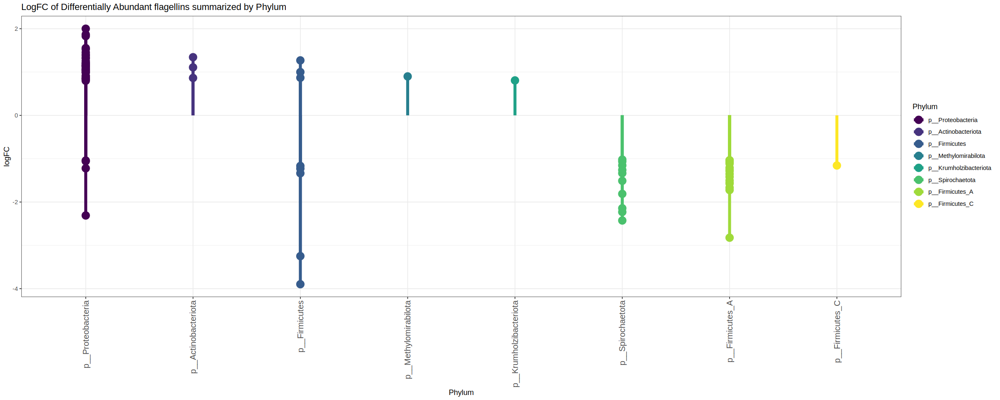

In [261]:
options(repr.plot.width=20,repr.plot.height=8)
ggplot(sigtabgen.host, aes(x = Phylum, y = logFC, color = Phylum)) + geom_point(size=5) + 
  geom_segment(aes(y=0,yend=logFC,xend=Phylum,xend=Phylum),size=2)+
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()+
  ggtitle("LogFC of Differentially Abundant flagellins summarized by Phylum")

##### B. Family-level

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


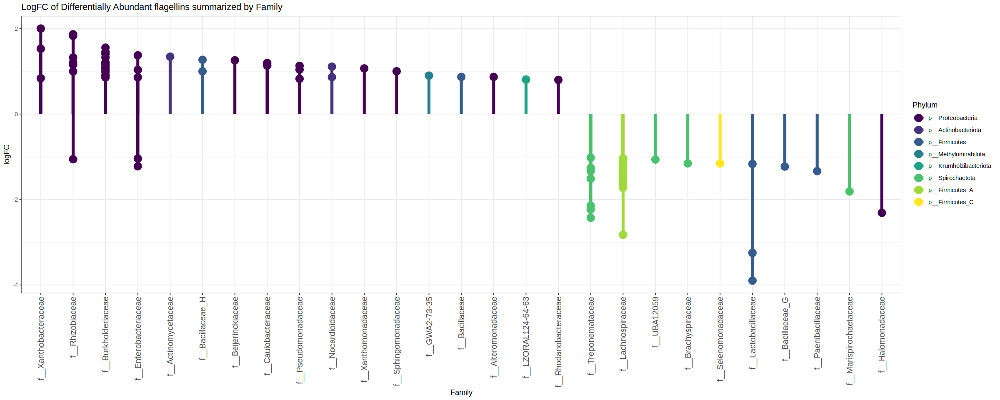

In [262]:
options(repr.plot.width=20,repr.plot.height=8)
ggplot(sigtabgen.host, aes(x = Family, y = logFC, color = Phylum)) + geom_point(size=5) + 
  geom_segment(aes(y=0,yend=logFC,xend=Family,xend=Family),size=2)+
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()+
  ggtitle("LogFC of Differentially Abundant flagellins summarized by Family")

##### C. Genus-level

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


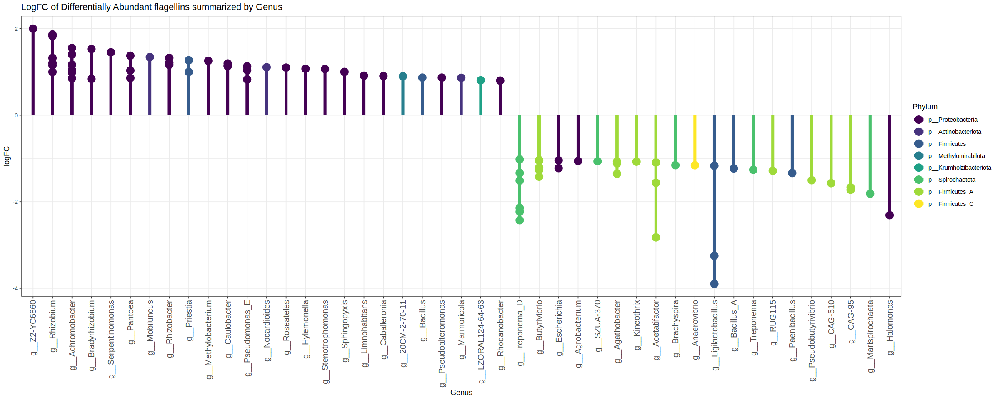

In [263]:
options(repr.plot.width=20,repr.plot.height=8)
ggplot(sigtabgen.host, aes(x = Genus, y = logFC, color = Phylum)) + geom_point(size=5) + 
  geom_segment(aes(y=0,yend=logFC,xend=Genus,xend=Genus),size=2)+
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d() +
  ggtitle("LogFC of Differentially Abundant flagellins summarized by Genus")

##### D. species-level

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


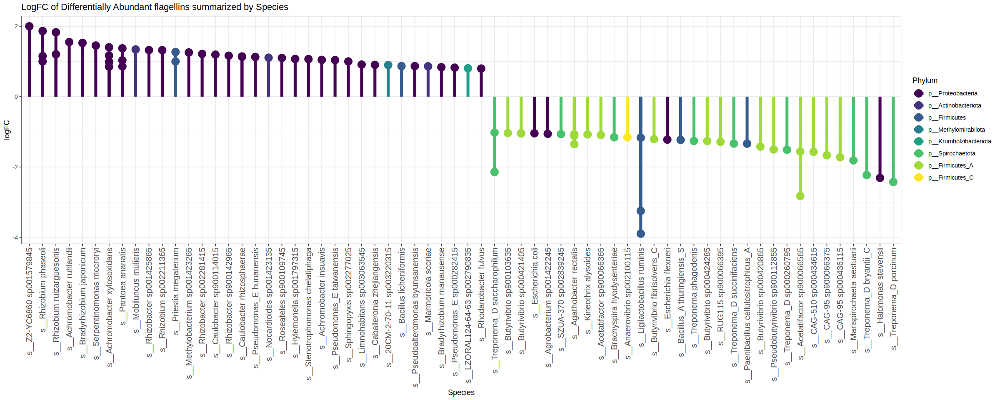

In [264]:
options(repr.plot.width=20,repr.plot.height=8)
ggplot(sigtabgen.host, aes(x = Species, y = logFC, color = Phylum)) + geom_point(size=5) + 
  geom_segment(aes(y=0,yend=logFC,xend=Species,xend=Species),size=2)+
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()+
  ggtitle("LogFC of Differentially Abundant flagellins summarized by Species")

In [265]:
DAs.host=rownames(sigtab.host)
DAs_fla_host = prune_taxa(DAs.host,subset.host2.tmp)
DAs_fla_host

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 83 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 83 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 83 tips and 82 internal nodes ]

In [266]:
DAs_fla_host

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 83 taxa and 792 samples ]
sample_data() Sample Data:       [ 792 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 83 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 83 tips and 82 internal nodes ]

In [267]:
count(DAs_fla_host@sam_data,category)

$category
[1] "Animal"        "Environmental" "Plants"       

$n
[1] 572 133  87

attr(,"row.names")
[1] 1 2 3
attr(,".S3Class")
[1] "data.frame"
attr(,"class")
[1] "sample_data"
attr(,"class")attr(,"package")
[1] "phyloseq"

In [268]:
DA.fla.host=prune_taxa(DA_fla_host,subset.host)
DA.fla.host

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 83 taxa and 294 samples ]
sample_data() Sample Data:       [ 294 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 83 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 83 tips and 82 internal nodes ]

#### Heatmap DAs animal-plants

In [269]:
library(pheatmap)

#### Create function to map color to annotation

In [270]:
mapBiomeToColor<-function(annotations){
    colorsVector = ifelse(annotations["category"]=="Plants", 
        "darkcyan", ifelse(annotations["category"]=="Animal", 
        "coral", "red"))
    return(colorsVector)
}

#### Create data.frame with metadata annotations

In [271]:
annotation.host <- data.frame(sample=DAs_fla_host@sam_data$Sample,
                        biome2=DAs_fla_host@sam_data$biome_2,
                        category=DAs_fla_host@sam_data$category)
rownames(annotation.host)=annotation.host$sample

sampleColors.host = mapBiomeToColor(annotation.host)

#### Create colors vector based on annotations

In [272]:
cols.vector.host =(t(sampleColors.host))
cols.vector.host = sampleColors.host[2:nrow(sampleColors.host),]

In [273]:
annotation.col = select(annotation.host,-sample)

In [274]:
annotation.row=data.frame(DAs_fla_host@tax_table)

#### Create abundance matrix for heatmap

In [275]:
matrix.host=as.matrix(DAs_fla_host@otu_table[,2:ncol(DAs_fla_host@otu_table)])
rownames(matrix.host)=rownames(DAs_fla_host@otu_table)

Mt2_GH<-log((matrix.host*1000)+1)

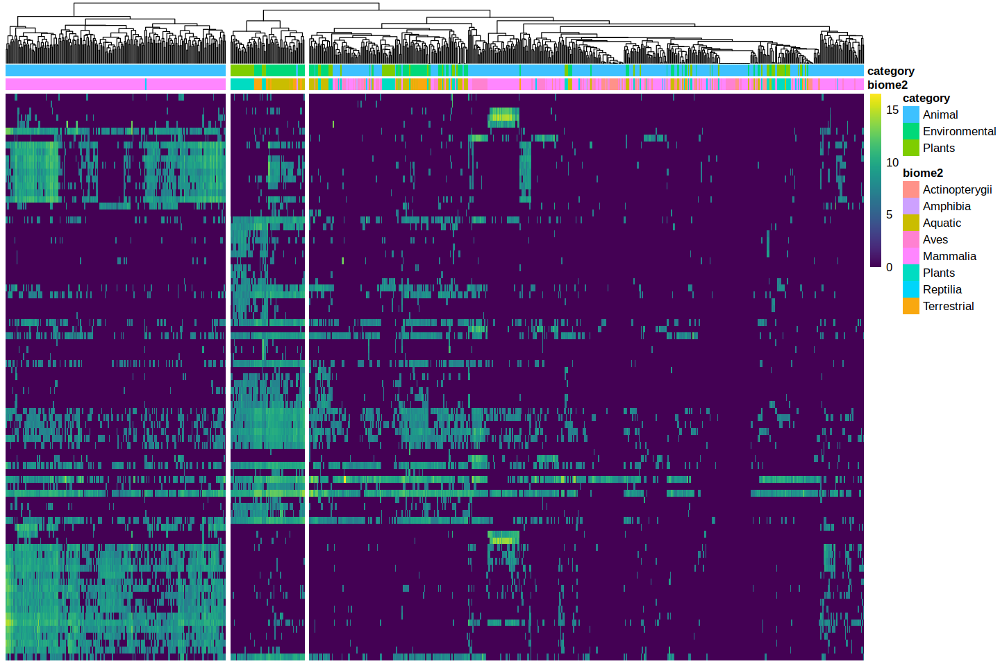

In [276]:
options(repr.plot.width=15,repr.plot.width=12)
pheatmap(Mt2_GH, cutree_cols = 3,
         cluster_cols=TRUE,
         cluster_rows=FALSE,
         show_rownames=F,
         show_colnames=F,
         labels_row=annotation.row$Phylum,
         annotation_col=annotation.col,
          color = viridis(n = 256, alpha = 1, 
                                   begin = 0, end = 1, option = "viridis")
)

#### OTU tree of DA taxa

In [277]:
tre.DA.firm=plot_tree(subset_taxa(DA.fla.host,Phylum==c("p__Firmicutes_A","p__Firmicutes_C","p__Firmicutes")),color="biome_2",label.tips="Species",ladderize="left",nodelabf=nodeplotboot())+scale_color_npg()
tre.DA.proteo=plot_tree(subset_taxa(DA.fla.host,Phylum=="p__Proteobacteria"),color="biome_2",label.tips="Species",ladderize="left",nodelabf=nodeplotboot())+scale_color_npg()

Warning message in Phylum == c("p__Firmicutes_A", "p__Firmicutes_C", "p__Firmicutes"):
“longer object length is not a multiple of shorter object length”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Warning message in psmelt(physeq):
“The sample variables: 
Sample
 have been renamed to: 
sample_Sample
to avoid conflicts with special phyloseq plot attribute names.”
Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeX

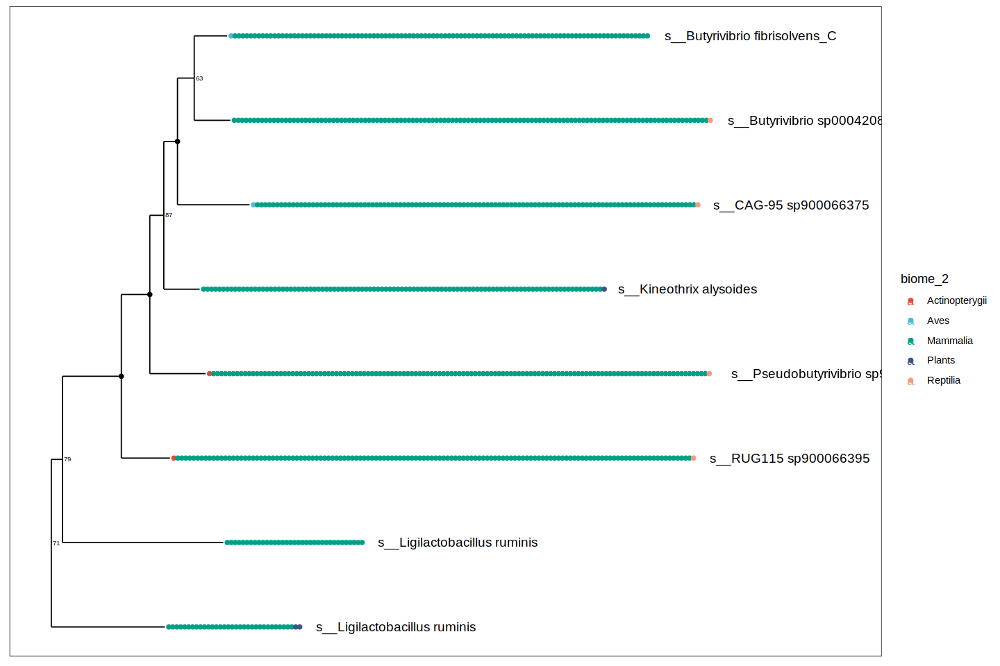

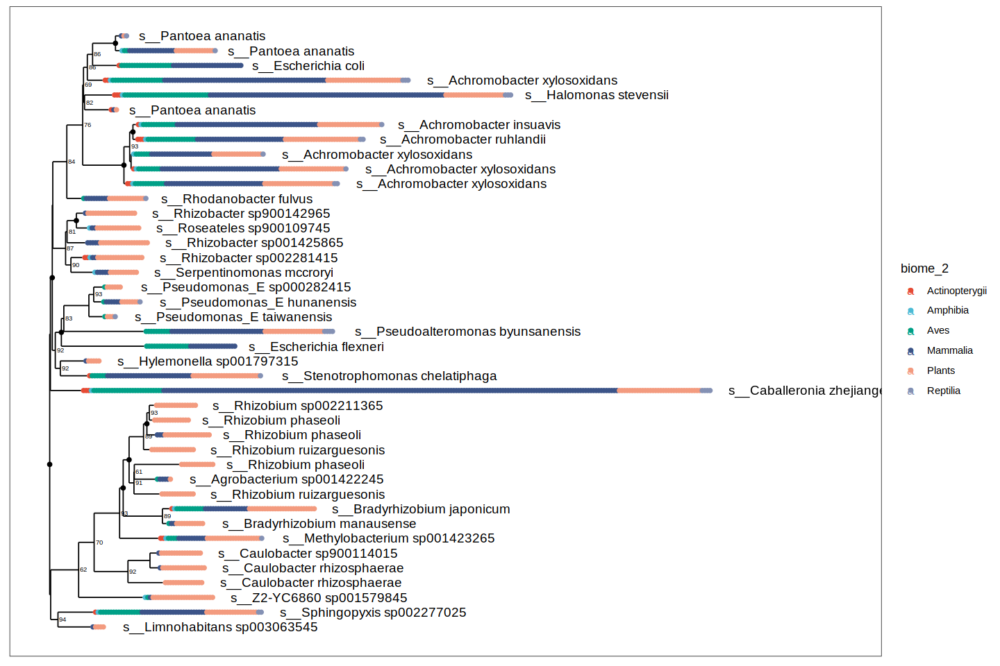

In [278]:
tre.DA.firm
tre.DA.proteo

### Host vs. environmental

In [279]:
rarefied.psAll.filt

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 701 taxa and 396 samples ]
sample_data() Sample Data:       [ 396 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 701 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 701 tips and 700 internal nodes ]

In [280]:
count(as_tibble(rarefied.psAll.filt@sam_data),biome_1)

biome_1,n
<chr>,<int>
Environmental,102
Host-associated,294


In [282]:
varianceThreshold = 1e-5
keepOTUs = names(which(apply(otu_table(rarefied.psAll.filt), 1, var) > varianceThreshold))
filter_taxa_biome1.filt = prune_taxa(keepOTUs, rarefied.psAll.filt)

dge.biome1 = phyloseq_to_edgeR(filter_taxa_biome1.filt, group="biome_1")
# Perform binary test
et.biome1 = exactTest(dge.biome1)
# Extract values from test results
tt.biome1 = topTags(et.biome1, n=nrow(dge.biome1$table), adjust.method="BH", sort.by="PValue")
res.biome1 = tt.biome1@.Data[[1]]
alpha = 0.001
sigtab.biome1 = res.biome1[(res.biome1$FDR < alpha), ]
#sigtab = cbind(as(sigtab, "data.frame"), as(tax_table(rarefied.psAll.filt)[rownames(sigtab), ], "matrix"))
#dim(sigtab)

sigtab.biome1=filter(res.biome1,FDR<0.01)
head(tt.biome1)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
KDR32911.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Caballeronia,s__Caballeronia zhejiangensis,-1.987287,14.07987,2.715895e-49,1.903842e-46
EEJ52905.1,d__Bacteria,p__Actinobacteriota,c__Actinomycetia,o__Actinomycetales,f__Actinomycetaceae,g__Mobiluncus,s__Mobiluncus mulieris,-1.448658,12.34618,8.140991e-36,2.853417e-33
RHP37040.1,d__Bacteria,p__Firmicutes_A,c__Clostridia,o__Lachnospirales,f__Lachnospiraceae,g__Acetatifactor,s__Acetatifactor sp900066565,2.674075,12.97658,5.816361e-34,1.359090e-31
EFZ33846.1,d__Bacteria,p__Firmicutes,c__Bacilli,o__Lactobacillales,f__Lactobacillaceae,g__Ligilactobacillus,s__Ligilactobacillus ruminis,3.740998,13.77661,6.301046e-26,1.104258e-23
EFZ34977.1,d__Bacteria,p__Firmicutes,c__Bacilli,o__Lactobacillales,f__Lactobacillaceae,g__Ligilactobacillus,s__Ligilactobacillus ruminis,3.086691,13.26062,1.651118e-22,2.314868e-20
SJZ39514.1,d__Bacteria,p__Spirochaetota,c__Spirochaetia,o__Treponematales,f__Treponemataceae,g__Treponema_D,s__Treponema_D porcinum,2.063424,12.77444,1.418294e-21,1.657040e-19


In [283]:
#write_csv(as_tibble(rownames(sigtab.biome1)),"DA_fla_biome1.csv")

#### Export list of Differentially Abundant flagellins

In [363]:
write_tsv((rownames_to_column(sigtab.biome1,var = "Accession")),"edgeR/DA.host.env.rare.filt.tsv")

#### Plot DAs host vs. environmental

In [285]:
nrow(sigtab.biome1)

[1] 166

In [286]:
theme_set(theme_bw())
sigtabgen.biome1 = subset(sigtab, !is.na(Genus))

# Phylum order
x = tapply(sigtabgen.biome1$logFC, sigtabgen.biome1$Phylum, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.biome1$Phylum = factor(as.character(sigtabgen.biome1$Phylum), levels = names(x))

# Genus order
x = tapply(sigtabgen.biome1$logFC, sigtabgen.biome1$Genus, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.biome1$Genus = factor(as.character(sigtabgen.biome1$Genus), levels = names(x))

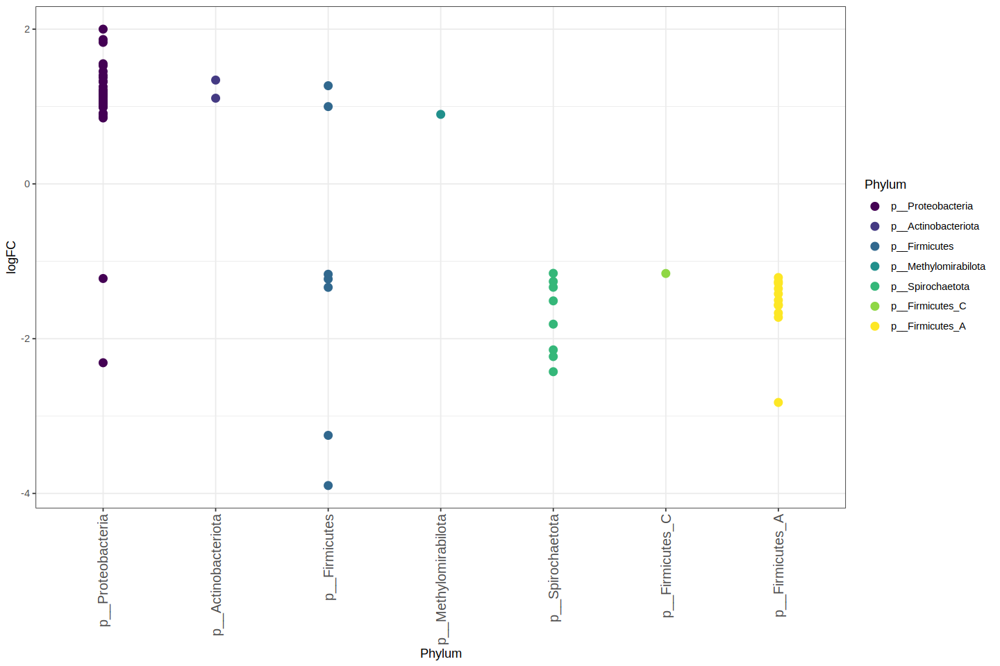

In [287]:
ggplot(sigtabgen.biome1, aes(x = Phylum, y = logFC, color = Phylum)) + geom_point(size=3) + 
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()

In [288]:
DAs.biome1=rownames(sigtab.biome1)
DAs_fla_biome1 = prune_taxa(DAs.biome1, rarefied.psAll.filt)
DAs_fla_biome1

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 166 taxa and 396 samples ]
sample_data() Sample Data:       [ 396 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 166 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 166 tips and 165 internal nodes ]

In [289]:
mapBiomeToColor<-function(annotations){
    colorsVector = ifelse(annotations["category"]=="Environmental", 
        "blue", ifelse(annotations["category"]=="Animal", 
        "green", "red"))
    return(colorsVector)
}

annotation.biome1 <- data.frame(sample=DAs_fla_biome1@sam_data$Sample,
                        biome=DAs_fla_biome1@sam_data$biome_1,
                        category=DAs_fla_biome1@sam_data$category,
                        biome2=DAs_fla_biome1@sam_data$biome_2)

sampleColors.biome1 = mapBiomeToColor(annotation.biome1)

In [290]:
annotation.biome1 <- data.frame(sample=DAs_fla_biome1@sam_data$Sample,
                        biome=DAs_fla_biome1@sam_data$biome_2,
                        category=DAs_fla_biome1@sam_data$category)
rownames(annotation.biome1)=annotation.biome1$sample

In [291]:
annotation.col.biome1 = select(annotation.biome1,-sample)

In [299]:
annotation.row.biome1=data.frame(DAs_fla_biome1@tax_table)

In [294]:
matrix.biome1=as.matrix(DAs_fla_biome1@otu_table[,2:ncol(DAs_fla_biome1@otu_table)])
rownames(matrix.biome1)=rownames(DAs_fla_biome1@otu_table)

Mt2_biome1<-log((matrix.biome1*1000)+1)

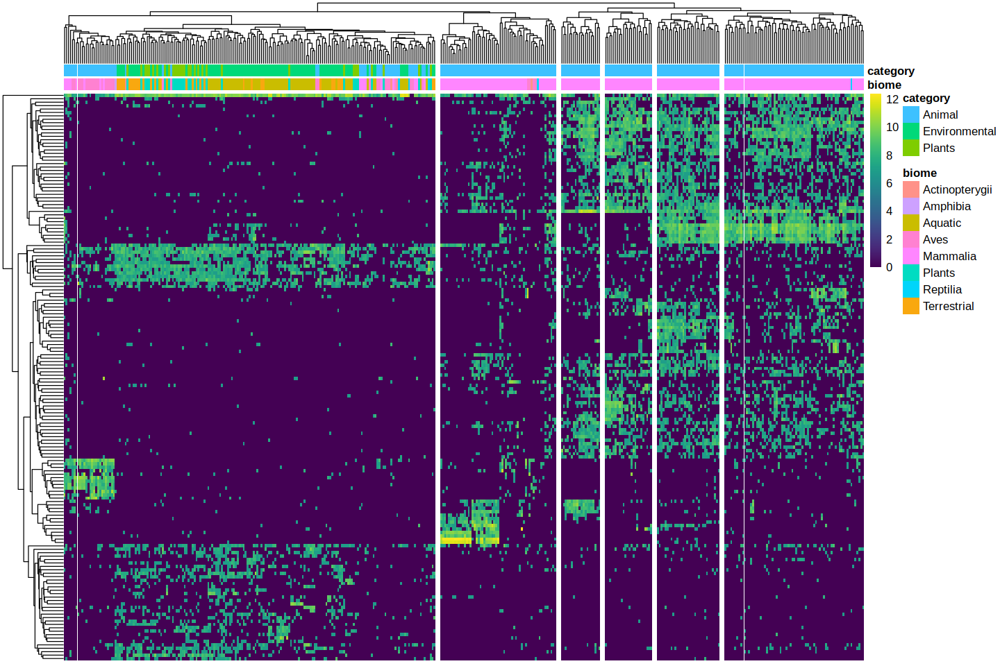

In [300]:
pheatmap(Mt2_biome1, cutree_cols = 6,
         cluster_cols=TRUE,
         cluster_rows=TRUE,
         show_rownames=F,
         show_colnames=F,
         labels_row=annotation.row.biome1$Phylum,
         annotation_col=annotation.col.biome1,
         color = viridis(n = 256, alpha = 1, 
                                   begin = 0, end = 1, option = "viridis")
)

### Environmental vs. Animals

In [306]:
rarefied.psAll.filt.anim.env = subset_samples(rarefied.psAll.filt,category==c("Environmental","Animal"))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [307]:
rarefied.psAll.filt.anim.env

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 701 taxa and 182 samples ]
sample_data() Sample Data:       [ 182 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 701 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 701 tips and 700 internal nodes ]

In [389]:
varianceThreshold = 1e-5
keepOTUs = names(which(apply(otu_table(rarefied.psAll.filt.anim.env), 1, var) > varianceThreshold))
filter_taxa_animal.env.filt = prune_taxa(keepOTUs, rarefied.psAll.filt.anim.env)

dge.anim.env = phyloseq_to_edgeR(filter_taxa_animal.env.filt, group="category")
# Perform binary test
et.anim.env = exactTest(dge.anim.env)
# Extract values from test results
tt.anim.env = topTags(et.anim.env, n=nrow(dge.anim.env$table), adjust.method="BH", sort.by="PValue")
res.anim.env = tt.anim.env@.Data[[1]]
alpha = 0.001
sigtab.anim.env = res[(res$FDR < alpha), ]
#sigtab = cbind(as(sigtab, "data.frame"), as(tax_table(rarefied.psAll.filt)[rownames(sigtab), ], "matrix"))
#dim(sigtab)

sigtab.anim.env=filter(res.anim.env,FDR<0.01)
head(tt.anim.env)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
KDR32911.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Caballeronia,s__Caballeronia zhejiangensis,2.119438,14.15174,3.104126e-26,2.175992e-23
EEJ52905.1,d__Bacteria,p__Actinobacteriota,c__Actinomycetia,o__Actinomycetales,f__Actinomycetaceae,g__Mobiluncus,s__Mobiluncus mulieris,1.500100,12.26035,5.894436e-20,1.679125e-17
RHP37040.1,d__Bacteria,p__Firmicutes_A,c__Clostridia,o__Lachnospirales,f__Lachnospiraceae,g__Acetatifactor,s__Acetatifactor sp900066565,-2.775440,12.98752,7.185984e-20,1.679125e-17
EFZ33846.1,d__Bacteria,p__Firmicutes,c__Bacilli,o__Lactobacillales,f__Lactobacillaceae,g__Ligilactobacillus,s__Ligilactobacillus ruminis,-3.815614,13.79856,2.957759e-14,5.183473e-12
SJZ39514.1,d__Bacteria,p__Spirochaetota,c__Spirochaetia,o__Treponematales,f__Treponemataceae,g__Treponema_D,s__Treponema_D porcinum,-2.333186,12.91232,4.604290e-14,6.455215e-12
WP_022931566.1,d__Bacteria,p__Spirochaetota,c__Spirochaetia,o__Treponematales,f__Treponemataceae,g__Treponema_D,s__Treponema_D bryantii_C,-2.142652,12.66159,8.988289e-13,1.050132e-10


In [391]:
nrow(sigtab.anim.env)

[1] 95

#### Export list of Differentially Abundant flagellins

In [361]:
write_tsv((rownames_to_column(sigtab.anim.env,var = "Accession")),"edgeR/DA.animals.env.rare.filt.tsv")

In [388]:
nrow(sigtab.anim.env)

[1] 95

#### Plot DAs Env/Animal

In [309]:
theme_set(theme_bw())
sigtab.anim.env = subset(sigtab.anim.env, !is.na(Genus))

# Phylum order
x = tapply(sigtab.anim.env$logFC, sigtab.anim.env$Phylum, function(x) max(x))
x = sort(x, TRUE)
sigtab.anim.env$Phylum = factor(as.character(sigtab.anim.env$Phylum), levels = names(x))

# Genus order
x = tapply(sigtab.anim.env$logFC, sigtab.anim.env$Genus, function(x) max(x))
x = sort(x, TRUE)
sigtab.anim.env$Genus = factor(as.character(sigtab.anim.env$Genus), levels = names(x))
           
# Family order
x = tapply(sigtab.anim.env$logFC, sigtab.anim.env$Family, function(x) max(x))
x = sort(x, TRUE)
sigtab.anim.env$Family = factor(as.character(sigtab.anim.env$Family), levels = names(x))

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


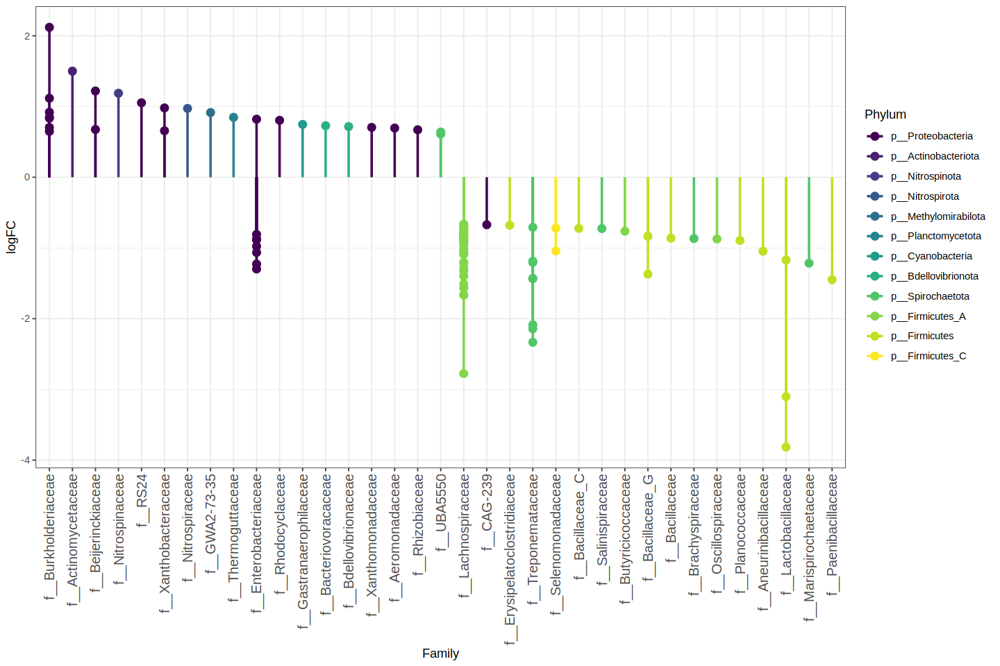

In [310]:
ggplot(sigtab.anim.env, aes(x = Family, y = logFC, color = Phylum)) + geom_point(size=3) + 
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()+
geom_segment(aes(y=0,yend=logFC,xend=Family,xend=Family),size=1)

### Environmental vs. Plants

In [311]:
rarefied.psAll.filt.plant.env = subset_samples(rarefied.psAll.filt,category==c("Environmental","Plants"))

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [392]:
rarefied.psAll.filt.plant.env

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 701 taxa and 67 samples ]
sample_data() Sample Data:       [ 67 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 701 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 701 tips and 700 internal nodes ]

In [393]:
varianceThreshold = 1e-5
keepOTUs.rare.plant.env = names(which(apply(otu_table(rarefied.psAll.filt.plant.env), 1, var) > varianceThreshold))
filter_taxa_plant.env.filt = prune_taxa(keepOTUs.rare.plant.env, rarefied.psAll.filt.plant.env)

dge.rare.plant.env= phyloseq_to_edgeR(filter_taxa_plant.env.filt, group="category")
# Perform binary test
et.rare.plant.env = exactTest(dge.rare.plant.env)
# Extract values from test results
tt.rare.plant.env = topTags(et.rare.plant.env, n=nrow(dge.rare.plant.env$table), adjust.method="BH", sort.by="PValue")
res.rare.plant.env = tt.rare.plant.env@.Data[[1]]
alpha = 0.001
sigtab.rare.plant.env = res.rare.plant.env[(res.rare.plant.env$FDR < alpha), ]
#sigtab = cbind(as(sigtab, "data.frame"), as(tax_table(rarefied.psAll.filt)[rownames(sigtab), ], "matrix"))
#dim(sigtab)

sigtab.rare.plant.env=filter(res.rare.plant.env,FDR<0.01)
head(tt.rare.plant.env)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
ACE93333.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Rhizobiaceae,g__Rhizobium,s__Rhizobium phaseoli,1.799154,12.32152,7.735973e-10,4.216105e-07
WP_081136167.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Pseudomonadales,f__Halomonadaceae,g__Halomonas,s__Halomonas stevensii,-1.988792,14.25392,2.984908e-06,8.133874e-04
KQQ39766.1,d__Bacteria,p__Actinobacteriota,c__Actinomycetia,o__Propionibacteriales,f__Nocardioidaceae,g__Nocardioides,s__Nocardioides sp001423135,1.225467,12.29823,8.176030e-06,1.226936e-03
OYY61291.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Rhizobacter,s__Rhizobacter sp002281415,1.295450,12.29239,9.005037e-06,1.226936e-03
BAO83469.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Serpentinomonas,s__Serpentinomonas mccroryi,1.454222,12.38943,3.538789e-05,3.770488e-03
WP_082564463.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Caulobacterales,f__Caulobacteraceae,g__Caulobacter,s__Caulobacter rhizosphaerae,1.212912,12.20127,4.150996e-05,3.770488e-03


#### Export list of Differentially Abundant flagellins

In [394]:
nrow(sigtab.rare.plant.env)

[1] 7

In [395]:
write_tsv((rownames_to_column(sigtab.rare.plant.env,var = "Accession")),"edgeR/DA.plants.env.rare.filt.tsv")

#### Plot DAs Env/Plants

In [315]:
theme_set(theme_bw())
sigtab.plant.env = subset(sigtab.rare.plant.env, !is.na(Genus))

# Phylum order
x = tapply(sigtab.plant.env$logFC, sigtab.plant.env$Phylum, function(x) max(x))
x = sort(x, TRUE)
sigtab.plant.env$Phylum = factor(as.character(sigtab.plant.env$Phylum), levels = names(x))

# Genus order
x = tapply(sigtab.plant.env$logFC, sigtab.plant.env$Genus, function(x) max(x))
x = sort(x, TRUE)
sigtab.plant.env$Genus = factor(as.character(sigtab.plant.env$Genus), levels = names(x))

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


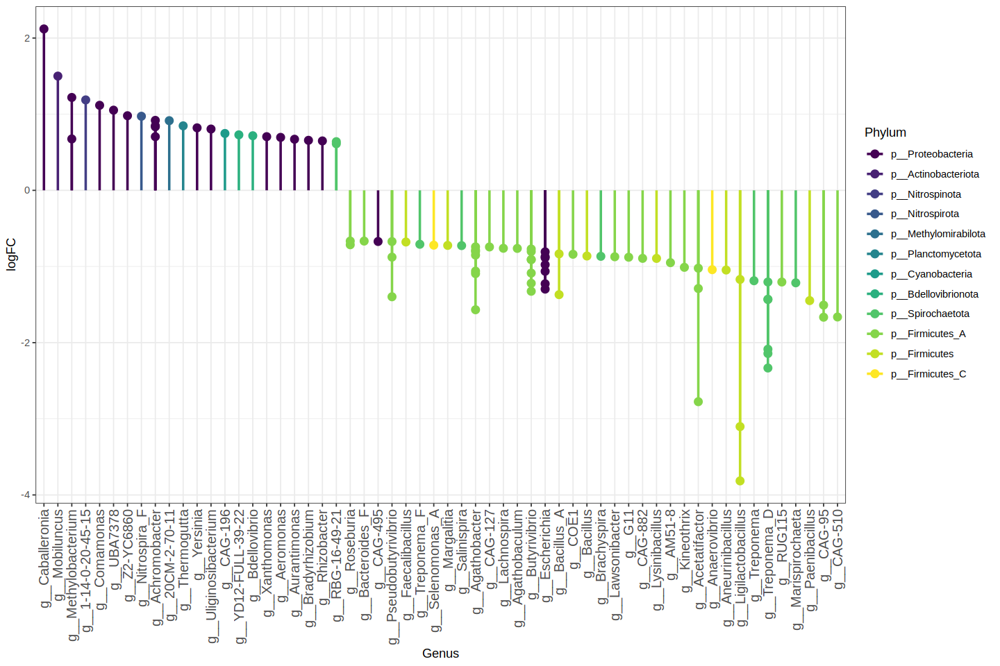

In [316]:
ggplot(sigtab.plant.env, aes(x = Genus, y = logFC, color = Phylum)) + geom_point(size=3) + 
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()+
geom_segment(aes(y=0,yend=logFC,xend=Genus,xend=Genus),size=1)

## II. EdgeR - Non-rarefied & filtered data 

In [484]:
#nonrare.psAll.filt=phyloseq_filter_prevalence(psAll, prev.trh = 0.05, abund.trh = 10,
 # threshold_condition = "OR", abund.type = "mean")
nonrare.psAll.filt=phyloseq_filter_prevalence(psAll_count, prev.trh = 0.05, abund.trh = 50,
  threshold_condition = "OR", abund.type = "mean")
nonrare.psAll.filt=prune_samples(sample_sums(nonrare.psAll.filt)>0,nonrare.psAll.filt)
nonrare.psAll.filt

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 1454 taxa and 779 samples ]
sample_data() Sample Data:       [ 779 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 1454 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 1454 tips and 1453 internal nodes ]

In [475]:
tax_table_nonrare = as.data.frame(nonrare.psAll.filt@tax_table)%>%
rownames_to_column(var="Accession")

In [478]:
write_tsv(tax_table_nonrare,"edgeR/flags.tax.nonrareAll.tsv")
write.tree(nonrare.psAll.filt@phy_tree,"edgeR/flags.nonrareAll.tre")

In [437]:
# Flagellins in plants
write.tree(nonrare.psAll.filt@phy_tree,"edgeR/flags.tre_Plants.tre")

#### 1. Plants vs. animals

In [485]:
#nonrare.psAll.filt
subset.host.nonrare.filt=subset_samples(nonrare.psAll.filt,biome_1=="Host-associated")

varianceThreshold = 1e-5
keepOTUs = names(which(apply(otu_table(subset.host.nonrare.filt), 1, var) > varianceThreshold))
filter_taxa_host.deseq.nonrare.filt = prune_taxa(keepOTUs, subset.host.nonrare.filt)

dge.host.nonrare.filt = phyloseq_to_edgeR(filter_taxa_host.deseq.nonrare.filt, group="category")

# Perform binary test
et.nonrare.filt.host = exactTest(dge.host.nonrare.filt)

# Extract values from test results
tt.nonrare.filt.host = topTags(et.nonrare.filt.host, n=nrow(dge.host.nonrare.filt$table), adjust.method="BH", sort.by="PValue")
res.nonrare.filt.host = tt.nonrare.filt.host@.Data[[1]]
alpha = 0.001
sigtab.host.nonrare.filt = res.nonrare.filt.host[(res.nonrare.filt.host$FDR < alpha), ]

#sigtab = cbind(as.numeric(sigtab, "data.frame"), as(tax_table(filter_taxa_All2.deseq)[rownames(sigtab), ], "matrix"))
#dim(sigtab)

sigtab.host.nonrare.filt=filter(res.nonrare.filt.host,FDR<0.01)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [486]:
head(tt.nonrare.filt.host)

,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
SFH83235.1,d__Bacteria,p__Firmicutes_A,c__Clostridia,o__Lachnospirales,f__Lachnospiraceae,g__Pseudobutyrivibrio,s__Pseudobutyrivibrio sp900113655,2.869283,10.95110,1.488676e-127,2.164535e-124
EHS53753.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Rhizobiaceae,g__Allorhizobium,s__Allorhizobium sp000247475,2.621441,10.94221,8.408798e-105,6.113196e-102
KPF42046.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Rhizobiaceae,g__Allorhizobium,s__Allorhizobium sp001296045,1.675140,10.71848,1.246348e-50,6.040631e-48
PPQ20111.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Xanthobacteraceae,g__Bradyrhizobium,s__Bradyrhizobium shewense,1.724657,10.71384,8.467270e-42,2.931656e-39
WP_068024403.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Xanthobacteraceae,g__Z2-YC6860,s__Z2-YC6860 sp001579845,1.565110,10.72193,1.008135e-41,2.931656e-39
ACE93333.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Rhizobiaceae,g__Rhizobium,s__Rhizobium phaseoli,1.365366,10.67844,5.782088e-32,1.401193e-29


#### Export list of Differentially Abundant flagellins

In [354]:
DA.animalsvsplants = rownames_to_column(sigtab.host.nonrare.filt,var = "Accession")
write_tsv(DA.animalsvsplants,"edgeR/DA.animalvsplant.nonrare.filt.tsv")
head(DA.animalsvsplants)

,Accession,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
1,SFH83235.1,d__Bacteria,p__Firmicutes_A,c__Clostridia,o__Lachnospirales,f__Lachnospiraceae,g__Pseudobutyrivibrio,s__Pseudobutyrivibrio sp900113655,2.869283,10.95110,1.488676e-127,2.164535e-124
2,EHS53753.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Rhizobiaceae,g__Allorhizobium,s__Allorhizobium sp000247475,2.621441,10.94221,8.408798e-105,6.113196e-102
3,KPF42046.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Rhizobiaceae,g__Allorhizobium,s__Allorhizobium sp001296045,1.675140,10.71848,1.246348e-50,6.040631e-48
4,PPQ20111.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Xanthobacteraceae,g__Bradyrhizobium,s__Bradyrhizobium shewense,1.724657,10.71384,8.467270e-42,2.931656e-39
5,WP_068024403.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Xanthobacteraceae,g__Z2-YC6860,s__Z2-YC6860 sp001579845,1.565110,10.72193,1.008135e-41,2.931656e-39
6,ACE93333.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Rhizobiaceae,g__Rhizobium,s__Rhizobium phaseoli,1.365366,10.67844,5.782088e-32,1.401193e-29


In [320]:
theme_set(theme_bw())
sigtabgen.host.filt.nonrare = subset(sigtab.host.nonrare.filt, !is.na(Genus))

# Phylum order
x = tapply(sigtab.host.nonrare.filt$logFC, sigtab.host.nonrare.filt$Phylum, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host.filt.nonrare$Phylum = factor(as.character(sigtabgen.host.filt.nonrare$Phylum), levels = names(x))

# Genus order
x = tapply(sigtabgen.host.filt.nonrare$logFC, sigtabgen.host.filt.nonrare$Genus, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host.filt.nonrare$Genus = factor(as.character(sigtabgen.host.filt.nonrare$Genus), levels = names(x))
           
# Family order
x = tapply(sigtabgen.host.filt.nonrare$logFC, sigtabgen.host.filt.nonrare$Family, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.host.filt.nonrare$Family = factor(as.character(sigtabgen.host.filt.nonrare$Family), levels = names(x))

#### Plots

##### A. Phlyum-level

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


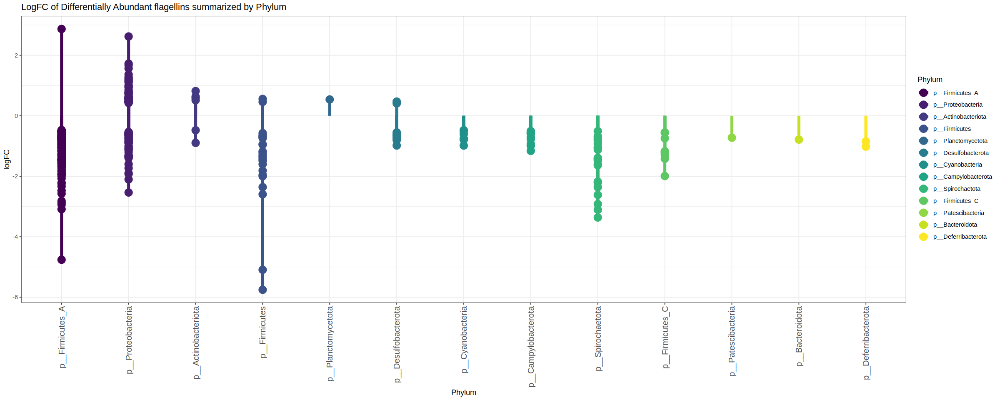

In [323]:
options(repr.plot.width=20,repr.plot.height=8)
ggplot(sigtabgen.host.filt.nonrare, aes(x = Phylum, y = logFC, color = Phylum)) + geom_point(size=5) + 
  geom_segment(aes(y=0,yend=logFC,xend=Phylum,xend=Phylum),size=2)+
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()+
  ggtitle("LogFC of Differentially Abundant flagellins summarized by Phylum")

##### B. Family-level

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


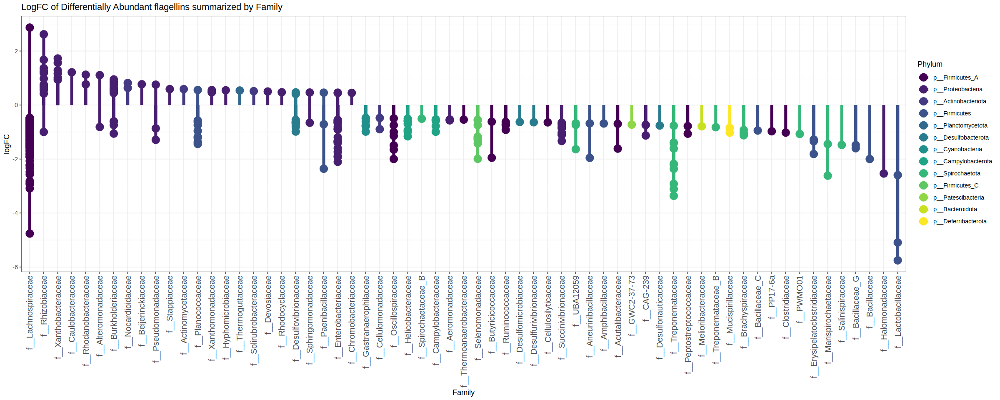

In [324]:
options(repr.plot.width=20,repr.plot.height=8)
ggplot(sigtabgen.host.filt.nonrare, aes(x = Family, y = logFC, color = Phylum)) + geom_point(size=5) + 
  geom_segment(aes(y=0,yend=logFC,xend=Family,xend=Family),size=2)+
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()+
  ggtitle("LogFC of Differentially Abundant flagellins summarized by Family")

##### C. Genus-level

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


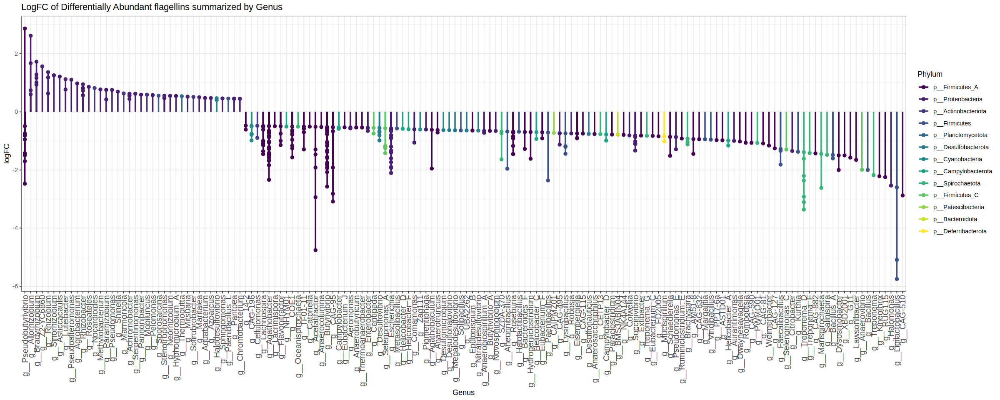

In [325]:
options(repr.plot.width=20,repr.plot.height=8)
ggplot(sigtabgen.host.filt.nonrare, aes(x = Genus, y = logFC, color = Phylum)) + geom_point(size=2) + 
  geom_segment(aes(y=0,yend=logFC,xend=Genus,xend=Genus),size=1)+
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d() +
  ggtitle("LogFC of Differentially Abundant flagellins summarized by Genus")

##### D. species-level

Warning message:
“Duplicated aesthetics after name standardisation: xend”
Warning message:
“Duplicated aesthetics after name standardisation: xend”


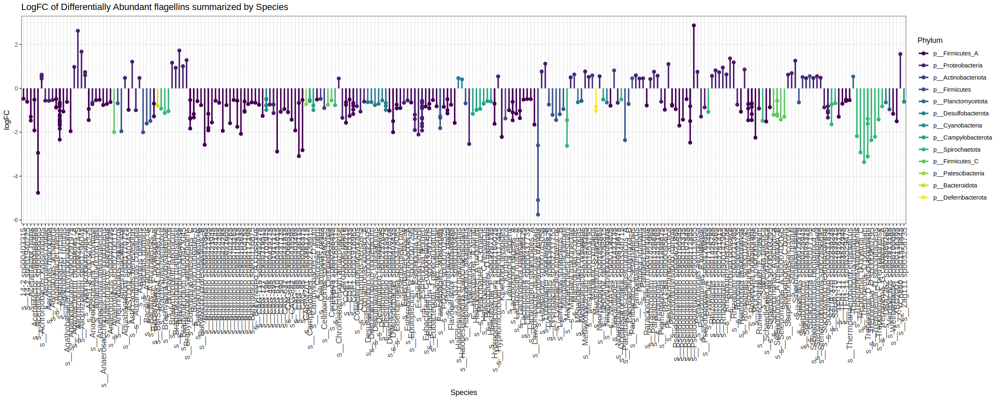

In [326]:
options(repr.plot.width=20,repr.plot.height=8)
ggplot(sigtabgen.host.filt.nonrare, aes(x = Species, y = logFC, color = Phylum)) + geom_point(size=2) + 
  geom_segment(aes(y=0,yend=logFC,xend=Species,xend=Species),size=1)+
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()+
  ggtitle("LogFC of Differentially Abundant flagellins summarized by Species")

#### 2. Host vs. environmental

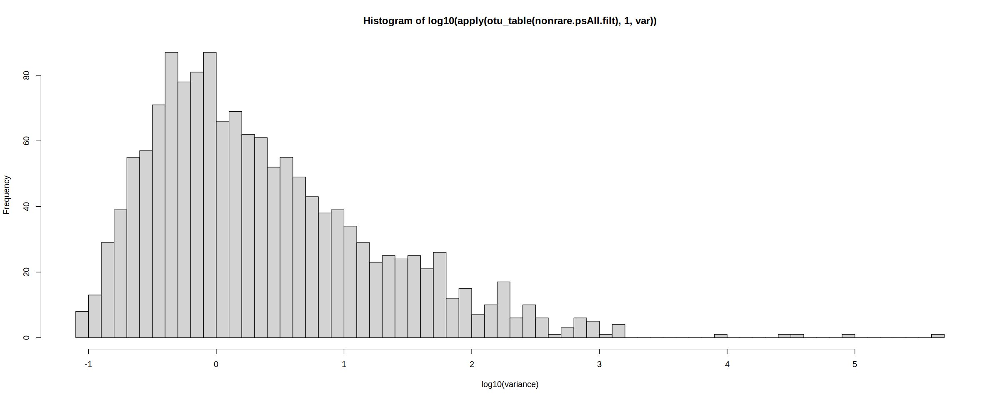

In [343]:
# #relative abundances
hist(log10(apply(otu_table(nonrare.psAll.filt), 1, var)),
     xlab="log10(variance)",breaks=50)#,
     #main="A large fraction of OTUs have very low variance")

In [366]:
varianceThreshold = 1e-5
keepOTUs.biome1 = names(which(apply(otu_table(nonrare.psAll.filt), 1, var) > varianceThreshold))
filter_taxa_biome1.nonrare.filt = prune_taxa(keepOTUs.biome1, nonrare.psAll.filt)

dge.nonrare.filt = phyloseq_to_edgeR(filter_taxa_biome1.nonrare.filt, group="biome_1")
# Perform binary test
et.nonrare.filt = exactTest(dge.nonrare.filt)
# Extract values from test results
tt.nonrare.filt = topTags(et.nonrare.filt, n=nrow(dge.nonrare.filt$table), adjust.method="BH", sort.by="PValue")
res.nonrare.filt = tt.nonrare.filt@.Data[[1]]
alpha = 0.001
sigtab.nonrare.filt = res.nonrare.filt[(res.nonrare.filt$FDR < alpha), ]
#sigtab = cbind(as(sigtab, "data.frame"), as(tax_table(rarefied.psAll.filt)[rownames(sigtab), ], "matrix"))
#dim(sigtab)

sigtab.nonrare.filt.biome1=filter(res.nonrare.filt,FDR<0.01)
head(tt.nonrare.filt)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
OUT94870.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Parvibaculales,f__RS24,g__UBA7378,s__UBA7378 sp002689195,-3.177887,11.21557,1.232088e-184,1.791457e-181
EEJ52905.1,d__Bacteria,p__Actinobacteriota,c__Actinomycetia,o__Actinomycetales,f__Actinomycetaceae,g__Mobiluncus,s__Mobiluncus mulieris,-2.710567,11.85500,8.838562e-133,6.425635e-130
KQT19785.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Beijerinckiaceae,g__Methylobacterium,s__Methylobacterium sp001423265,-2.552753,11.24146,5.214993e-129,2.527533e-126
KDR32911.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Caballeronia,s__Caballeronia zhejiangensis,-3.082992,14.06093,4.711725e-119,1.712712e-116
WP_095416232.1,d__Bacteria,p__Planctomycetota,c__Planctomycetes,o__Pirellulales,f__Thermoguttaceae,g__Thermogutta,s__Thermogutta terrifontis,-2.040943,10.85958,3.410745e-99,9.918448e-97
OAS88434.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Achromobacter,s__Achromobacter xylosoxidans,-2.245013,11.38833,1.042272e-95,2.525773e-93


In [367]:
nrow(sigtab.nonrare.filt.biome1)

[1] 817

#### Export list of Differentially Abundant flagellins

In [356]:
DA.biome1 = rownames_to_column(sigtab.nonrare.filt.biome1,var = "Accession")
write_tsv(DA.biome1,"edgeR/DA.biome1.nonrare.filt.tsv")

#### Plots

##### A. Phylum-level

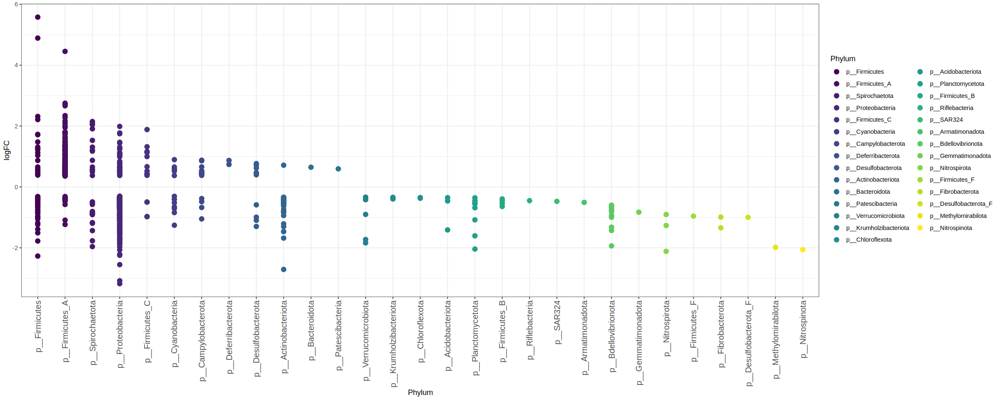

In [329]:
ggplot(sigtabgen.nonrare.filt.biome1, aes(x = Phylum, y = logFC, color = Phylum)) + geom_point(size=3) + 
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()

In [328]:
theme_set(theme_bw())
sigtabgen.nonrare.filt.biome1 = subset(sigtab.nonrare.filt.biome1, !is.na(Genus))

# Phylum order
x = tapply(sigtabgen.nonrare.filt.biome1$logFC, sigtabgen.nonrare.filt.biome1$Phylum, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.nonrare.filt.biome1$Phylum = factor(as.character(sigtabgen.nonrare.filt.biome1$Phylum), levels = names(x))

# Genus order
x = tapply(sigtabgen.nonrare.filt.biome1$logFC, sigtabgen.nonrare.filt.biome1$Genus, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.nonrare.filt.biome1$Genus = factor(as.character(sigtabgen.nonrare.filt.biome1$Genus), levels = names(x))

#### 3. Animals/Environmental

In [330]:
ps.animals.env=subset_samples(nonrare.psAll.filt,category!="Plants")
ps.animals.env

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 1454 taxa and 692 samples ]
sample_data() Sample Data:       [ 692 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 1454 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 1454 tips and 1453 internal nodes ]

In [383]:
varianceThreshold = 1e-5
keepOTUs.anim.env = names(which(apply(otu_table(ps.animals.env), 1, var) > varianceThreshold))
filter_taxa_anim.env.nonrare.filt = prune_taxa(keepOTUs.anim.env, ps.animals.env)

dge.nonrare.filt.anim.env = phyloseq_to_edgeR(filter_taxa_anim.env.nonrare.filt, group="category")
# Perform binary test
et.nonrare.filt.anim.env = exactTest(dge.nonrare.filt.anim.env)
# Extract values from test results
tt.nonrare.filt.anim.env = topTags(et.nonrare.filt.anim.env, n=nrow(dge.nonrare.filt.anim.env$table), adjust.method="BH", sort.by="PValue")
res.nonrare.filt.anim.env = tt.nonrare.filt.anim.env@.Data[[1]]
alpha = 0.001
sigtab.nonrare.filt.anim.env = res.nonrare.filt.anim.env[(res.nonrare.filt.anim.env$FDR < alpha), ]
#sigtab = cbind(as(sigtab, "data.frame"), as(tax_table(rarefied.psAll.filt)[rownames(sigtab), ], "matrix"))
#dim(sigtab)

sigtab.nonrare.filt.anim.env=filter(res.nonrare.filt.anim.env,FDR<0.01)
head(tt.nonrare.filt.anim.env)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
OUT94870.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Parvibaculales,f__RS24,g__UBA7378,s__UBA7378 sp002689195,3.232739,11.23077,3.571169e-170,5.192480e-167
KQT19785.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Beijerinckiaceae,g__Methylobacterium,s__Methylobacterium sp001423265,2.681773,11.22161,2.217910e-140,1.612420e-137
EEJ52905.1,d__Bacteria,p__Actinobacteriota,c__Actinomycetia,o__Actinomycetales,f__Actinomycetaceae,g__Mobiluncus,s__Mobiluncus mulieris,2.805084,11.85580,1.167445e-135,5.658215e-133
KDR32911.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Caballeronia,s__Caballeronia zhejiangensis,3.110978,14.10823,7.244926e-106,2.633531e-103
WP_068024403.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Xanthobacteraceae,g__Z2-YC6860,s__Z2-YC6860 sp001579845,2.550352,10.96537,1.394940e-103,4.056485e-101
OAS88434.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Achromobacter,s__Achromobacter xylosoxidans,2.344626,11.36667,7.013927e-99,1.699708e-96


In [385]:
nrow(sigtab.nonrare.filt.anim.env)

[1] 836

In [386]:
head(sigtab.nonrare.filt.anim.env)

,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
OUT94870.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Parvibaculales,f__RS24,g__UBA7378,s__UBA7378 sp002689195,3.232739,11.23077,3.571169e-170,5.192480e-167
KQT19785.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Beijerinckiaceae,g__Methylobacterium,s__Methylobacterium sp001423265,2.681773,11.22161,2.217910e-140,1.612420e-137
EEJ52905.1,d__Bacteria,p__Actinobacteriota,c__Actinomycetia,o__Actinomycetales,f__Actinomycetaceae,g__Mobiluncus,s__Mobiluncus mulieris,2.805084,11.85580,1.167445e-135,5.658215e-133
KDR32911.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Caballeronia,s__Caballeronia zhejiangensis,3.110978,14.10823,7.244926e-106,2.633531e-103
WP_068024403.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Xanthobacteraceae,g__Z2-YC6860,s__Z2-YC6860 sp001579845,2.550352,10.96537,1.394940e-103,4.056485e-101
OAS88434.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Achromobacter,s__Achromobacter xylosoxidans,2.344626,11.36667,7.013927e-99,1.699708e-96


#### Export list of Differentially Abundant flagellins

In [360]:
DA.animals.env = rownames_to_column(sigtab.nonrare.filt.anim.env,var = "Accession")
write_tsv(DA.animals.env,"edgeR/DA.animals.env.nonrare.filt.tsv")

In [341]:
theme_set(theme_bw())
sigtabgen.nonrare.filt.anim.env = subset(sigtab.nonrare.filt.anim.env, !is.na(Genus))

# Phylum order
x = tapply(sigtabgen.nonrare.filt.anim.env$logFC, sigtabgen.nonrare.filt.anim.env$Phylum, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.nonrare.filt.anim.env$Phylum = factor(as.character(sigtabgen.nonrare.filt.anim.env$Phylum), levels = names(x))

# Genus order
x = tapply(sigtabgen.nonrare.filt.anim.env$logFC, sigtabgen.nonrare.filt.anim.env$Genus, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.nonrare.filt.anim.env$Genus = factor(as.character(sigtabgen.nonrare.filt.anim.env$Genus), levels = names(x))

#### Plots

##### A. Phylum-level

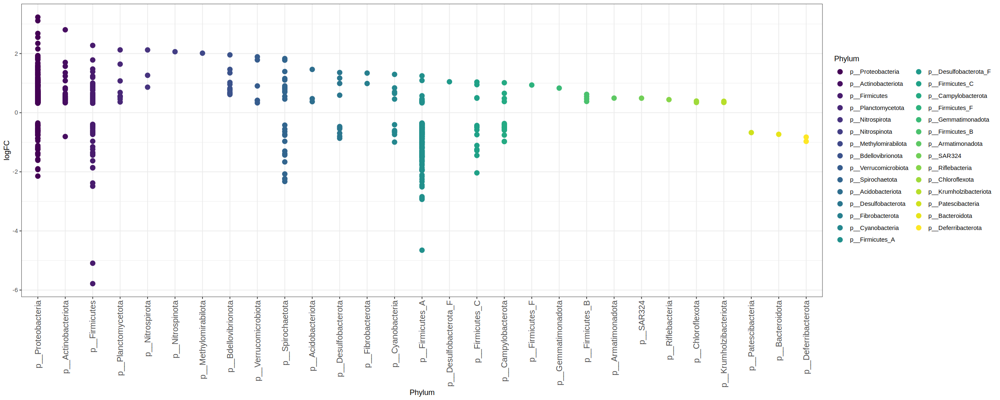

In [342]:
ggplot(sigtabgen.nonrare.filt.anim.env, aes(x = Phylum, y = logFC, color = Phylum)) + geom_point(size=3) + 
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()

#### Plants/Environmental

In [374]:
ps.plants.env=subset_samples(nonrare.psAll.filt,category!="Animal")
ps.plants.env

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 1454 taxa and 220 samples ]
sample_data() Sample Data:       [ 220 samples by 10 sample variables ]
tax_table()   Taxonomy Table:    [ 1454 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 1454 tips and 1453 internal nodes ]

In [375]:
varianceThreshold = 1e-5
keepOTUs.plants.env = names(which(apply(otu_table(ps.plants.env), 1, var) > varianceThreshold))
filter_taxa_plant.env.nonrare.filt = prune_taxa(keepOTUs.plants.env, ps.plants.env)

dge.nonrare.filt.plant.env = phyloseq_to_edgeR(filter_taxa_plant.env.nonrare.filt, group="category")
# Perform binary test
et.nonrare.filt.plant.env = exactTest(dge.nonrare.filt.plant.env)
# Extract values from test results
tt.nonrare.filt.plant.env = topTags(et.nonrare.filt.plant.env, n=nrow(dge.nonrare.filt.plant.env$table), adjust.method="BH", sort.by="PValue")
res.nonrare.filt.plant.env = tt.nonrare.filt.plant.env@.Data[[1]]
alpha = 0.001
sigtab.nonrare.filt.plant.env = res.nonrare.filt.plant.env[(res.nonrare.filt.plant.env$FDR < alpha), ]
#sigtab = cbind(as(sigtab, "data.frame"), as(tax_table(rarefied.psAll.filt)[rownames(sigtab), ], "matrix"))
#dim(sigtab)

sigtab.nonrare.filt.plant.env=filter(res.nonrare.filt.plant.env,FDR<0.01)

Found more than one class "phylo" in cache; using the first, from namespace 'phyloseq'

Also defined by ‘RNeXML’



In [376]:
head(tt.nonrare.filt.plant.env)

,Domain,Phylum,Class,Order,Family,Genus,Species,logFC,logCPM,PValue,FDR
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
SFH83235.1,d__Bacteria,p__Firmicutes_A,c__Clostridia,o__Lachnospirales,f__Lachnospiraceae,g__Pseudobutyrivibrio,s__Pseudobutyrivibrio sp900113655,2.915643,11.50974,1.655864e-40,2.351327e-37
KDR32911.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Burkholderiales,f__Burkholderiaceae,g__Caballeronia,s__Caballeronia zhejiangensis,-2.862100,15.32115,4.219625e-37,2.995934e-34
EEO87047.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Enterobacterales,f__Enterobacteriaceae,g__Yersinia,s__Yersinia pestis,-2.170430,11.87717,3.493735e-27,1.653701e-24
EHS53753.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Rhizobiales,f__Rhizobiaceae,g__Allorhizobium,s__Allorhizobium sp000247475,2.283410,11.50523,1.832258e-26,6.504516e-24
OUT94870.1,d__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Parvibaculales,f__RS24,g__UBA7378,s__UBA7378 sp002689195,-2.793694,12.18788,6.611969e-23,1.877799e-20
WP_043131923.1,d__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Enterobacterales,f__Aeromonadaceae,g__Aeromonas,s__Aeromonas caviae,-2.003482,11.82907,1.320598e-22,3.125416e-20


In [377]:
nrow(sigtab.nonrare.filt.plant.env)

[1] 277

#### Export list of Differentially Abundant flagellins

In [378]:
DA.plants.env = rownames_to_column(sigtab.nonrare.filt.plant.env,var = "Accession")
write_tsv(DA.plants.env,"edgeR/DA.plants.env.nonrare.filt.tsv")

#### Plots

In [339]:
theme_set(theme_bw())
sigtabgen.nonrare.filt.plant.env = subset(sigtab.nonrare.filt.plant.env, !is.na(Genus))

# Phylum order
x = tapply(sigtabgen.nonrare.filt.plant.env$logFC, sigtabgen.nonrare.filt.plant.env$Phylum, function(x) max(x))
x = sort(x, TRUE)
           
sigtabgen.nonrare.filt.plant.env$Phylum = factor(as.character(sigtabgen.nonrare.filt.plant.env$Phylum), levels = names(x))

# Genus order
x = tapply(sigtabgen.nonrare.filt.plant.env$logFC, sigtabgen.nonrare.filt.plant.env$Genus, function(x) max(x))
x = sort(x, TRUE)
sigtabgen.nonrare.filt.plant.env$Genus = factor(as.character(sigtabgen.nonrare.filt.plant.env$Genus), levels = names(x))

##### A. Phylum-level

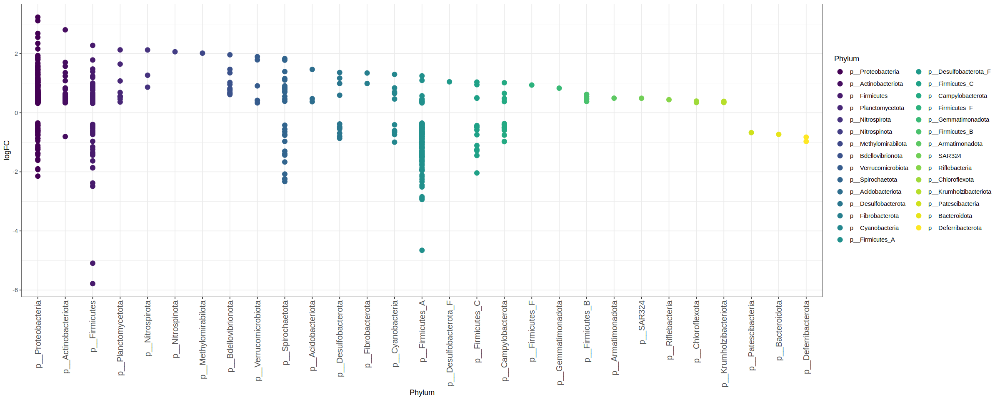

In [340]:
ggplot(sigtabgen.nonrare.filt.plant.env, aes(x = Phylum, y = logFC, color = Phylum)) + geom_point(size=3) + 
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size=12))+
  scale_color_viridis_d()